# **Table of Contents** <br>

### [0.Supporting Functions](#supporting_functions)
### [1.Analyzing initial dataset](#analyzing_initial_dataset)
### [2.Individual feature analyzis](#individual_feature_analyzis)
### [3. Analyzing nan values](#analyzing_nan_values)
### [4. Analyzing outliers](#analyzing_outliers)
### [5. Feature engineering](#feature_engineering)
### [6. Multivariate analyzis](#multivariate_analyzis)
    

<div class="alert alert-block alert-info" style="font-size:16px" id = "supporting_functions">

# 0. Supporting functions 


In [237]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import chi2
import math
import os
import scipy.stats as ss
import warnings

import copy 
import numpy as np
import pandas as pd
import seaborn as sns
import scipy as sp
from scipy.stats import chi2
from sklearn.covariance import MinCovDet
import scipy
import itertools
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import mpl_axes_aligner

In [238]:
def outlier_detection(df, features):
    if isinstance(features, str):
        features = [features]

    for feature in features:
        q3 = df[feature].quantile(0.75)
        q1 = df[feature].quantile(0.25)
        max = df[feature].max()
        min = df[feature].min()
        iqr = q3 - q1  # Interquartile Range

        mod_outl = df.loc[(df[feature] > (q3 + 1.5 * iqr)) | (df[feature] < (q1 - 1.5 * iqr))].shape[0]
        ext_outl = df.loc[(df[feature] > (q3 + 3 * iqr)) | (df[feature] < (q1 - 3 * iqr))].shape[0]
        total_outl = mod_outl + ext_outl
        if mod_outl != 0 and ext_outl!= 0:
            mod_outl_perc = int((mod_outl/total_outl)*100)
            ext_outl_perc = int((ext_outl/total_outl)*100)
        else:
            mod_outl_perc = ''
            ext_outl_perc = ''


        print(f"{feature}: \nNumber of extreme outliers: {ext_outl} ({ext_outl_perc}%) \nNumber of moderate outliers: {mod_outl} ({mod_outl_perc}%) \nTotal number of outliers: {total_outl}")
        print(f"Q3 + 1.5*IQR = {q1 + 1.5* iqr} \nQ3 + 3*IQR = {q1 + 3* iqr}\nMax: {max} \nMin: {min} \n")



def cor_heatmap(cor):
    mask = np.triu(np.ones_like(cor, dtype=bool))  # Mask for the upper triangle
    plt.figure(figsize=(40, 30))
    sns.heatmap(data=cor, annot=True, cmap=plt.cm.Reds, fmt='.2f', mask=mask, linewidths=0.5)
    plt.show()




#function to produce biplot
def biplot(dfScores: pd.DataFrame, dfLoadings: pd.DataFrame) -> None:
    
    #create figure and axis objects
    fig,ax = plt.subplots(figsize=(15,8))
    
    #make a scores plot
    ax.scatter(dfScores.PC1.values,dfScores.PC2.values, color='b')
    #set x-axis label
    ax.set_xlabel("PC1",fontsize=10)
    #set y-axis label
    ax.set_ylabel("PC2",fontsize=10)
    
    #create a second set of axes
    ax2 = ax.twinx().twiny()
    
    #setup font dictionary
    font = {'color':  'g',
            'weight': 'bold',
            'size': 12,
            }
    
    #make a loadings plot
    for col in dfLoadings.columns.values:
        #where do our loading vectors end?
        tipx = dfLoadings.loc['PC1',col]
        tipy = dfLoadings.loc['PC2',col]
        #draw the vector, and write label text for col
        ax2.arrow(0, 0, tipx, tipy, color = 'r', alpha = 0.5)
        ax2.text(tipx*1.05, tipy*1.05, col, fontdict = font, ha = 'center', va = 'center')
    
    #align x = 0 of ax and ax2 with the center of figure
    mpl_axes_aligner.align.xaxes(ax, 0, ax2, 0, 0.5)
    #align y = 0 of ax and ax2 with the center of figure
    mpl_axes_aligner.align.yaxes(ax, 0, ax2, 0, 0.5)
    
    #show plot
    plt.show()

<hr>
<div class="alert alert-block alert-info" style="font-size:16px" id="analyzing_initial_dataset">
    
# 1. Analyzing initial dataset
    
</a>

In [239]:
df = pd.read_csv("DM2425_ABCDEats_DATASET.csv")

In [240]:
df.head()

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
0,1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,...,0,0,0,0,2,0,0,0,0,0
1,5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0
2,f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,0
3,180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,0,0
4,4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,...,0,0,0,0,0,0,0,0,0,0


In [241]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31888 entries, 0 to 31887
Data columns (total 56 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   customer_id               31888 non-null  object 
 1   customer_region           31888 non-null  object 
 2   customer_age              31161 non-null  float64
 3   vendor_count              31888 non-null  int64  
 4   product_count             31888 non-null  int64  
 5   is_chain                  31888 non-null  int64  
 6   first_order               31782 non-null  float64
 7   last_order                31888 non-null  int64  
 8   last_promo                31888 non-null  object 
 9   payment_method            31888 non-null  object 
 10  CUI_American              31888 non-null  float64
 11  CUI_Asian                 31888 non-null  float64
 12  CUI_Beverages             31888 non-null  float64
 13  CUI_Cafe                  31888 non-null  float64
 14  CUI_Ch

In [242]:
df.shape[0]

31888

In [243]:
df.describe(include=[np.number], percentiles=np.arange(0.1,1,0.1))

,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
count,31161.000000,31888.000000,31888.000000,31888.000000,31782.000000,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000,...,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000,31888.000000
mean,27.506499,3.102609,5.668245,2.818866,28.478604,63.675521,4.880438,9.960451,2.300633,0.801163,...,0.215630,0.277032,0.356435,0.390962,0.336961,0.245610,0.142812,0.071155,0.048263,0.045189
std,7.160898,2.771587,6.957287,3.977529,24.109086,23.226123,11.654018,23.564351,8.479734,6.427132,...,0.599006,0.738162,0.874449,0.943721,0.893949,0.795296,0.586529,0.348536,0.298265,0.282006
min,15.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,20.000000,1.000000,1.000000,0.000000,2.000000,27.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
20%,22.000000,1.000000,2.000000,1.000000,6.000000,42.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
30%,23.000000,2.000000,2.000000,1.000000,10.000000,55.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
40%,25.000000,2.000000,3.000000,1.000000,16.000000,64.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,26.000000,2.000000,3.000000,2.000000,22.000000,70.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
60%,28.000000,3.000000,4.000000,2.000000,30.000000,76.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [244]:
"""Set customer_id index as the index """
df.set_index('customer_id', inplace=True)

In [245]:
"""Dropping duplicated values"""
df.drop_duplicates(inplace=True)

In [246]:
"""Checking number of NA Values"""
df.isna().sum()

customer_region                0
customer_age                 727
vendor_count                   0
product_count                  0
is_chain                       0
first_order                  106
last_order                     0
last_promo                     0
payment_method                 0
CUI_American                   0
CUI_Asian                      0
CUI_Beverages                  0
CUI_Cafe                       0
CUI_Chicken Dishes             0
CUI_Chinese                    0
CUI_Desserts                   0
CUI_Healthy                    0
CUI_Indian                     0
CUI_Italian                    0
CUI_Japanese                   0
CUI_Noodle Dishes              0
CUI_OTHER                      0
CUI_Street Food / Snacks       0
CUI_Thai                       0
DOW_0                          0
DOW_1                          0
DOW_2                          0
DOW_3                          0
DOW_4                          0
DOW_5                          0
DOW_6     

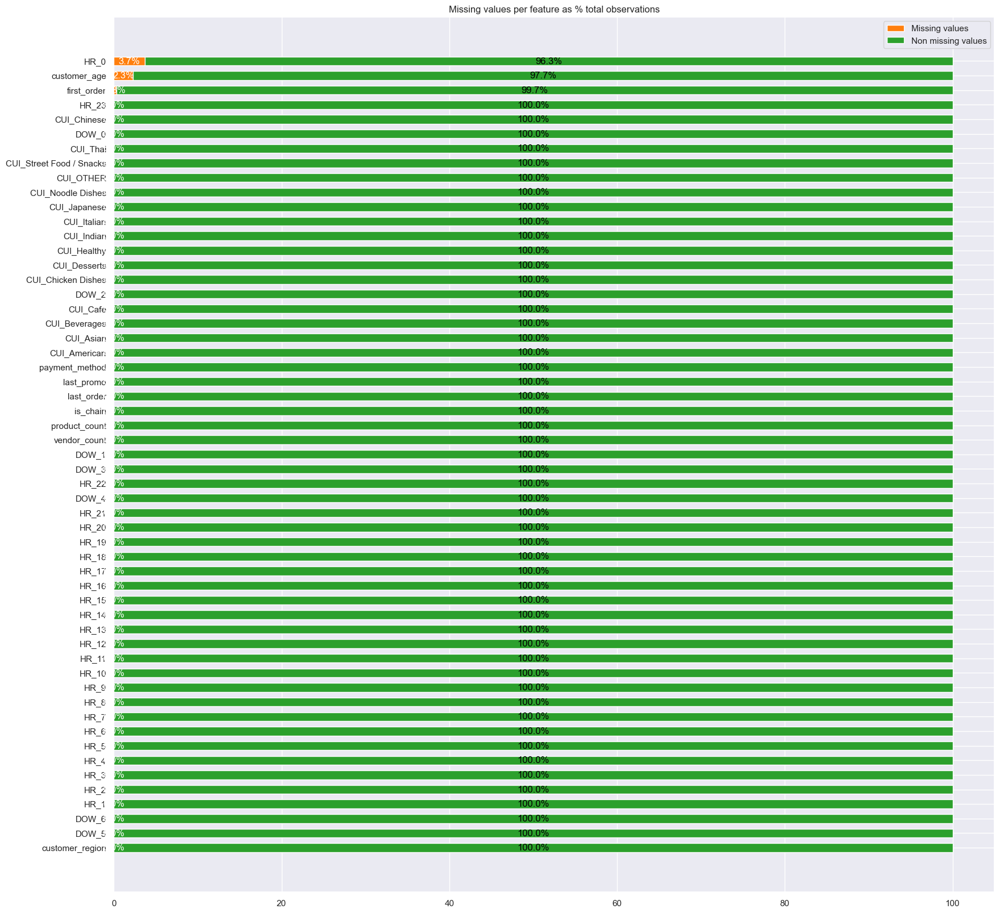

In [247]:
"""NaN values for each column as % total obervations"""
percentage_missing = round((df.isnull().sum() / df.shape[0])*100,1)
percentage_missing.sort_values(ascending=True, inplace= True)

percentage_missing_df = pd.DataFrame({"missing_values_(%)": percentage_missing})
percentage_missing_df["present_values_(%)"] = abs(percentage_missing_df["missing_values_(%)"] - 100)
percentage_present = percentage_missing_df["present_values_(%)"]
column_names = list(percentage_missing.index)

fig,ax = plt.subplots (figsize = (20,20))
p1 = ax.barh(y=column_names, width=percentage_missing, height= 0.6, color="tab:orange", label="Missing values")
p2 = ax.barh(y=column_names, width=percentage_present, height= 0.6, color="tab:green", left=percentage_missing, label= "Non missing values")
ax.bar_label(p1, labels= [str(element) + "%" for element in percentage_missing], color="white", label_type="center")
ax.bar_label(p2, labels= [str(element) + "%" for element in percentage_present], color="black", label_type="center")
ax.legend()
ax.set_title("Missing values per feature as % total observations")
plt.show()


<div class="alert alert-block alert-info" style="font-size:16px" id= "individual_feature_analyzis">

## 2. Individual feature analysis

### **`First_order`**

In [248]:
"""Understanding the feature"""
df["first_order"].info()

<class 'pandas.core.series.Series'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Series name: first_order
Non-Null Count  Dtype  
--------------  -----  
31722 non-null  float64
dtypes: float64(1)
memory usage: 497.3+ KB


In [249]:
"""Undestanding the statistical properties"""
df["first_order"].describe(percentiles= np.arange(0.1,1,0.05))

count    31722.000000
mean        28.462329
std         24.101334
min          0.000000
10%          2.000000
15%          4.000000
20%          6.000000
25%          7.000000
30%         10.000000
35%         13.000000
40%         16.000000
45%         19.000000
50%         22.000000
50%         22.000000
55%         26.000000
60%         30.000000
65%         34.000000
70%         39.000000
75%         45.000000
80%         51.000000
85%         58.000000
90%         67.000000
95%         77.000000
max         90.000000
Name: first_order, dtype: float64

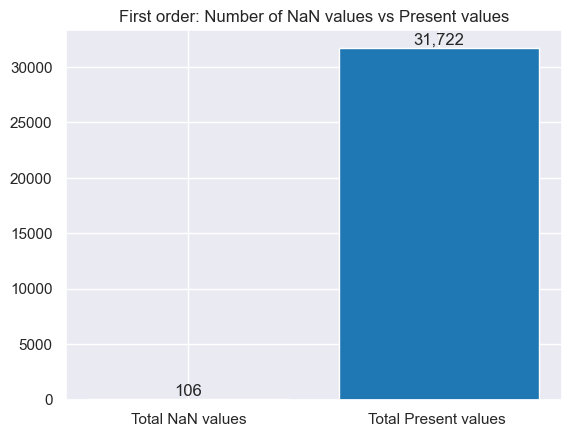

In [250]:
"""Number of NaN values vs Non missing values"""
total_elements = len(df["first_order"])
fo_perc_na_values = df["first_order"].isna().sum()
fo_per_present_values = total_elements- fo_perc_na_values

fig, ax = plt.subplots()
x_values = ["Total NaN values", "Total Present values "]
bar_colours = ["tab:green", "tab:blue"]

y_values = [fo_perc_na_values, fo_per_present_values]
p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element:,}" for element in y_values])
ax.set_title("First order: Number of NaN values vs Present values")

plt.show()


In [24]:
"""Attempting to understand the NaN values better"""
total_fo_nan_values = df.loc[df["first_order"].isnull()].shape[0]
lo_0_fo_nan_values = df.loc[ (df["first_order"].isnull()) & (df["last_order"] == 0) & (df["product_count"] > 0)].shape[0]

if total_fo_nan_values == lo_0_fo_nan_values:
    print("All the NaN values for 'first_order', correspond to clients who made their 'last_order' in the 1st day of the 1st month and have a total of product count bigger than 0")

All the NaN values for 'first_order', correspond to clients who made their 'last_order' in the 1st day of the 1st month and have a total of product count bigger than 0


All the NaN values for 'first_order', correspond to clients who made their 'last_order' in the 1st day of the 1st month and have a total of product count bigger than 0


In [25]:
"""Identifying possible hidden NaN values """
df["first_order"].unique()

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35., 36., 37., 38.,
       39., 40., 41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51.,
       52., 53., 54., 55., 56., 57., 58., 59., 60., 61., 62., 63., 64.,
       65., 66., 67., 68., 69., 70., 71., 72., 73., 74., 75., 76., 77.,
       78., 79., 80., 81., 82., 83., 84., 85., 86., 87., 88., 89., 90.,
       nan])

In [26]:
"""Changing dtype """
df["first_order"] = df["first_order"].astype("Int64")



<img src="Freedman–Diaconis_rule.png" style="width:300px">

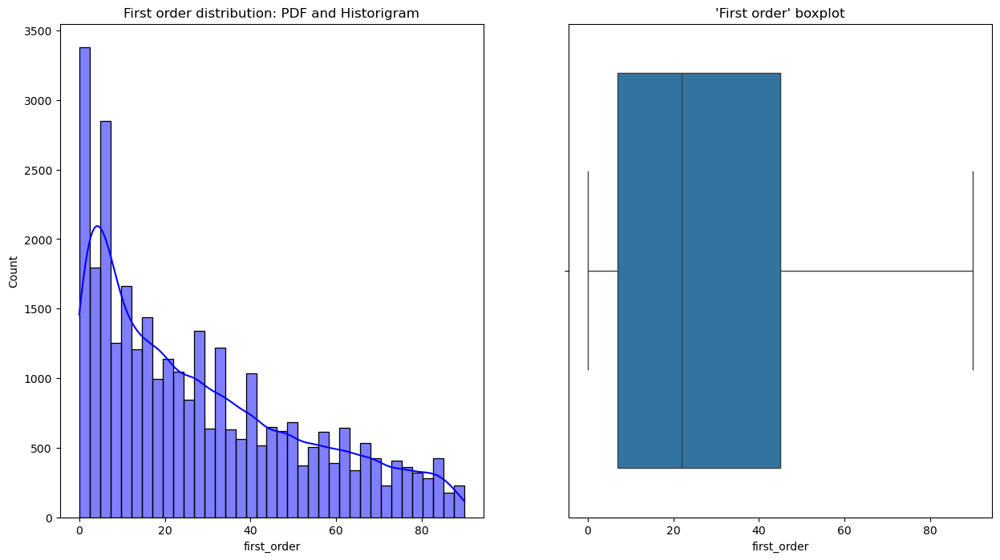

In [27]:
"""Histogram and boxplot using the Freedman - Diaconis rule mentioned above"""

#For ploting purposes, we removed the NaN values
df_fo_without_na = df["first_order"].dropna()

Q1,Q3 = np.nanpercentile(df_fo_without_na, [25, 75])
IQR = Q3-Q1
fd_bin_width = (2*IQR)/len(df_fo_without_na)**(1/3)
df_optimal_num_bins = int((max(df_fo_without_na)-min(df_fo_without_na))/fd_bin_width)

fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_fo_without_na, kde=True, color="blue", bins=df_optimal_num_bins, ax=axes[0])
axes[0].set_title("First order distribution: PDF and Historigram")

sns.boxplot(x = df_fo_without_na, ax=axes[1])
axes[1].set_title("'First order' boxplot")
plt.show()

#### <u> Conclusions </u>
#### Based on the historigram and boxplot, we can conclude the following regarding the first order:

- No traditional outliers
- The distribution is positive skewed, meaning that clients tend to make their first order in the first month
- 60% of clients made their first order in the first month and 75% after one month and half
- Only 10% of clients took longer than 67 days to make their first order

#### Based on the analyzis, the following questions were raised:
1. Analyzing inactive/active users
    - From the 60% of clients that made their first order before the end of first month, how many became inactive and active users in the 2 months that followed?
        -How to determine inactive users do this: For the customers who made their first order before the end of first month, check how many have the first_order value equal to the last_order value 
    - From the clients 40% of clients that made their first order after 1 month, how many became inactive or active users in the 2 months that followed?

In [28]:
"""Analyze num of outliers"""
outlier_detection(df, ["first_order"])

first_order: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 0 (%) 
Total number of outliers: 0
Q3 + 1.5*IQR = 64.0 
Q3 + 3*IQR = 121
Max: 90 
Min: 0 



[Text(0, 0, '61.0%'), Text(0, 0, '26.0%'), Text(0, 0, '14.0%')]

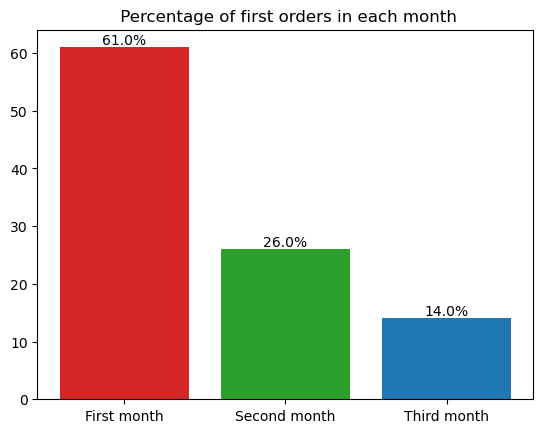

In [29]:
"""
Analyzing the % of clients who made their first order in each month
"""
total_fo = int(df["first_order"].count())
first_month_fo = int(df["first_order"].loc[df["first_order"] <= 30].count())
second_month_fo = int(df["first_order"].loc[(df["first_order"] > 30) & (df["first_order"] <= 60)].count())
third_month_fo = int(df["first_order"].loc[(df["first_order"] > 60) & (df["first_order"] <= 90)].count())
y_values = [first_month_fo, second_month_fo, third_month_fo]
#Change to percentage values. Didn't do it above to avoid making the code too long
for i in range(len(y_values)):
    y_values[i] = round((y_values[i]/total_fo)*100, 0)

"""
1. Note that the meaning of the parameter label is different in ax.bar() and ax.bar_label()
1.1 In ax.bar(), it helps us define the different names going to be used in the 'legend' (rigth end corner)
2. ax.bar_label()
2.1 Helps us define the values that appear at the top of each bar
2.2 For it to work, we need to save ax.bar() in a variable
"""
x_values = ["First month", "Second month", "Third month"]
fig, ax = plt.subplots(nrows=1, ncols=1)
bar_color = ["tab:red", "tab:green", "tab:blue"]
bar_label_values = ax.bar(x_values, y_values, color = bar_color)
ax.set_title(" Percentage of first orders in each month")
ax.bar_label(bar_label_values, labels= [str(element) + "%" for element in y_values])



#### <u> Conclusions: </u>
1. We can clearly see the dominance of the first month, represeting the month where 61% of total first orders were made by the customers
2. From the first to the second month, there is a reduction of 35p.p and from the first to the third a reduction of 47p.p 
3. Combined, the second and third month only represent around 66% of the total representation of the first month

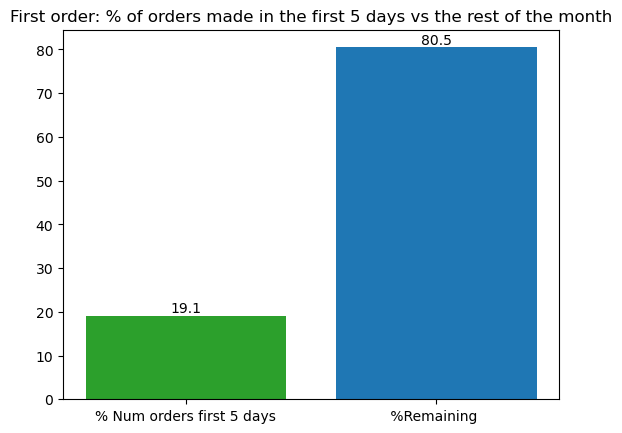

In [30]:
"""Analyzing the % of orders made in the first 5 days vs the rest of the month"""

total_elements = len(df["first_order"])
fo_5_days = round((df["first_order"].loc[df["first_order"] <= 5].count()/total_elements)*100,1)
fo_remaining = round((df["first_order"].loc[df["first_order"] >5].count()/total_elements)*100,1)

fig, ax = plt.subplots()
x_values = ["% Num orders first 5 days", " %Remaining  "]
bar_colours = ["tab:green", "tab:blue"]

y_values = [fo_5_days, fo_remaining]
p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element:,}" for element in y_values])
ax.set_title("First order: % of orders made in the first 5 days vs the rest of the month")
plt.show()

### Key Notes on first order
- Represents a discrete numerical variable (values between 0 and 90)
- No traditional outliers
- Despite low number of NaN values (106), they are quite interesting. Don't think they are NaN for lack of infromation but due to error. My suggestion: Input the hidden NaN values with a 0. 
- No hidden NaN values
- Changed data format from float64 to int64


---

### **`Last_order`**

In [31]:
"""Understanding the feature"""
df["last_order"].info()

<class 'pandas.core.series.Series'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Series name: last_order
Non-Null Count  Dtype
--------------  -----
31828 non-null  int64
dtypes: int64(1)
memory usage: 1.5+ MB


In [32]:
"""Undestanding the statistical properties"""
df["last_order"].describe(percentiles= np.arange(0.1,1,0.05))

count    31828.00000
mean        63.66674
std         23.23167
min          0.00000
10%         27.00000
15%         35.00000
20%         42.00000
25%         49.00000
30%         55.00000
35%         60.00000
40%         64.00000
45%         68.00000
50%         70.00000
50%         70.00000
55%         74.00000
60%         76.00000
65%         79.00000
70%         81.00000
75%         83.00000
80%         84.00000
85%         86.00000
90%         87.00000
95%         89.00000
max         90.00000
Name: last_order, dtype: float64

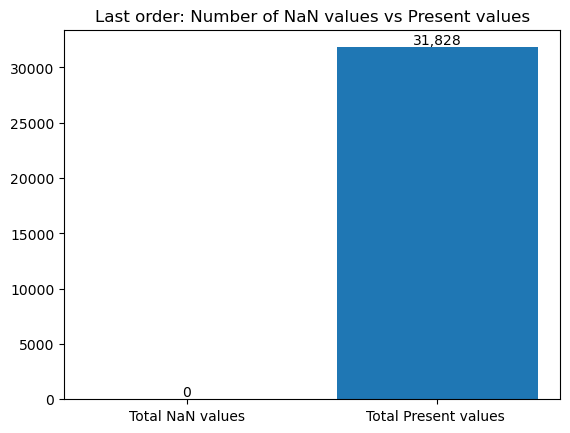

In [33]:
"""Number of NaN values vs Non missing values"""
total_elements = len(df["last_order"])
fo_perc_na_values = df["last_order"].isna().sum()
fo_per_present_values = total_elements- fo_perc_na_values

fig, ax = plt.subplots()
x_values = ["Total NaN values", "Total Present values "]
bar_colours = ["tab:green", "tab:blue"]

y_values = [fo_perc_na_values, fo_per_present_values]
p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element:,}" for element in y_values])
ax.set_title("Last order: Number of NaN values vs Present values")

plt.show()


In [34]:
"""Attempting to understand the NaN values better"""
# NO NaN values

'Attempting to understand the NaN values better'

In [35]:
"""Identifying possible hidden NaN values """
df["last_order"].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36,
       37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
       54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70,
       71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87,
       88, 89, 90,  9, 15,  0])

In [36]:
"""Changing dtype """
df["last_order"] = df["last_order"].astype("Int64")



<img src="Freedman–Diaconis_rule.png" style="width:300px">

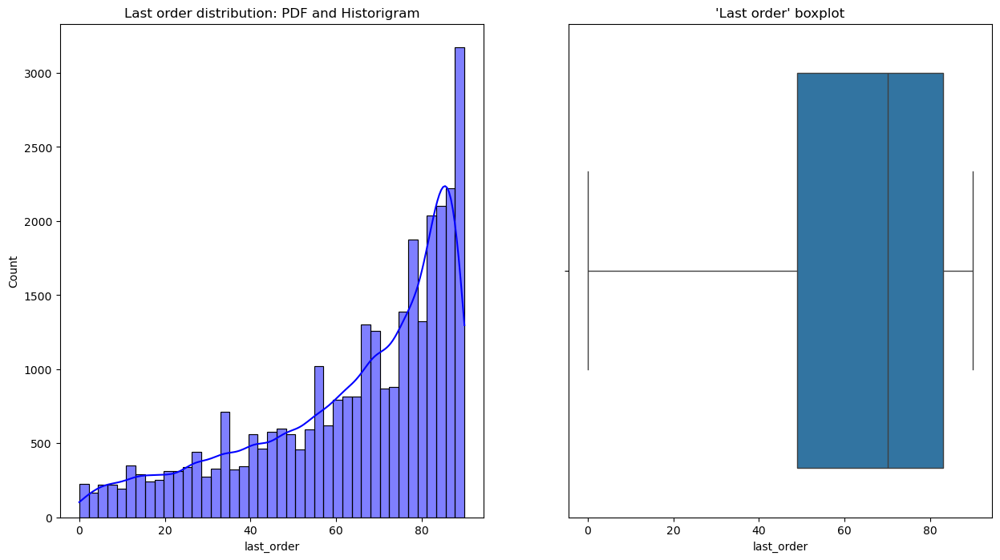

In [37]:
"""Histogram and boxplot using the Freedman - Diaconis rule mentioned above"""
Q1,Q3 = np.nanpercentile(df["last_order"], [25, 75])
IQR = Q3-Q1
fd_bin_width = (2*IQR)/len(df["last_order"])**(1/3)
df_optimal_num_bins = int((max(df["last_order"])-min(df["last_order"]))/fd_bin_width)

fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df["last_order"], kde=True, color="blue", bins=df_optimal_num_bins, ax=axes[0])
axes[0].set_title("Last order distribution: PDF and Historigram")

sns.boxplot(x = df["last_order"], ax=axes[1])
axes[1].set_title("'Last order' boxplot")
plt.show()

In [38]:
"""Analyze num of outliers"""
outlier_detection(df, ["last_order"])

last_order: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 0 (%) 
Total number of outliers: 0
Q3 + 1.5*IQR = 100.0 
Q3 + 3*IQR = 151.0
Max: 90 
Min: 0 



#### <u> Conclusions </u>
#### - Based on the historigram and boxplot, we can conclude the following regarding the last order:

1. Visual confirmation that variable follows a left skewed distribution, meaning that clients tend to make their last order laster in time with 50%
    making it close to the middle of the last month (last 20 days of the third month)
2. There seems to be no outlier presence in the last_order variable, despite not being normally distributed and being havily skewed to the left
3. Around 65% of clients made their last order in the last month and 35% made their last order in the first 2 months


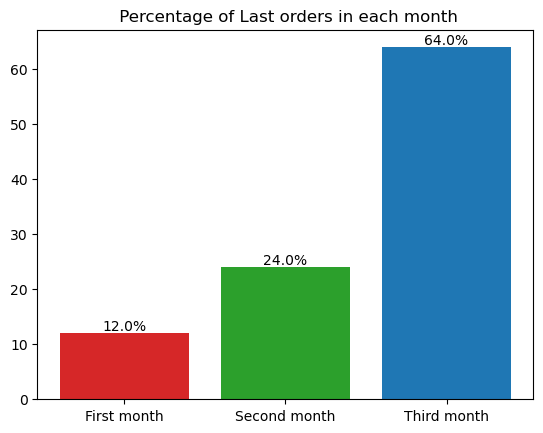

In [39]:
"""
Analyzing the % of clients who made their last order in each month
"""
total_fo = int(df["last_order"].count())
first_month_fo = int(df["last_order"].loc[df["last_order"] <= 30].count())
second_month_fo = int(df["last_order"].loc[(df["last_order"] > 30) & (df["last_order"] <= 60)].count())
third_month_fo = int(df["last_order"].loc[(df["last_order"] > 60) & (df["last_order"] <= 90)].count())
y_values = [first_month_fo, second_month_fo, third_month_fo]

#Change to percentage values. Didn't do it above to avoid making the code too long
for i in range(len(y_values)):
    y_values[i] = round((y_values[i]/total_fo)*100, 0)

"""
1. Note that the meaning of the parameter label is different in ax.bar() and ax.bar_label()
1.1 In ax.bar(), it helps us define the different names going to be used in the 'legend' (rigth end corner)
2. ax.bar_label()
2.1 Helps us define the values that appear at the top of each bar
2.2 For it to work, we need to save ax.bar() in a variable
"""
x_values = ["First month", "Second month", "Third month"]
fig, ax = plt.subplots(nrows=1, ncols=1)
bar_color = ["tab:red", "tab:green", "tab:blue"]
bar_label_values = ax.bar(x_values, y_values, color = bar_color)
ax.set_title(" Percentage of Last orders in each month")
ax.bar_label(bar_label_values, labels= [str(element) + "%" for element in y_values])

plt.show()

### Key Notes on last order
- Represents a discrete numerical variable (values between 0 and 90)
- No traditional outliers
- No NaN values, No hidden NaN values
- Changed data format from float64 to int64


---

### **`Last_promo`**

In [40]:
"""Understanding the feature"""
df["last_promo"].info()

<class 'pandas.core.series.Series'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Series name: last_promo
Non-Null Count  Dtype 
--------------  ----- 
31828 non-null  object
dtypes: object(1)
memory usage: 1.5+ MB


In [41]:
"""Undestanding the statistical properties"""
df["last_promo"].describe(percentiles= np.arange(0.1,1,0.05))

count     31828
unique        4
top           -
freq      16722
Name: last_promo, dtype: object

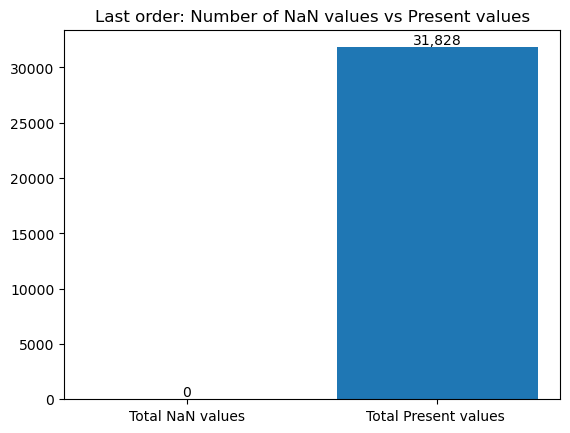

In [42]:
"""Number of NaN values vs Non missing values"""
total_elements = len(df["last_promo"])
lp_perc_na_values = df["last_promo"].isna().sum()
lp_per_present_values = total_elements- fo_perc_na_values

fig, ax = plt.subplots()
x_values = ["Total NaN values", "Total Present values "]
bar_colours = ["tab:green", "tab:blue"]

y_values = [lp_perc_na_values, lp_per_present_values]
p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element:,}" for element in y_values])
ax.set_title("Last order: Number of NaN values vs Present values")

plt.show()


In [43]:
"""Attempting to understand the NaN values better"""
# NO NaN values

'Attempting to understand the NaN values better'

In [44]:
"""Identifying possible hidden NaN values """
df["last_promo"].unique()

#Feature seems to have a strange value - '-'

array(['DELIVERY', 'DISCOUNT', '-', 'FREEBIE'], dtype=object)

[Text(0, 0, '52%'), Text(0, 0, '47%')]

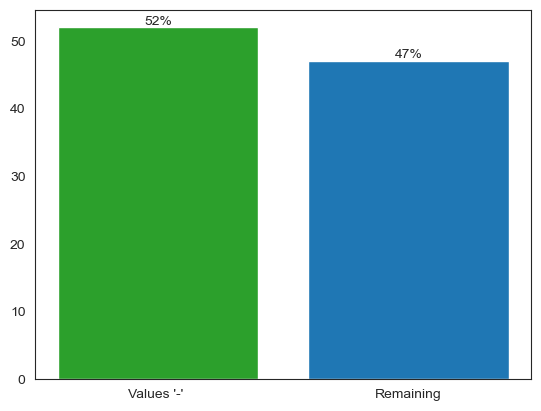

In [45]:
"""Let's analyze the existing number of strange values ''"""
sns.set_style("white")


last_promo_strange_values = int(df["last_promo"].loc[df["last_promo"] == '-'].count() )
last_promo_remaining_values = int(df["last_promo"].loc[df["last_promo"] != '-'].count() )
total_values = df["last_promo"].count()
fig, ax = plt.subplots()
x_values = ["Values '-' ", "Remaining"]
bar_colours = ["tab:green", "tab:blue"]
y_values = [int((last_promo_strange_values/total_values)*100), int((last_promo_remaining_values/total_values)*100)]
p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [str(element) + "%" for element in y_values])

####  <u> Conclusions </u>
1. More than 50% of clients have the value '-' for the 'last_promo' feature 
2. Since the percentage of clients who have value '-' is very high, we will consider it not as NaN but has an indicator that no promotion code was used 

In [46]:
"""Feature Preprocessing - Replacing '-' with 'NO PROMO USED' """

df.loc[df["last_promo"] == '-', "last_promo"] = 'NO PROMO USED'
df["last_promo"].unique()

array(['DELIVERY', 'DISCOUNT', 'NO PROMO USED', 'FREEBIE'], dtype=object)

In [47]:
"""Checking the statistical properties after the change"""

df["last_promo"].describe()

count             31828
unique                4
top       NO PROMO USED
freq              16722
Name: last_promo, dtype: object

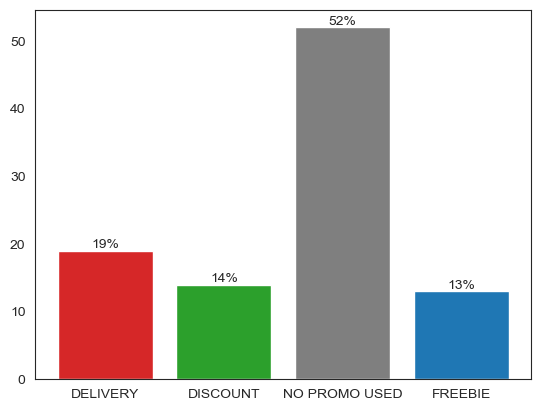

In [48]:
"""Bar plot"""
x_values = list(df["last_promo"].unique())
delivery_promo = df["last_promo"].loc[df["last_promo"] == "DELIVERY"].count()
discount_promo = df["last_promo"].loc[df["last_promo"] ==  "DISCOUNT"].count()
no_promo_used = df["last_promo"].loc[df["last_promo"] ==  "NO PROMO USED"].count()
freebie_promo = df["last_promo"].loc[df["last_promo"] ==  "FREEBIE"].count()
total_elements = df["last_promo"].count()
y_values = [int((element/total_elements)*100) for element in [delivery_promo, discount_promo, no_promo_used, freebie_promo]]

fig, ax = plt.subplots()
bar_color = ["tab:red", "tab:green", "tab:grey", "tab:blue"]
p = ax.bar(x_values, y_values, color= bar_color)
ax.bar_label(p, labels= [str(element) + "%" for element in y_values])

plt.show()

#### <u> Conclusions </u> 
#### - Based on the barplot, we can conclude the following regarding the last promo:

1. 52% of clients haven't used any promo code in their last order. This is positive since they can be considered "profitable" clients in the last offer
2. The 48% remaining clients were less profitable to the company having received a partial discount on the food and service provided or having no cost at all
3. From the "less profitable" clients segment, it's important to note the 13% of clients who used the "FREEBIE" promo code in their last order. This means that around one out of every 10 last orders resulted in an incurrered lost to the company

#### - Based on the analyzis, the following questions were raised:
1. Did the FREEBIE clients make only one purchase order? This would mean they incurred a loss to the company

### Key Notes on 'last_promo'
- Represents a categorical ordinal feature (Ordinal from 'NO PROMO USED' to 'FREEBIE')
- Visually doesn't seem to have outliers
- Had a strange value ('-')
- Preprocessing activities: Changed the strange value to 'NO PROMO USED'
- Didn't change the dtype 

---

### **`Customer Age`**

In [49]:
df['customer_age'].describe().round(2)

count    31101.00
mean        27.51
std          7.16
min         15.00
25%         23.00
50%         26.00
75%         31.00
max         80.00
Name: customer_age, dtype: float64

In [50]:
median_age = df['customer_age'].median()
print(median_age)

mode_age = df['customer_age'].mode()
print(mode_age)

26.0
0    23.0
Name: customer_age, dtype: float64


In [51]:
df['customer_age'].value_counts()

customer_age
23.0    2356
22.0    2313
24.0    2299
25.0    2258
26.0    2056
        ... 
79.0       2
75.0       2
78.0       1
71.0       1
73.0       1
Name: count, Length: 66, dtype: int64

In [52]:
df['customer_age'].isna().sum()

727

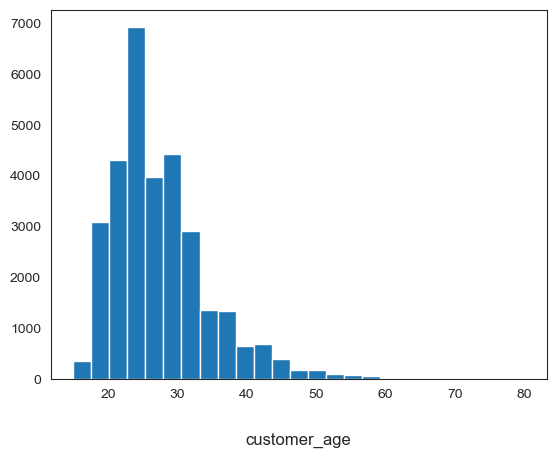

In [53]:
# customer age histogram
plt.hist(df["customer_age"], bins=25)  # 13 bins bc age range is 65 so bins are 5 years each
plt.title("customer_age", y=-0.2)

plt.show()

 - Nearly 2/3 of the data is from customers between the ages of 20 and 30 - maybe we should focus on this agegroup  
 - Looks like an F distribution

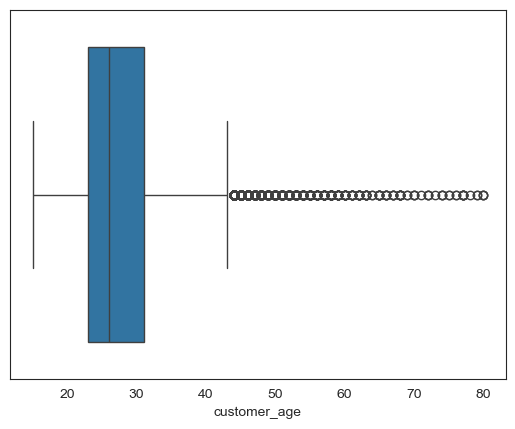

In [54]:
#customer age boxplot
sns.boxplot(x=df["customer_age"])

plt.show()

In [55]:
#let's take a closer look at outliers
age_IQR = df['customer_age'].quantile(0.75) - df['customer_age'].quantile(0.25)
print(age_IQR)

age_lower_bound = df['customer_age'].quantile(0.25) - 1.5 * age_IQR
age_upper_bound = df['customer_age'].quantile(0.75) + 1.5 * age_IQR

print(age_lower_bound)
print(age_upper_bound)

age_outliers = df[(df['customer_age'] < age_lower_bound) | (df['customer_age'] > age_upper_bound)]

print(age_outliers)

8.0
11.0
43.0
            customer_region  customer_age  vendor_count  product_count  \
customer_id                                                              
f49ed5489a             8670          51.0             2              2   
eb13ad08ad             8670          47.0             4              6   
b92ab1eeec             2360          47.0             5              6   
a9f54fe565             8670          48.0             2              4   
085c69caf5             2490          46.0             5             10   
...                     ...           ...           ...            ...   
eb13c834e7             2360          74.0             1              1   
12faabe829             8670          46.0             1              2   
20c90aaf32                -          55.0             1              1   
4ff94a6987             2360          60.0             1              1   
b32f05f979             2360          51.0             1              1   

             is_chain  

In [56]:
age_outliers.shape

(1083, 55)

In [57]:
age_outliers['customer_age'].value_counts()

customer_age
44.0    157
46.0    123
45.0    123
48.0     89
47.0     88
50.0     65
49.0     59
51.0     58
53.0     53
52.0     47
54.0     34
55.0     28
58.0     26
56.0     19
57.0     17
59.0     12
60.0      9
68.0      8
62.0      8
61.0      7
63.0      7
77.0      6
65.0      6
66.0      5
67.0      4
70.0      3
72.0      3
74.0      3
80.0      3
64.0      2
76.0      2
69.0      2
79.0      2
75.0      2
78.0      1
71.0      1
73.0      1
Name: count, dtype: int64

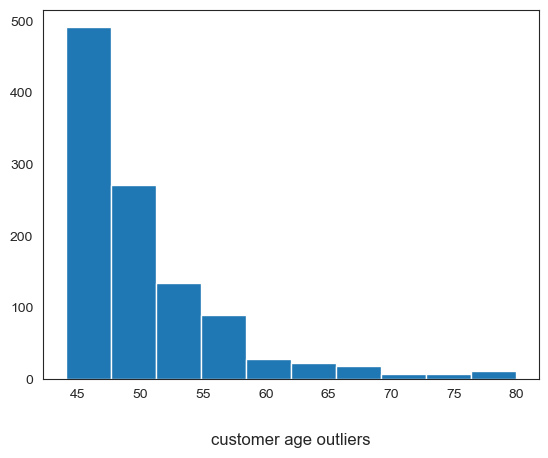

In [58]:
# customer age outlier histogram
plt.hist(age_outliers["customer_age"], bins=10)  # 13 bins bc age range is 65 so bins are 5 years each
plt.title("customer age outliers", y=-0.2)

plt.show()

## Customer Age Summary
- Data type is float
- No abnormal values
- Duplicates are exptected
- There are 727 missing values - currenlty stored as NaN (what percent?)
- Range is 15 years to 80 years
- Mean is 27.51, median is 26, mode is 23
- 50% of the age data is between 23 and 31
- There are 1083 age outliers - anyone over the age of 43 is an outlier

---

### **`Customer Region`**

In [59]:
df['customer_region'].value_counts()

customer_region
8670    9748
4660    9533
2360    8815
2440    1482
4140     856
8370     495
2490     444
-        442
8550      13
Name: count, dtype: int64

In [60]:
#changing the 442 missing values from - to NaN
df.replace("-", np.nan, inplace=True)
df['customer_region'].isna().sum()

442

In [61]:
#bar chart for customer regions
region_counts = pd.DataFrame(df['customer_region'].value_counts())

In [62]:
print(region_counts)

                 count
customer_region       
8670              9748
4660              9533
2360              8815
2440              1482
4140               856
8370               495
2490               444
8550                13


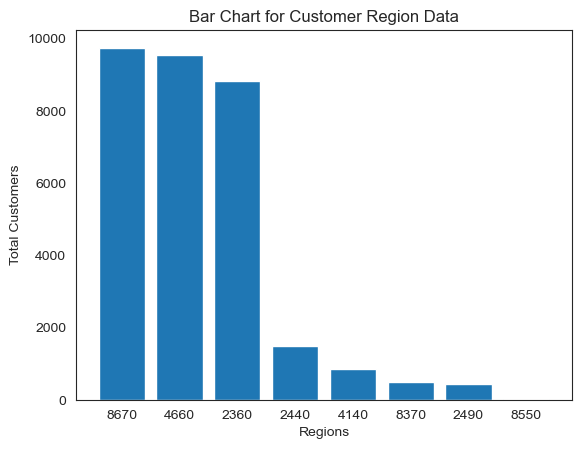

In [63]:
#making a boxplot for region data
plt.bar(region_counts.index, region_counts['count'])

plt.title('Bar Chart for Customer Region Data')
plt.xlabel('Regions')
plt.ylabel('Total Customers')

plt.show()

In [64]:
#sorting so the groups of regions are next to each other
region_counts.sort_index(axis=0, ascending=True, inplace=True, kind='quicksort')

In [65]:
print(region_counts)

                 count
customer_region       
2360              8815
2440              1482
2490               444
4140               856
4660              9533
8370               495
8550                13
8670              9748


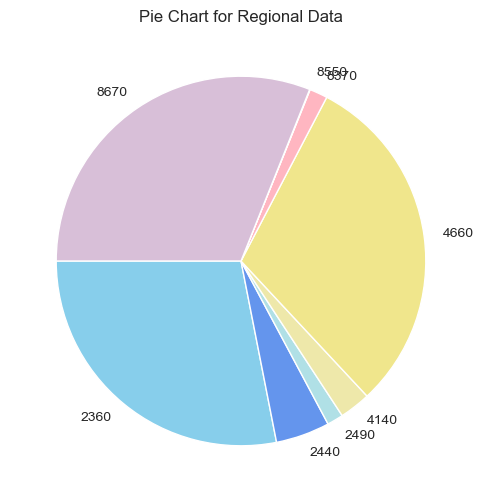

In [66]:
#lets try a pie chart

#pinks are the 8---s, yellow are the 4---s, blue are the 2---s
color_list = ({'2360': 'skyblue', '2440': 'cornflowerblue', '2490': 'powderblue', '4140':'palegoldenrod', '4660':'khaki','8370': 'lightpink', '8550':'plum', '8670':'thistle'})

plt.figure(figsize=(6, 6))

plt.pie(region_counts['count'], labels = region_counts.index, startangle=180, colors = color_list.values())
plt.title('Pie Chart for Regional Data')

plt.show()

In [67]:
# creating a new variable (city) that groups regions by first digit
df['city'] = df['customer_region'].str[0]
df['city'] = df['city'].replace({'2': 'City 2', '4': 'City 4', '8': 'City 8'})

In [68]:
#moving the city column next to customer region
df.insert(df.columns.get_loc('customer_region') + 1, 'city', df.pop('city'))

In [69]:
df.head()

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,City 2,18.0,2,5,1,0,1,DELIVERY,DIGI,...,0,0,0,0,2,0,0,0,0,0
5d272b9dcb,8670,City 8,17.0,2,2,2,0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0
f6d1b2ba63,4660,City 4,38.0,1,2,2,0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,0
180c632ed8,4660,City 4,NaN,2,3,1,0,2,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,0,0
4eb37a6705,4660,City 4,20.0,2,5,0,0,2,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,0,0


In [70]:
#creating data frames for each of the cities
city_2 = df[df['city'] == 'City 2']
city_4 = df[df['city'] == 'City 4']
city_8 = df[df['city'] == 'City 8']

In [71]:
#descriptive statistics for each of the cities
print(city_2.shape)
print(city_4.shape)
print(city_8.shape)

(10741, 56)
(10389, 56)
(10256, 56)


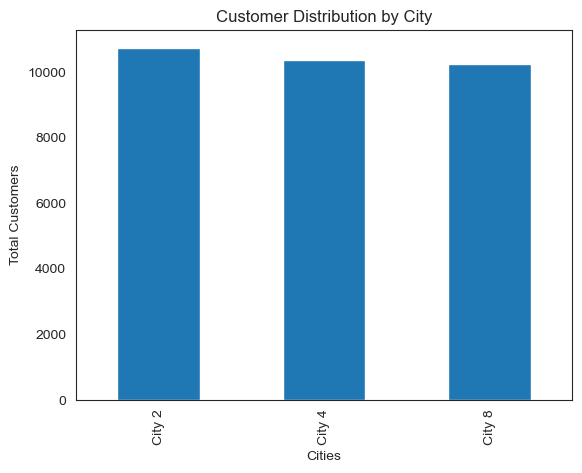

In [72]:
#add bar chart for this
#making a boxplot for region data
city_counts = pd.DataFrame(df['city'].value_counts())

df['city'].value_counts().plot(kind='bar')

plt.title('Customer Distribution by City')
plt.xlabel('Cities')
plt.ylabel('Total Customers')

plt.show()

## Customer Region Summary
- Data type is object
- 442 missing values (what percent?)
- Duplicates are expected
- If we assume the first digit of the region indicates city, customers are split appproximately evenly throughout the three cities
    - 10,757 customers in City 2 (cities beginning with 2)
    - 10,407 customers in City 4 (cities beginning with 4)
    - 10,282 customers in City 8 (cities beginning with 8)
- The majority of customers live in 3 of the 8 regions:
    - 2360
    - 4660
    - 8670  

It is probably safe to assume these are the city centers of the cities

---

### **`Payment method`**

In [73]:
df['payment_method'].value_counts()

payment_method
CARD    20119
DIGI     6090
CASH     5619
Name: count, dtype: int64

In [74]:
payment_groups = pd.DataFrame(df['payment_method'].value_counts())

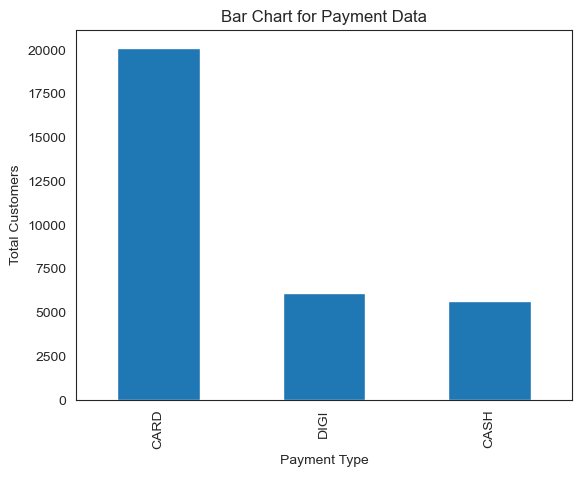

In [75]:
#bar chat for a visual
df['payment_method'].value_counts().plot(kind='bar')

plt.title('Bar Chart for Payment Data')
plt.xlabel('Payment Type')
plt.ylabel('Total Customers')

plt.show()

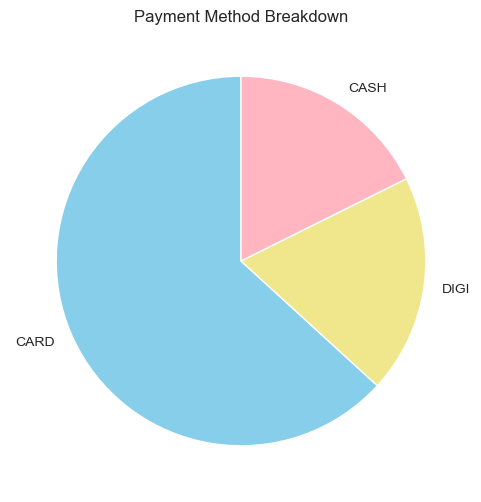

In [76]:
#a pie chart for fun
plt.figure(figsize=(6, 6))

plt.pie(payment_groups['count'], labels = payment_groups.index, startangle = 90, colors = ['skyblue','khaki','lightpink'])
plt.title('Payment Method Breakdown')


plt.show()

## Feature Engineering: Payment method as online or in-person

In [77]:
df['payment_method_combined'] = df['payment_method']
df['payment_method_combined'] = df['payment_method_combined'].replace({'CARD': 'In Person', 'CASH': 'In Person', 'DIGI': 'Online'})

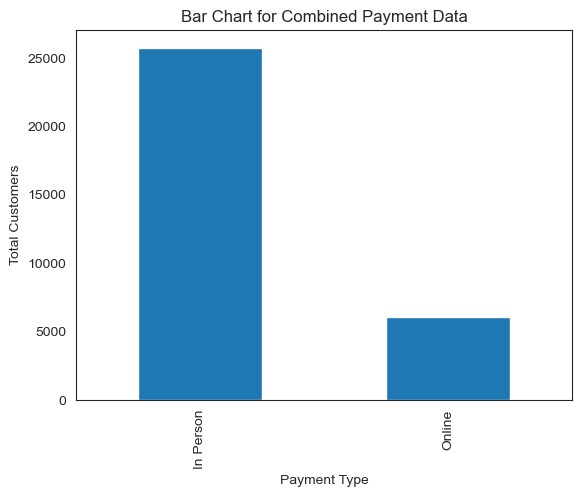

In [78]:
df['payment_method_combined'].value_counts().plot(kind='bar')

plt.title('Bar Chart for Combined Payment Data')
plt.xlabel('Payment Type')
plt.ylabel('Total Customers')

plt.show()

# Payment Method Summary  
- Data type is object
- Duplicate values are expected
- No missing values
- 2/3 of customers pay with card
- Not much else to do with payment method on its own

---

### **`CUI_variables`**

- These variables are floats.
- There no missing values in these variables.
- There are several answers that corresponds to the fact that cutomers have not spend any monetary units in asked type of cuisine.

In [79]:
# A list with all CUI_ variables have been created.
    
cui_columns = ['CUI_American','CUI_Asian','CUI_Beverages','CUI_Cafe','CUI_Chicken Dishes','CUI_Chinese','CUI_Desserts','CUI_Healthy','CUI_Indian','CUI_Italian','CUI_Japanese','CUI_Noodle Dishes','CUI_OTHER','CUI_Street Food / Snacks','CUI_Thai']
df[cui_columns]

,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
customer_id,,,,,,,,,,,,,,,
1b8f824d5e,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.0,28.88,0.00,0.0,0.0,0.0,0.0,0.0
5d272b9dcb,12.82,6.39,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
f6d1b2ba63,9.20,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
180c632ed8,0.00,13.70,0.00,0.0,0.0,0.0,0.00,0.0,17.86,0.00,0.0,0.0,0.0,0.0,0.0
4eb37a6705,14.57,40.87,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0.00,0.00,18.04,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
f6b6709018,18.04,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
f74ad8ce3f,0.00,0.00,0.00,0.0,0.0,0.0,17.79,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0


In [80]:
df[cui_columns].info()

<class 'pandas.core.frame.DataFrame'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CUI_American              31828 non-null  float64
 1   CUI_Asian                 31828 non-null  float64
 2   CUI_Beverages             31828 non-null  float64
 3   CUI_Cafe                  31828 non-null  float64
 4   CUI_Chicken Dishes        31828 non-null  float64
 5   CUI_Chinese               31828 non-null  float64
 6   CUI_Desserts              31828 non-null  float64
 7   CUI_Healthy               31828 non-null  float64
 8   CUI_Indian                31828 non-null  float64
 9   CUI_Italian               31828 non-null  float64
 10  CUI_Japanese              31828 non-null  float64
 11  CUI_Noodle Dishes         31828 non-null  float64
 12  CUI_OTHER                 31828 non-null  float64
 13  CUI_Street Food / Snacks  31828 non-null  float64
 1

In [81]:
df[cui_columns].describe()

,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
count,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000
mean,4.878717,9.959460,2.296773,0.802162,0.768990,1.431904,0.884069,0.951931,1.630242,3.234723,2.993057,0.712701,3.002839,3.906958,0.841754
std,11.652854,23.571343,8.470691,6.432826,3.660007,8.196175,5.257256,5.835936,7.443219,11.253846,10.182749,4.540379,9.775722,15.522462,4.435322
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,5.660000,11.830000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,280.210000,896.710000,229.220000,326.100000,219.660000,739.730000,230.070000,255.810000,309.070000,468.330000,706.140000,275.110000,366.080000,454.450000,136.380000


In [82]:
zero_counts = {}

for column in cui_columns:
    zero_counts[column] = (df[column] == 0.00).sum()

for column, count in zero_counts.items():
    print(f"Number of 0.00 values for {column}: {count}")

Number of 0.00 values for CUI_American: 21053
Number of 0.00 values for CUI_Asian: 19953
Number of 0.00 values for CUI_Beverages: 26405
Number of 0.00 values for CUI_Cafe: 30465
Number of 0.00 values for CUI_Chicken Dishes: 28582
Number of 0.00 values for CUI_Chinese: 28310
Number of 0.00 values for CUI_Desserts: 29815
Number of 0.00 values for CUI_Healthy: 29660
Number of 0.00 values for CUI_Indian: 28388
Number of 0.00 values for CUI_Italian: 25389
Number of 0.00 values for CUI_Japanese: 25542
Number of 0.00 values for CUI_Noodle Dishes: 29604
Number of 0.00 values for CUI_OTHER: 24795
Number of 0.00 values for CUI_Street Food / Snacks: 27589
Number of 0.00 values for CUI_Thai: 29455


In [83]:
percentage = {}
for column, count in zero_counts.items():
    percentage[column] = round((count / 31888) * 100, 2)

# Sort the dictionary in ascending order
sorted_percentage = dict(sorted(percentage.items(), key=lambda x: x[1], reverse=True))

for key, value in sorted_percentage.items():
    print(f"Percentage share of 0.00 values in {key}: {value}%")


Percentage share of 0.00 values in CUI_Cafe: 95.54%
Percentage share of 0.00 values in CUI_Desserts: 93.5%
Percentage share of 0.00 values in CUI_Healthy: 93.01%
Percentage share of 0.00 values in CUI_Noodle Dishes: 92.84%
Percentage share of 0.00 values in CUI_Thai: 92.37%
Percentage share of 0.00 values in CUI_Chicken Dishes: 89.63%
Percentage share of 0.00 values in CUI_Indian: 89.02%
Percentage share of 0.00 values in CUI_Chinese: 88.78%
Percentage share of 0.00 values in CUI_Street Food / Snacks: 86.52%
Percentage share of 0.00 values in CUI_Beverages: 82.81%
Percentage share of 0.00 values in CUI_Japanese: 80.1%
Percentage share of 0.00 values in CUI_Italian: 79.62%
Percentage share of 0.00 values in CUI_OTHER: 77.76%
Percentage share of 0.00 values in CUI_American: 66.02%
Percentage share of 0.00 values in CUI_Asian: 62.57%


In [236]:
# Calulating how many rows (customers) there are that have 0 values for each cusine 
# Checking for "missing values"
rows_with_only_zeros_in_cuisines = (df[cui_columns] == 0).all(axis=1)
num_rows_with_only_zeros_in_cuisines = rows_with_only_zeros_in_cuisines.sum()
print(f"There are {num_rows_with_only_zeros_in_cuisines} rows in total that have only 0 values in cui variables")

There are 138 rows in total that have only 0 values in cui variables


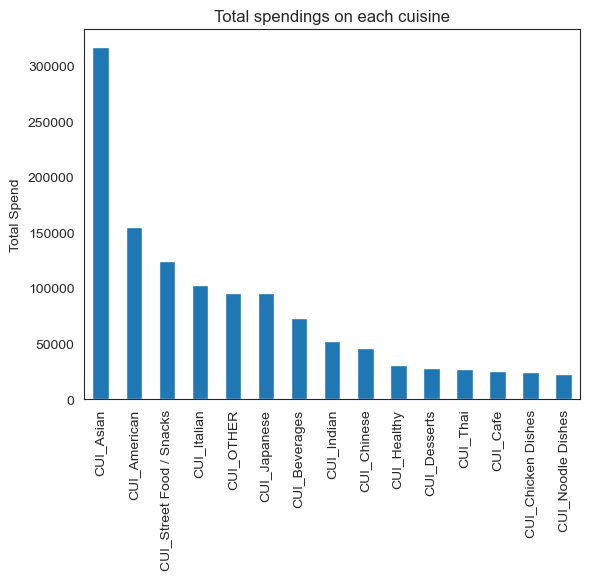

In [85]:
sorted_sums_cui = df[cui_columns].sum().sort_values(ascending=False)

sorted_sums_cui.plot(kind='bar')

plt.title('Total spendings on each cuisine')
plt.ylabel('Total Spend')
plt.show()

Most money are spend on Asian cuisine. Then on American and Street Fodd. The least is spend on Noodle and Chicken Dishes, Cafe, Thai, Desserts and Healthy cuisine.  

Check for outliers in CUI_ columns (withouts 0 values)

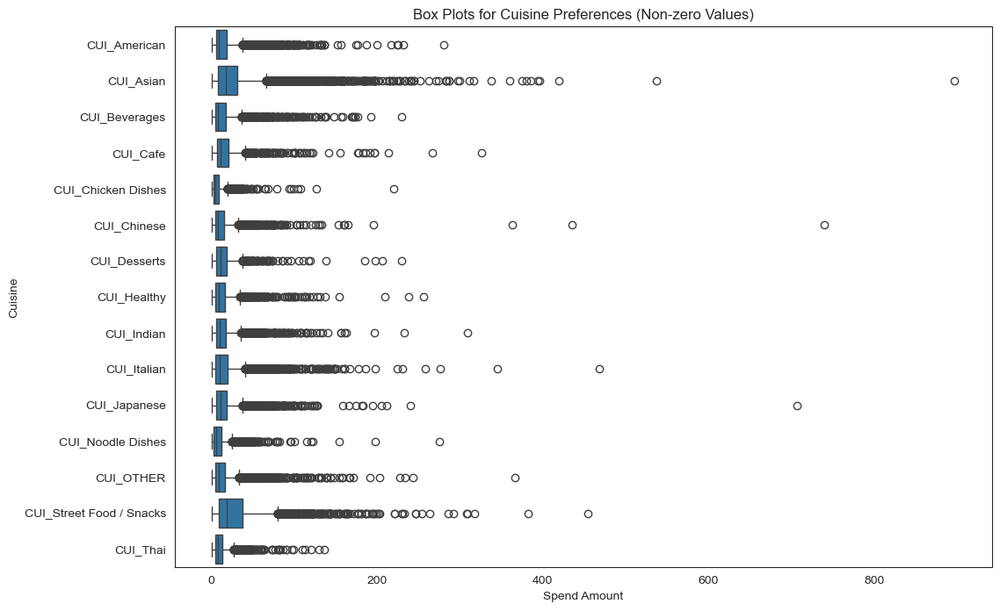

In [86]:

df_melted = df.melt(value_vars=cui_columns, var_name='Cuisine', value_name='Spend Amount')

df_melted = df_melted[df_melted['Spend Amount'] != 0]


plt.figure(figsize=(12, 8))
sns.boxplot(y='Cuisine', x='Spend Amount', data=df_melted)

plt.title('Box Plots for Cuisine Preferences (Non-zero Values)')
plt.show()

Check for outliers in CUI_ columns (with 0 values)

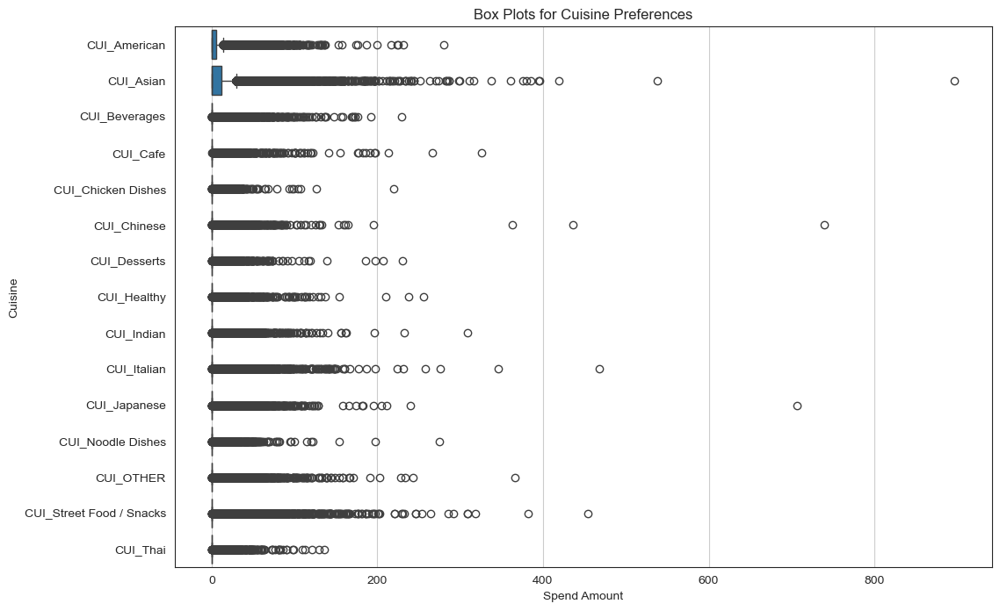

In [87]:
df_melted = df.melt(value_vars=cui_columns, var_name='Cuisine', value_name='Spend Amount')

plt.figure(figsize=(12, 8))
sns.boxplot(y='Cuisine', x='Spend Amount', data=df_melted)

plt.title('Box Plots for Cuisine Preferences')
plt.grid(axis='x')  
plt.show()


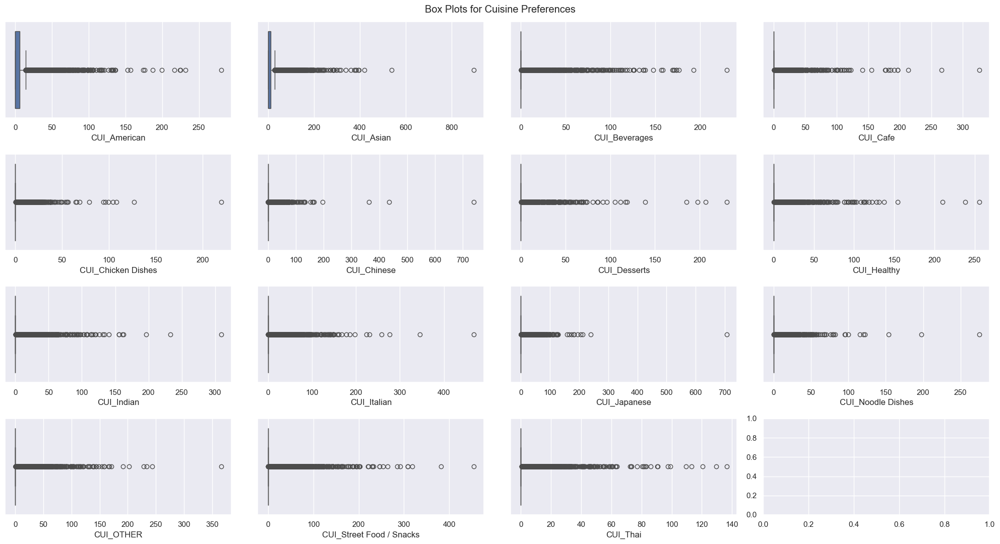

In [88]:
sns.set() 

sp_rows = 4
sp_cols = math.ceil(len(cui_columns) / sp_rows)



fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(20, 11),
                         tight_layout=True
                        )


for ax, feat in zip(axes.flatten(), df[cui_columns]):
    sns.boxplot(x=df[feat], ax=ax)
    

title = "Box Plots for Cuisine Preferences"

plt.suptitle(title)

# if not os.path.exists(os.path.join('..', 'figures', 'eda')):
#     # if the eda directory is not present then create it first
#     os.makedirs(os.path.join('..', 'figures', 'eda'))


# plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_variables_boxplots.png'), dpi=200)


plt.show()

In [222]:
outlier_detection(df, cui_columns)

CUI_American: 
Number of extreme outliers: 1967 (35%) 
Number of moderate outliers: 3502 (64%) 
Total number of outliers: 5469
Q3 + 1.5*IQR = 8.49 
Q3 + 3*IQR = 16.98
Max: 280.21 
Min: 0.0 

CUI_Asian: 
Number of extreme outliers: 1795 (34%) 
Number of moderate outliers: 3470 (65%) 
Total number of outliers: 5265
Q3 + 1.5*IQR = 17.745 
Q3 + 3*IQR = 35.49
Max: 896.71 
Min: 0.0 

CUI_Beverages: 
Number of extreme outliers: 5423 (50%) 
Number of moderate outliers: 5423 (50%) 
Total number of outliers: 10846
Q3 + 1.5*IQR = 0.0 
Q3 + 3*IQR = 0.0
Max: 229.22 
Min: 0.0 

CUI_Cafe: 
Number of extreme outliers: 1363 (50%) 
Number of moderate outliers: 1363 (50%) 
Total number of outliers: 2726
Q3 + 1.5*IQR = 0.0 
Q3 + 3*IQR = 0.0
Max: 326.1 
Min: 0.0 

CUI_Chicken Dishes: 
Number of extreme outliers: 3246 (50%) 
Number of moderate outliers: 3246 (50%) 
Total number of outliers: 6492
Q3 + 1.5*IQR = 0.0 
Q3 + 3*IQR = 0.0
Max: 219.66 
Min: 0.0 

CUI_Chinese: 
Number of extreme outliers: 3518 (50%)

**A new column in dataset has been created. It shows how much each customer spend on food in total**


In [223]:
# Sum of values for each customer (row-wise)
df['total_spending_pc'] = df[cui_columns].sum(axis=1) 
df

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,total_spending_pc
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,City 2,18.0,2,5,1,0,1,DELIVERY,DIGI,...,0,0,2,0,0,0,0,0,Online,28.88
5d272b9dcb,8670,City 8,17.0,2,2,2,0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,Online,19.21
f6d1b2ba63,4660,City 4,38.0,1,2,2,0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,In Person,9.20
180c632ed8,4660,City 4,NaN,2,3,1,0,2,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,Online,31.56
4eb37a6705,4660,City 4,20.0,2,5,0,0,2,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,Online,55.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,8670,City 8,30.0,1,1,1,<NA>,0,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,Online,18.04
f6b6709018,8670,City 8,NaN,1,1,0,<NA>,0,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,Online,18.04
f74ad8ce3f,8670,City 8,24.0,1,1,1,<NA>,0,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,Online,17.79


In [224]:
df['total_spending_pc'].describe()

count    31828.000000
mean        38.296280
std         46.406332
min          0.000000
25%         12.880000
50%         24.130000
75%         44.990000
max       1418.330000
Name: total_spending_pc, dtype: float64

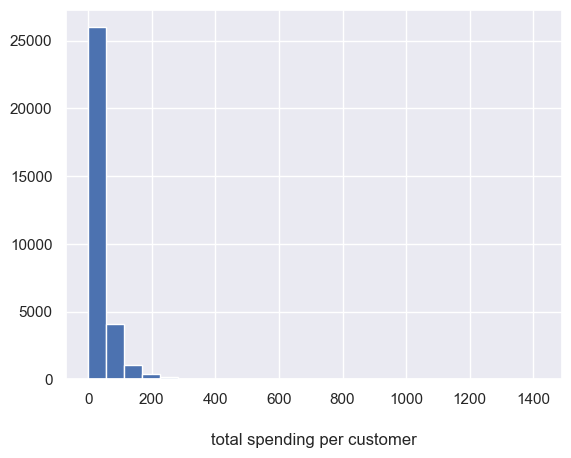

In [225]:
# total spending per customer histogram
plt.hist(df["total_spending_pc"], bins=25)  
plt.title("total spending per customer", y=-0.2)

plt.show()

In [226]:
# Display the customer that spend the highest amount (potential outlier)

max_spender_idx = df['total_spending_pc'].idxmax()
max_spender = df.loc[max_spender_idx]


print("Customer with maximum total spending:")
print(max_spender)


Customer with maximum total spending:
customer_region                      2360
city                               City 2
customer_age                         23.0
vendor_count                           40
product_count                         269
is_chain                               81
first_order                             0
last_order                             88
last_promo                  NO PROMO USED
payment_method                       CARD
CUI_American                        19.08
CUI_Asian                           70.01
CUI_Beverages                       37.92
CUI_Cafe                             18.3
CUI_Chicken Dishes                    0.0
CUI_Chinese                        739.73
CUI_Desserts                          0.0
CUI_Healthy                           0.0
CUI_Indian                            0.0
CUI_Italian                         20.11
CUI_Japanese                        84.05
CUI_Noodle Dishes                  197.84
CUI_OTHER                          109

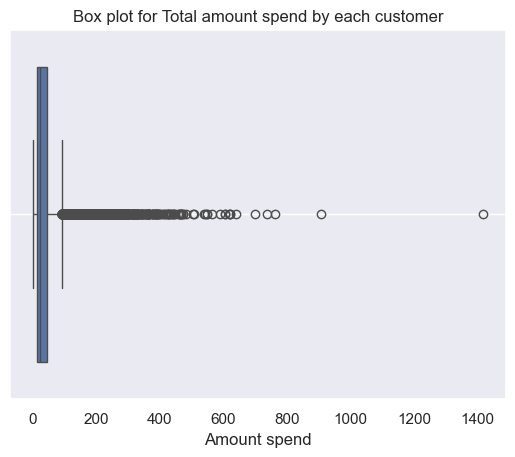

In [228]:
sns.boxplot(x=df["total_spending_pc"])
plt.title('Box plot for Total amount spend by each customer')
plt.xlabel('Amount spend')
plt.grid()
plt.show()

In [227]:
outlier_detection(df, ['total_spending_pc'])

total_spending_pc: 
Number of extreme outliers: 1120 (29%) 
Number of moderate outliers: 2616 (70%) 
Total number of outliers: 3736
Q3 + 1.5*IQR = 61.045 
Q3 + 3*IQR = 109.21
Max: 1418.33 
Min: 0.0 



Create a new variable that has binary values for each cuisine, indicating if customer buy something or not.

In [230]:
# Change of cuisine type to binary variables 0 and 1; 0 if customer didnt buy anything from indicated cusinie or 1 if customer actually bought something 
df_bin = df.copy()
df_bin[cui_columns] = df[cui_columns].map(lambda x: 1 if x != 0 else 0)
df_bin


,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,total_spending_pc
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,City 2,18.0,2,5,1,0,1,DELIVERY,DIGI,...,0,0,2,0,0,0,0,0,Online,28.88
5d272b9dcb,8670,City 8,17.0,2,2,2,0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,Online,19.21
f6d1b2ba63,4660,City 4,38.0,1,2,2,0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,In Person,9.20
180c632ed8,4660,City 4,NaN,2,3,1,0,2,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,Online,31.56
4eb37a6705,4660,City 4,20.0,2,5,0,0,2,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,Online,55.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,8670,City 8,30.0,1,1,1,<NA>,0,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,Online,18.04
f6b6709018,8670,City 8,NaN,1,1,0,<NA>,0,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,Online,18.04
f74ad8ce3f,8670,City 8,24.0,1,1,1,<NA>,0,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,Online,17.79


In [231]:
count_ones = (df_bin[cui_columns] == 1).sum().sum()
print(f'The number of 1s in all CUI columns is {count_ones}')

The number of 1s in all CUI columns is 72415


In [232]:
count_non_nulls = df['product_count'].count().sum()
print(f" The Total number of products that has been ordered is: {count_non_nulls}")

 The Total number of products that has been ordered is: 31828


### Key Notes on variables CUI_
- Represents a continous variable (in a range from 0 to 897)
- These variables corresponds to the price that each customer spend on indicated cuisine type
- No NaN values, No hidden NaN values 
- There are a lot of rows that have 0 values, that means no monetary units have been spend on specific cuisine type.
- Most money people spend on Asian cuisine. Then on American and Street Fodd. The least is spend on Noodle and Chicken Dishes, Cafe, Thai, Desserts and Healthy cuisine.  
- There are 138 customers that have not spend any monetary units for any type of cuisine
- There are 29% of customers that are extreme outliers.


---

### **`DOW_ variables`**

- These variables are integers.
- They represents a discrete numbers (from 0 to 20)
- There no missing values in these variables.
- DOW_ variables indicates the number of orders placed on each day of the week

In [252]:
dow_columns = ["DOW_1", "DOW_2", "DOW_3", "DOW_4", "DOW_5", "DOW_6", "DOW_0"]
day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

In [253]:
df[dow_columns].info()

<class 'pandas.core.frame.DataFrame'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   DOW_1   31828 non-null  int64
 1   DOW_2   31828 non-null  int64
 2   DOW_3   31828 non-null  int64
 3   DOW_4   31828 non-null  int64
 4   DOW_5   31828 non-null  int64
 5   DOW_6   31828 non-null  int64
 6   DOW_0   31828 non-null  int64
dtypes: int64(7)
memory usage: 3.0+ MB


In [91]:
df[dow_columns].describe()

,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,DOW_0
count,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000
mean,0.567771,0.590801,0.619297,0.677957,0.652947,0.704254,0.555894
std,1.044383,1.045672,1.069931,1.088231,1.069820,1.167516,1.013460
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,17.000000,15.000000,17.000000,16.000000,20.000000,20.000000,16.000000


In [92]:
for variable in df[dow_columns]:
    unique_v = df[variable].unique()
    print(f"Unique values for variable {variable} are: {unique_v}")

Unique values for variable DOW_1 are: [ 0  1  2  3  6  4  9  5 10  8  7 11 13 15 17 16 12]
Unique values for variable DOW_2 are: [ 0  1  2  3  4  9  5  7  6  8 15 14 10 11 12 13]
Unique values for variable DOW_3 are: [ 0  1  2  3  4  8  5  6  7  9 10 14 11 17 13 12 16]
Unique values for variable DOW_4 are: [ 0  1  2  3  6 10  4  7  5  8  9 11 14 12 13 15 16]
Unique values for variable DOW_5 are: [ 0  1  2  3  5  4 10  7  9  6  8 13 11 15 12 20 14]
Unique values for variable DOW_6 are: [ 1  2  3  4  7  9  6  5  8 10 11 17 13 12 14 20  0]
Unique values for variable DOW_0 are: [ 1  0  2  3  5  4  9  6  8 10  7 11 15 16]


There are no NaN values in the Dow_variables. Dow_ variables are numerical in a range from 0 to 20

In [93]:
zero_counts_dow = {}

for column in dow_columns:
    zero_counts_dow[column] = (df[column] == 0).sum()

for column, count in zero_counts_dow.items():
    print(f"Number of 0 values for {column}: {count}")

Number of 0 values for DOW_1: 20523
Number of 0 values for DOW_2: 20077
Number of 0 values for DOW_3: 19596
Number of 0 values for DOW_4: 18362
Number of 0 values for DOW_5: 18758
Number of 0 values for DOW_6: 18480
Number of 0 values for DOW_0: 20598


In [94]:
percentage_dow = {}
for column, count in zero_counts_dow.items():
    percentage_dow[column] = round((count / 31888) * 100, 2)

# Sort the dictionary in ascending order
sorted_percentage_dow = dict(sorted(percentage_dow.items(), key=lambda x: x[1], reverse=True))

for key, value in sorted_percentage_dow.items():
    print(f"Percentage share of 0 values in {key}: {value}%")


Percentage share of 0 values in DOW_0: 64.59%
Percentage share of 0 values in DOW_1: 64.36%
Percentage share of 0 values in DOW_2: 62.96%
Percentage share of 0 values in DOW_3: 61.45%
Percentage share of 0 values in DOW_5: 58.82%
Percentage share of 0 values in DOW_6: 57.95%
Percentage share of 0 values in DOW_4: 57.58%


In [235]:
# Calulating how many rows (customers) there are that have not ordered during any of the week day
#Checking missing values 
rows_with_only_zeros_in_days = (df[dow_columns] == 0).all(axis=1)
num_rows_with_only_zeros_in_days = rows_with_only_zeros_in_days.sum()
num_rows_with_only_zeros_in_days
print(f"There are {num_rows_with_only_zeros_in_days} rows in total that have only 0 in dow variables")

There are 138 rows in total that have only 0 in dow variables


Countplot since it is categorical variable.

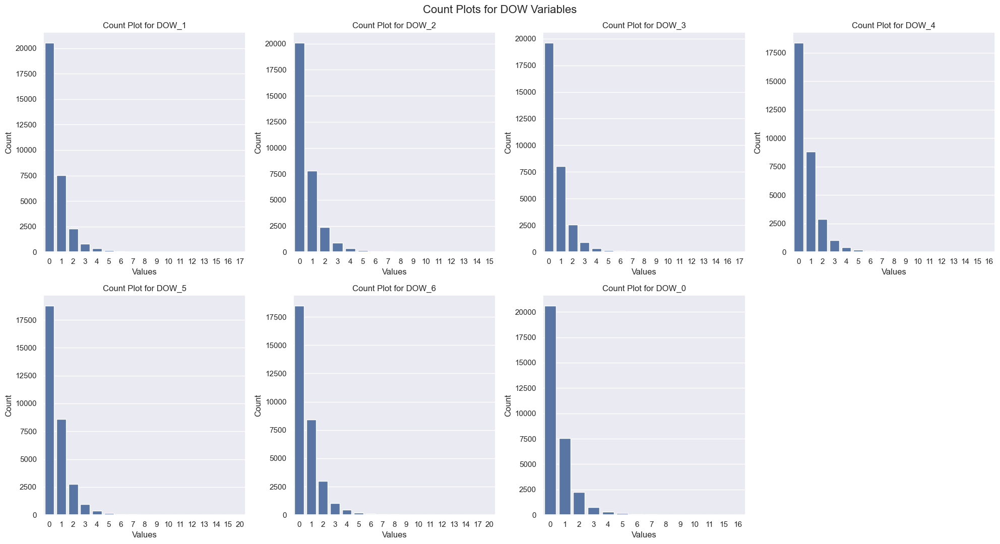

In [97]:
sp_rows = 2
sp_cols = math.ceil(len(dow_columns) / sp_rows)

# Create subplots
fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(20, 11), tight_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each DOW column and create a countplot
for ax, column in zip(axes, dow_columns):
    sns.countplot(x=df[column], ax=ax)
    ax.set_title(f'Count Plot for {column}')  # Set title for each subplot
    ax.set_xlabel('Values')  # Label for x-axis
    ax.set_ylabel('Count')  # Label for y-axis

# If there are more axes than columns, hide the unused ones
for i in range(len(dow_columns), len(axes)):
    fig.delaxes(axes[i])

# Show the plot
plt.suptitle('Count Plots for DOW Variables', fontsize=16)
plt.show()


In [255]:
# # Number of columns and rows for the subplots
# n_cols = 4
# n_rows = 2

# # Prepare figure. Create individual axes where each histogram will be placed
# fig, axes = plt.subplots(n_rows, 
#                          n_cols, 
#                          figsize=(16, 10))  

# fig.suptitle('Histograms for Number of Orders per day')

# # Flatten axes for easy indexing
# axes = axes.flatten()

# # Loop through each column and plot its histogram on the corresponding subplot
# for i, column in enumerate(dow_columns):
#     df[column].hist(bins=16, ax=axes[i])  # Plot the histogram
#     axes[i].set_title(f'Histogram for {day_names[i]}')
#     axes[i].set_xlabel('Number of orders')
#     axes[i].set_ylabel('Frequency')

# # Adjust layout
# plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust the layout to fit everything
# plt.show()

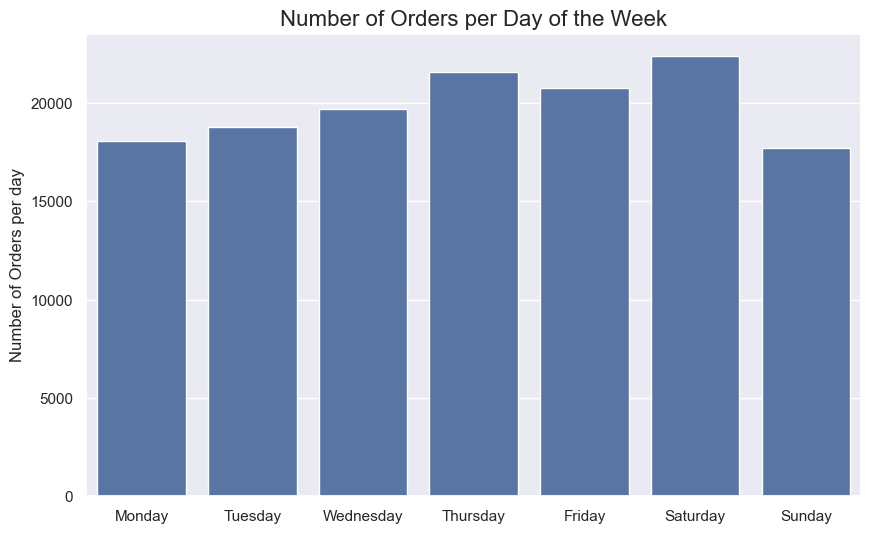

In [99]:
# Sum the values for each day of the week
dow_plot = df[dow_columns].sum()

# Create a new DataFrame for visualization
dow_counts = pd.DataFrame({
    'Day': day_names,
    'Number of Orders': dow_plot.values
})

# Create a count plot (using barplot here since we already have aggregated data)
plt.figure(figsize=(10, 6))
sns.barplot(x='Day', y='Number of Orders', data=dow_counts)

# Set the title and labels
plt.title('Number of Orders per Day of the Week', fontsize=16)
plt.xlabel('') 
plt.ylabel('Number of Orders per day', fontsize=12)
#plt.xticks(rotation=90)  

# Show the plot
plt.show()

The highest number of orders is placed on Saturday and Thursday. The least orders are on Sundays

In [100]:
dow_plot.describe()

count        7.000000
mean     19864.857143
std       1796.441615
min      17693.000000
25%      18437.500000
50%      19711.000000
75%      21180.000000
max      22415.000000
dtype: float64

In [101]:
print(f"The total number of orders is: {dow_plot.sum()}")

The total number of orders is: 139054


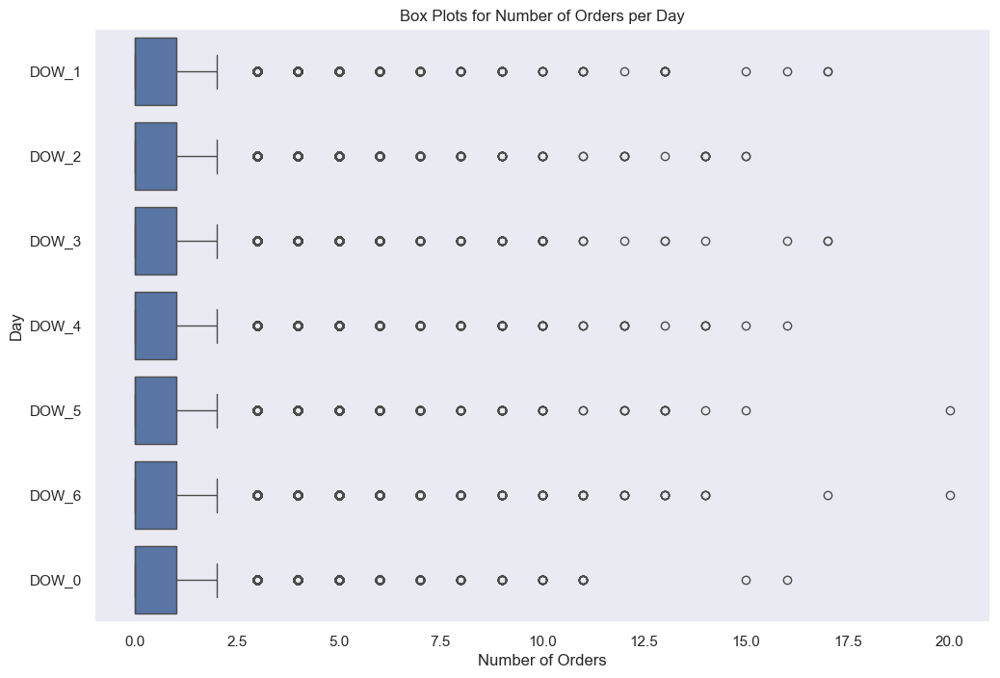

In [263]:
df_melted = df.melt(value_vars=dow_columns, var_name='Day', value_name='Number of Orders')

plt.figure(figsize=(12, 8))
sns.boxplot(y='Day', x='Number of Orders', data=df_melted)

plt.title('Box Plots for Number of Orders per Day')
plt.grid(axis='x')  
plt.show()


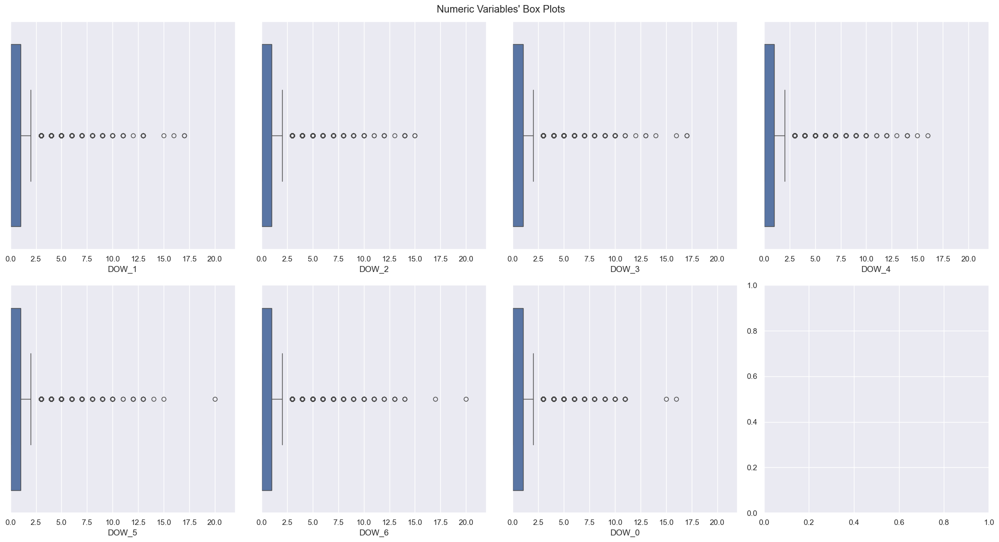

In [103]:
# Plot ALL Numeric Variables' Histograms in one figure

sns.set() ## Reset to darkgrid

## What do these do?
sp_rows = 2
sp_cols = math.ceil(len(dow_columns) / sp_rows)


# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(20, 11),
                         tight_layout=True
                        )

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), df[dow_columns]): # Notice the zip() function and flatten() method
    sns.boxplot(x=df[feat], ax=ax)
    ax.set_xlim(0, 22)
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

if not os.path.exists(os.path.join('..', 'figures', 'eda')):
    # if the eda directory is not present then create it first
    os.makedirs(os.path.join('..', 'figures', 'eda'))


#plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_variables_boxplots.png'), dpi=200)


plt.show()

In [264]:
outlier_detection(df, dow_columns)

DOW_1: 
Number of extreme outliers: 324 (17%) 
Number of moderate outliers: 1494 (82%) 
Total number of outliers: 1818
Q3 + 1.5*IQR = 1.5 
Q3 + 3*IQR = 3.0
Max: 17 
Min: 0 

DOW_2: 
Number of extreme outliers: 359 (18%) 
Number of moderate outliers: 1584 (81%) 
Total number of outliers: 1943
Q3 + 1.5*IQR = 1.5 
Q3 + 3*IQR = 3.0
Max: 15 
Min: 0 

DOW_3: 
Number of extreme outliers: 378 (18%) 
Number of moderate outliers: 1652 (81%) 
Total number of outliers: 2030
Q3 + 1.5*IQR = 1.5 
Q3 + 3*IQR = 3.0
Max: 17 
Min: 0 

DOW_4: 
Number of extreme outliers: 376 (17%) 
Number of moderate outliers: 1782 (82%) 
Total number of outliers: 2158
Q3 + 1.5*IQR = 1.5 
Q3 + 3*IQR = 3.0
Max: 16 
Min: 0 

DOW_5: 
Number of extreme outliers: 347 (16%) 
Number of moderate outliers: 1705 (83%) 
Total number of outliers: 2052
Q3 + 1.5*IQR = 1.5 
Q3 + 3*IQR = 3.0
Max: 20 
Min: 0 

DOW_6: 
Number of extreme outliers: 486 (19%) 
Number of moderate outliers: 1971 (80%) 
Total number of outliers: 2457
Q3 + 1.5*IQ

There are 18% of extreme outliers in DOW_Columns

In [256]:
# Sum of orders per week for each customer (row-wise)
df['total_orders_pw'] = df[dow_columns].sum(axis=1) 
df

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,total_orders_pw
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,0.00,...,0,0,0,2,0,0,0,0,0,2
5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,12.82,...,0,0,0,0,0,0,0,0,0,2
f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,9.20,...,0,0,0,0,0,0,0,0,0,2
180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,0.00,...,0,0,0,0,0,0,0,0,0,2
4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,14.57,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,8670,30.0,1,1,1,NaN,0,FREEBIE,DIGI,0.00,...,0,0,0,0,0,0,0,0,0,1
f6b6709018,8670,NaN,1,1,0,NaN,0,DELIVERY,DIGI,18.04,...,0,1,0,0,0,0,0,0,0,1
f74ad8ce3f,8670,24.0,1,1,1,NaN,0,-,DIGI,0.00,...,0,0,0,0,0,0,0,0,0,1


In [257]:
df['total_orders_pw'].describe()

count    31828.000000
mean         4.368920
std          5.084957
min          0.000000
25%          2.000000
50%          3.000000
75%          5.000000
max         94.000000
Name: total_orders_pw, dtype: float64

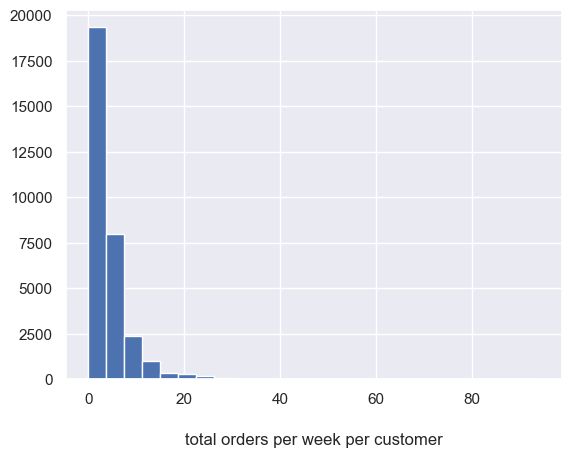

In [259]:
# total spending per customer histogram
plt.hist(df['total_orders_pw'], bins=25)  
plt.title("total orders per week per customer", y=-0.2)

plt.show()

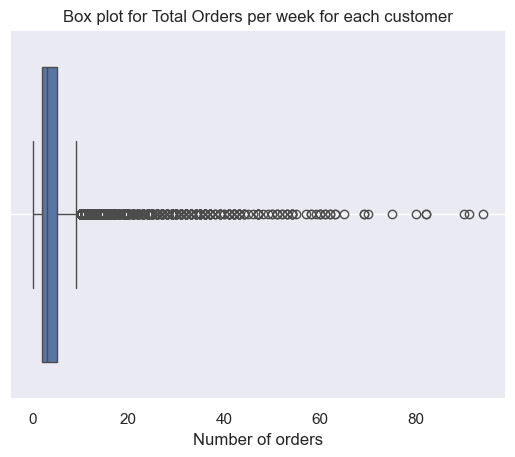

In [265]:
sns.boxplot(x=df['total_orders_pw'])
plt.title('Box plot for Total Orders per week for each customer')
plt.xlabel('Number of orders')
plt.grid()
plt.show()

In [261]:
outlier_detection(df, 'total_orders_pw')

total_orders_pw: 
Number of extreme outliers: 1309 (30%) 
Number of moderate outliers: 3021 (69%) 
Total number of outliers: 4330
Q3 + 1.5*IQR = 6.5 
Q3 + 3*IQR = 11.0
Max: 94 
Min: 0 



### Key Notes on variables DOW_
- Represents a discrete variable (from 0 to 20)
- These variables corresponds to number of orders places each day of the week
- No NaN values, No hidden NaN values 
- There are a lot of rows that have 0 values, that means there were no orders placed
- Customers orders mostly on Saturdays and Thrusdays. The least orders are on Sundays and Mondays 
- There are 138 customers that have not placed any order in any day of the week (those are the same customers that were detected in the CUI_vairables)
- There are 30% of customers that are potential outliers when it comes to total orders placed during a week.


---

### **`HR_ variables`**

In [104]:
hr_columns = ["HR_0", "HR_1", "HR_2", "HR_3", "HR_4", "HR_5", "HR_6", "HR_7", "HR_8", "HR_9", "HR_10", "HR_11", 
              "HR_12", "HR_13", "HR_14", "HR_15", "HR_16", "HR_17", "HR_18", "HR_19", "HR_20", "HR_21", "HR_22", "HR_23"]

hr_values = [int(column.split('_')[1]) for column in hr_columns]

# Output the new list
print(hr_values)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]


In [105]:
df[hr_columns].info()

<class 'pandas.core.frame.DataFrame'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Data columns (total 24 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   HR_0    30664 non-null  float64
 1   HR_1    31828 non-null  int64  
 2   HR_2    31828 non-null  int64  
 3   HR_3    31828 non-null  int64  
 4   HR_4    31828 non-null  int64  
 5   HR_5    31828 non-null  int64  
 6   HR_6    31828 non-null  int64  
 7   HR_7    31828 non-null  int64  
 8   HR_8    31828 non-null  int64  
 9   HR_9    31828 non-null  int64  
 10  HR_10   31828 non-null  int64  
 11  HR_11   31828 non-null  int64  
 12  HR_12   31828 non-null  int64  
 13  HR_13   31828 non-null  int64  
 14  HR_14   31828 non-null  int64  
 15  HR_15   31828 non-null  int64  
 16  HR_16   31828 non-null  int64  
 17  HR_17   31828 non-null  int64  
 18  HR_18   31828 non-null  int64  
 19  HR_19   31828 non-null  int64  
 20  HR_20   31828 non-null  int64  
 21  HR_21   31828 non-null  in

In [106]:
df[hr_columns].describe()

,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
count,30664.0,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,...,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000,31828.000000
mean,0.0,0.053726,0.063183,0.118386,0.101609,0.081846,0.069718,0.076756,0.131928,0.234259,...,0.215408,0.276957,0.356321,0.391102,0.337125,0.245853,0.142799,0.071227,0.048228,0.045212
std,0.0,0.316398,0.351663,0.497201,0.437411,0.358645,0.329540,0.377581,0.635979,0.725483,...,0.598255,0.738367,0.874181,0.944256,0.894446,0.795864,0.586876,0.348773,0.298032,0.282163
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,0.0,14.000000,12.000000,11.000000,14.000000,7.000000,8.000000,15.000000,52.000000,23.000000,...,13.000000,23.000000,22.000000,20.000000,24.000000,35.000000,36.000000,11.000000,15.000000,13.000000


In [107]:
for variable in df[hr_columns]:
    unique_v = df[variable].unique()
    print(f"Unique values for variable {variable} are: {unique_v}")

Unique values for variable HR_0 are: [ 0. nan]
Unique values for variable HR_1 are: [ 0  1  2  4  3  5  9  6  8 14  7]
Unique values for variable HR_2 are: [ 0  1  2  5  7  3 12  6  8 10  9  4]
Unique values for variable HR_3 are: [ 0  1  2  5  7  3  4  6  8 10 11  9]
Unique values for variable HR_4 are: [ 0  1  2 13  5 10  3  7  4 14  8  6  9]
Unique values for variable HR_5 are: [0 1 2 4 3 7 5]
Unique values for variable HR_6 are: [0 1 2 4 3 7 8 5 6]
Unique values for variable HR_7 are: [ 0  1  2  3  6  5  4  7 13 14  8 15  9]
Unique values for variable HR_8 are: [ 0  1  2  4  3  6  5 10  8  7 29 21 13 26 52 20  9 12]
Unique values for variable HR_9 are: [ 0  1  2  4  3  5  7  8  6  9 15 10 11 14 23 19 13]
Unique values for variable HR_10 are: [ 0  1  5  2  3  4  6 11  7  9  8 10 17 13 16 14 12 15 20 25]
Unique values for variable HR_11 are: [ 0  1  2  3  5  4 12  8 11 14  7  6  9 21 13 16 23 10 17 36]
Unique values for variable HR_12 are: [ 0  1  2  3  4 13  5  9 12  8  6  7 10 16 1

In [108]:
df['HR_0'].isna().sum()

1164

In [109]:
df[df['HR_0'].isna()]

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined
customer_id,,,,,,,,,,,,,,,,,,,,,
ae38da6386,8670,City 8,21.0,2,3,1,0,7,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,Online
a21a839c77,4140,City 4,19.0,1,4,4,0,21,NO PROMO USED,CARD,...,0,0,0,0,1,0,0,1,0,In Person
9237d23413,8670,City 8,22.0,3,4,2,0,27,NO PROMO USED,CARD,...,0,0,0,0,0,0,0,0,0,In Person
8c6ffd7357,4660,City 4,25.0,3,4,1,0,28,NO PROMO USED,CARD,...,1,0,0,0,0,0,0,0,0,In Person
67c6c9f9c4,4660,City 4,24.0,1,3,0,0,36,FREEBIE,DIGI,...,0,0,0,0,0,0,1,0,0,Online
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37b72b449d,2360,City 2,23.0,1,4,0,85,85,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,Online
ac382ddfd1,NaN,NaN,28.0,1,2,2,87,89,DELIVERY,CARD,...,0,0,0,0,0,0,0,0,1,In Person
96f1fc25e3,8670,City 8,25.0,2,2,1,88,88,DELIVERY,CASH,...,0,0,0,0,0,0,0,0,0,In Person


HR_0 containts only 0 values and NaN (1164) values
Other HR_ variables contains numeric values in range from 0 to 36

In [110]:
zero_counts_hr = {}

for column in hr_columns:
    zero_counts_hr[column] = (df[column] == 0).sum()

for column, count in zero_counts_hr.items():
    print(f"Number of 0 values for {column}: {count}")

Number of 0 values for HR_0: 30664
Number of 0 values for HR_1: 30548
Number of 0 values for HR_2: 30340
Number of 0 values for HR_3: 29308
Number of 0 values for HR_4: 29466
Number of 0 values for HR_5: 29807
Number of 0 values for HR_6: 30078
Number of 0 values for HR_7: 29936
Number of 0 values for HR_8: 28880
Number of 0 values for HR_9: 26906
Number of 0 values for HR_10: 25239
Number of 0 values for HR_11: 24306
Number of 0 values for HR_12: 25342
Number of 0 values for HR_13: 26382
Number of 0 values for HR_14: 26733
Number of 0 values for HR_15: 25803
Number of 0 values for HR_16: 24700
Number of 0 values for HR_17: 24228
Number of 0 values for HR_18: 25148
Number of 0 values for HR_19: 26942
Number of 0 values for HR_20: 28769
Number of 0 values for HR_21: 30070
Number of 0 values for HR_22: 30649
Number of 0 values for HR_23: 30706


In [111]:
percentage_hr = {}
for column, count in zero_counts_hr.items():
    percentage_hr[column] = round((count / 31888) * 100, 2)

# Sort the dictionary in ascending order
sorted_percentage_hr = dict(sorted(percentage_hr.items(), key=lambda x: x[1], reverse=True))

for key, value in sorted_percentage_hr.items():
    print(f"Percentage share of 0 values in {key}: {value}%")


Percentage share of 0 values in HR_23: 96.29%
Percentage share of 0 values in HR_0: 96.16%
Percentage share of 0 values in HR_22: 96.11%
Percentage share of 0 values in HR_1: 95.8%
Percentage share of 0 values in HR_2: 95.15%
Percentage share of 0 values in HR_6: 94.32%
Percentage share of 0 values in HR_21: 94.3%
Percentage share of 0 values in HR_7: 93.88%
Percentage share of 0 values in HR_5: 93.47%
Percentage share of 0 values in HR_4: 92.4%
Percentage share of 0 values in HR_3: 91.91%
Percentage share of 0 values in HR_8: 90.57%
Percentage share of 0 values in HR_20: 90.22%
Percentage share of 0 values in HR_19: 84.49%
Percentage share of 0 values in HR_9: 84.38%
Percentage share of 0 values in HR_14: 83.83%
Percentage share of 0 values in HR_13: 82.73%
Percentage share of 0 values in HR_15: 80.92%
Percentage share of 0 values in HR_12: 79.47%
Percentage share of 0 values in HR_10: 79.15%
Percentage share of 0 values in HR_18: 78.86%
Percentage share of 0 values in HR_16: 77.46%
P

In [112]:
# Calulating how many rows (customers) there are that have not ordered during any of the hour day
#Checking missing values 
rows_with_only_zeros_in_hours = (df[dow_columns] == 0).all(axis=1)
num_rows_with_only_zeros_in_hours = rows_with_only_zeros_in_hours.sum()
num_rows_with_only_zeros_in_hours


138

In [113]:
new_df = df[rows_with_only_zeros_in_hours]
new_df

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined
customer_id,,,,,,,,,,,,,,,,,,,,,
4903041977,8670,City 8,22.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,Online
c94b288475,8670,City 8,26.0,0,0,0,1,1,DELIVERY,CASH,...,0,0,0,0,0,0,0,0,0,In Person
f687717dc1,8670,City 8,21.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,Online
c6cf0b76fb,8670,City 8,38.0,0,0,0,2,2,DELIVERY,CASH,...,0,0,0,0,0,0,0,0,0,In Person
1b7c34738e,8670,City 8,24.0,0,0,0,3,3,NO PROMO USED,CASH,...,0,0,0,0,0,0,0,0,0,In Person
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,8670,City 8,30.0,0,0,1,86,86,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,0,Online
0039059c9c,8670,City 8,22.0,0,0,1,88,88,DISCOUNT,CARD,...,0,0,0,0,0,0,0,0,0,In Person
0e60632fe2,8670,City 8,23.0,0,0,0,89,89,DISCOUNT,CARD,...,0,0,0,0,0,0,0,0,0,In Person


In [114]:
for variable in new_df[hr_columns]:
    unique_v = new_df[variable].unique()
    print(f"Unique values for variable {variable} are: {unique_v}")

Unique values for variable HR_0 are: [0.]
Unique values for variable HR_1 are: [0]
Unique values for variable HR_2 are: [0]
Unique values for variable HR_3 are: [0]
Unique values for variable HR_4 are: [0]
Unique values for variable HR_5 are: [0]
Unique values for variable HR_6 are: [0]
Unique values for variable HR_7 are: [0]
Unique values for variable HR_8 are: [0]
Unique values for variable HR_9 are: [0]
Unique values for variable HR_10 are: [0]
Unique values for variable HR_11 are: [0]
Unique values for variable HR_12 are: [0]
Unique values for variable HR_13 are: [0]
Unique values for variable HR_14 are: [0]
Unique values for variable HR_15 are: [0]
Unique values for variable HR_16 are: [0]
Unique values for variable HR_17 are: [0]
Unique values for variable HR_18 are: [0]
Unique values for variable HR_19 are: [0]
Unique values for variable HR_20 are: [0]
Unique values for variable HR_21 are: [0]
Unique values for variable HR_22 are: [0]
Unique values for variable HR_23 are: [0]


In [115]:
for variable in new_df[dow_columns]:
    unique_v = new_df[variable].unique()
    print(f"Unique values for variable {variable} are: {unique_v}")



Unique values for variable DOW_1 are: [0]
Unique values for variable DOW_2 are: [0]
Unique values for variable DOW_3 are: [0]
Unique values for variable DOW_4 are: [0]
Unique values for variable DOW_5 are: [0]
Unique values for variable DOW_6 are: [0]
Unique values for variable DOW_0 are: [0]


In [116]:
for variable in new_df[cui_columns]:
    unique_v = new_df[variable].unique()
    print(f"Unique values for variable {variable} are: {unique_v}")

Unique values for variable CUI_American are: [0.]
Unique values for variable CUI_Asian are: [0.]
Unique values for variable CUI_Beverages are: [0.]
Unique values for variable CUI_Cafe are: [0.]
Unique values for variable CUI_Chicken Dishes are: [0.]
Unique values for variable CUI_Chinese are: [0.]
Unique values for variable CUI_Desserts are: [0.]
Unique values for variable CUI_Healthy are: [0.]
Unique values for variable CUI_Indian are: [0.]
Unique values for variable CUI_Italian are: [0.]
Unique values for variable CUI_Japanese are: [0.]
Unique values for variable CUI_Noodle Dishes are: [0.]
Unique values for variable CUI_OTHER are: [0.]
Unique values for variable CUI_Street Food / Snacks are: [0.]
Unique values for variable CUI_Thai are: [0.]


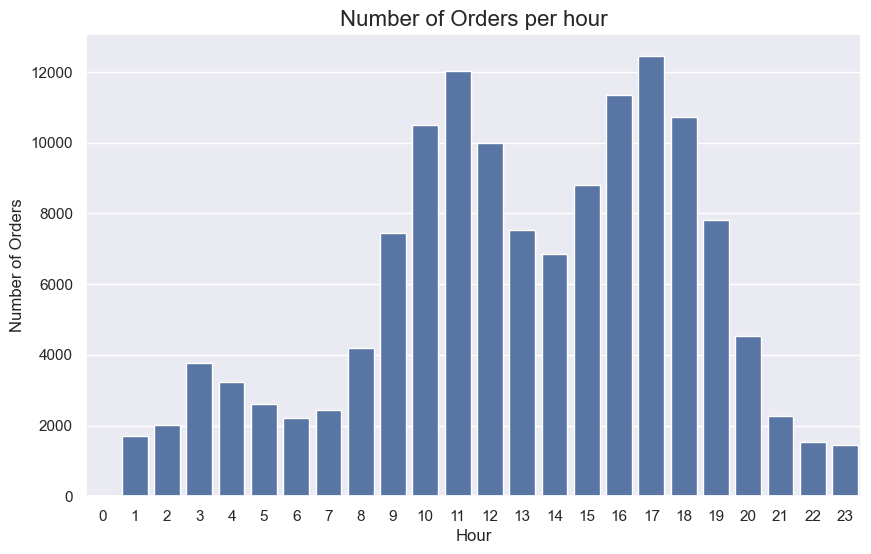

In [117]:
# Sum the values for each day of the week
hr_plot = df[hr_columns].sum()

# Create a new DataFrame for visualization
hr_counts = pd.DataFrame({
    'Hour': hr_values,
    'Number of Orders': hr_plot.values
})

# Create a count plot (using barplot here since we already have aggregated data)
plt.figure(figsize=(10, 6))
sns.barplot(x='Hour', y='Number of Orders', data=hr_counts)

# Set the title and labels
plt.title('Number of Orders per hour', fontsize=16)
plt.xlabel('Hour', fontsize=12)
plt.ylabel('Number of Orders', fontsize=12)
#plt.xticks(rotation=90)  # Rotate x-tick labels if needed

# Show the plot
plt.show()


### how to shape of frequency changes per day 
#### podzielic to na pory dsnia  

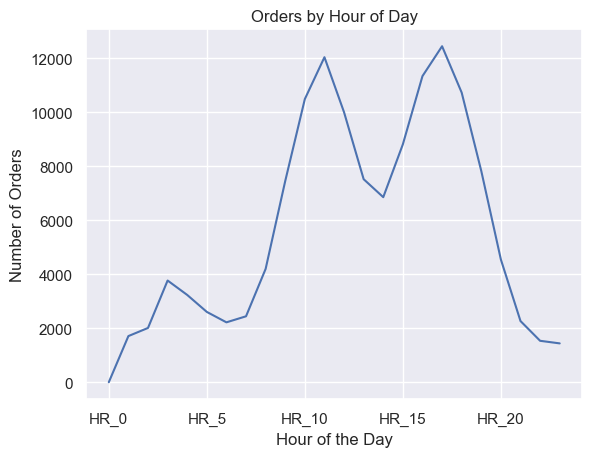

In [118]:
# Plot showing how cutomers buy during a day in different hours 
df[hr_columns].sum().plot()

plt.title('Orders by Hour of Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Orders')
plt.show()


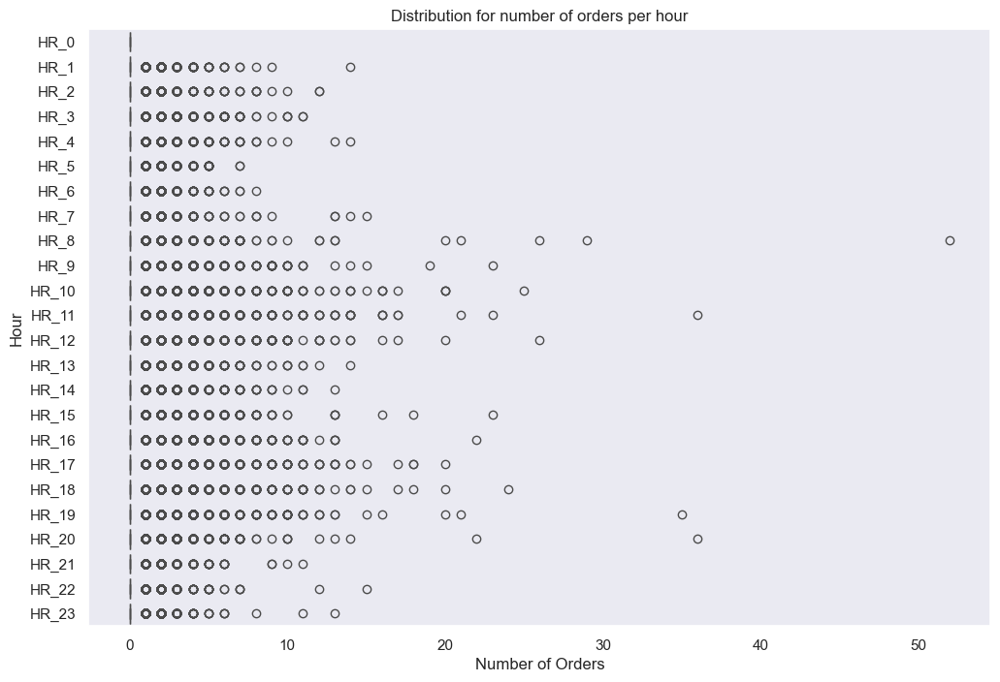

In [119]:
df_melted = df.melt(value_vars=hr_columns, var_name='Hour', value_name='Number of Orders')

# Create a transposed box plot
plt.figure(figsize=(12, 8))
sns.boxplot(y='Hour', x='Number of Orders', data=df_melted)

plt.title('Distribution for number of orders per hour')
plt.grid(axis='x') 
# plt.xticks(rotation=90) 
plt.show()



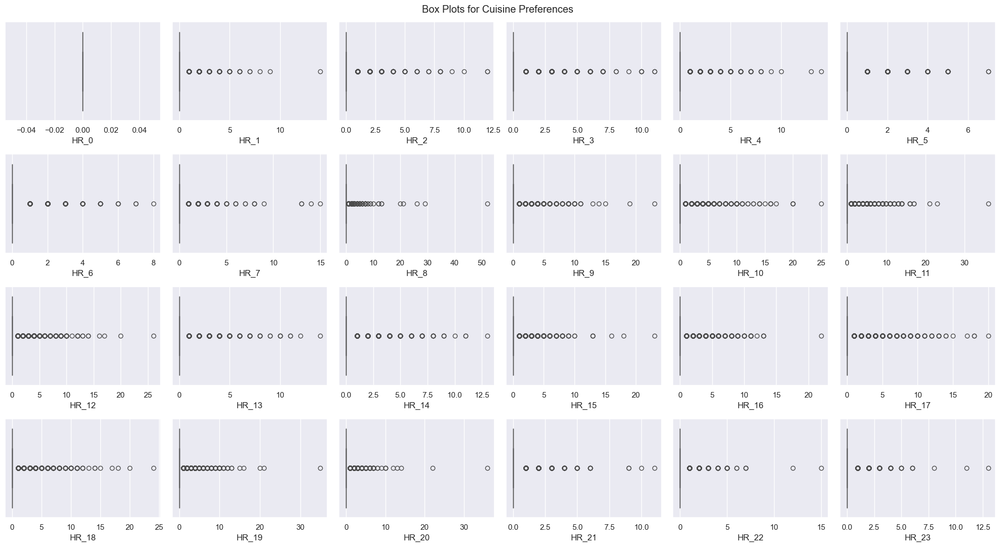

In [120]:
# Plot ALL Numeric Variables' Histograms in one figure

sns.set() ## Reset to darkgrid

## What do these do?
sp_rows = 4
sp_cols = math.ceil(len(hr_columns) / sp_rows)


# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(20, 11),
                         tight_layout=True
                        )

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), df[hr_columns]): # Notice the zip() function and flatten() method
    sns.boxplot(x=df[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Box Plots for Cuisine Preferences"

plt.suptitle(title)

# if not os.path.exists(os.path.join('..', 'figures', 'eda')):
#     # if the eda directory is not present then create it first
#     os.makedirs(os.path.join('..', 'figures', 'eda'))


# plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_variables_boxplots.png'), dpi=200)


plt.show()

In [121]:
outliers_info = {}

for column in hr_columns:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    
    low_outlier = df[column] < (Q1 - 1.5 * IQR)
    high_outlier = df[column] > (Q3 + 1.5 * IQR)
    outliers = df[low_outlier | high_outlier]
   
    num_outliers = outliers.shape[0]
    total_values = df[column].shape[0]
    
    percentage_share = round((num_outliers / total_values) * 100,2) 
    
   
    outliers_info[column] = {
        'Count of Outliers': num_outliers,
        'Percentage Share of Outliers': percentage_share
    }


#Create a DataFrame from the dictionary
outliers_df = pd.DataFrame(outliers_info).T  # Transpose to get cuisines as rows not columns
outliers_df.reset_index(inplace=True)
outliers_df.rename(columns={'index': 'Hour'}, inplace=True)
outliers_df = outliers_df.sort_values(by='Count of Outliers', ascending=False)

print(outliers_df)

     Hour  Count of Outliers  Percentage Share of Outliers
17  HR_17             7600.0                         23.88
11  HR_11             7522.0                         23.63
16  HR_16             7128.0                         22.40
18  HR_18             6680.0                         20.99
10  HR_10             6589.0                         20.70
12  HR_12             6486.0                         20.38
15  HR_15             6025.0                         18.93
13  HR_13             5446.0                         17.11
14  HR_14             5095.0                         16.01
9    HR_9             4922.0                         15.46
19  HR_19             4886.0                         15.35
20  HR_20             3059.0                          9.61
8    HR_8             2948.0                          9.26
3    HR_3             2520.0                          7.92
4    HR_4             2362.0                          7.42
5    HR_5             2021.0                          6.

---

### **`Mariana Variables`**

---

<div class="alert alert-block alert-info" style="font-size:16px" id = "analyzing_nan_values">

## 3. Analyzing NaN values

### Types of NaN values

- MCAR (Missing Completely at Random): Missing data is independent of observed or unobserved variables, and its absence is purely random, causing no bias.

- MAR (Missing at Random): The likelihood of missing data depends on observed data but not on the missing data itself, leading to potential bias if not handled properly.

- MNAR (Missing Not at Random): The probability of missing data depends on the unobserved values, making it difficult to address without introducing bias.

In [122]:
df_nan = df.copy()

### **`HR_0`**
#### - Using DOW_0 to DOW_6 vs HR_0 to HR_23 to determine total num of orders

### Notes
- We are formulating the hypothesis that the total num of orders calculated by summing all the values from DOW_0 to DOW_6 and from HR_0 to HR_23 must be the same.
- From all the features, only HR_0 has NaN values, maning that if there is a discrepancy they might be the cause of it
- We expect the total_orders calculated with DOW to be higher than the total_orders calculated using HR. If this happens, than it further verifies that we can input the HR_0 NaN values in the following way:
    - HR_0 NaN value client = total_orders_Dow for client - total_orders_HR for client

In [123]:
"""Remove warnings"""
warnings.simplefilter(action='ignore', category=pd.errors.SettingWithCopyWarning)

columns = [element for element in df.columns if "DOW" in str(element) or "HR" in str(element)]
df_HR_DOW = df[columns]

columns_to_sum = [f'DOW_{i}' for i in range(7)]
df_HR_DOW.insert(7, "total_orders_DOW", df[columns_to_sum].sum(axis=1) )

columns_to_sum = [f'HR_{i}' for i in range(24)]
df_HR_DOW["total_orders_HR"] = df[columns_to_sum].sum(axis=1).astype(int)
df_HR_DOW

total_ord_diff = df_HR_DOW.loc[df_HR_DOW["total_orders_DOW"] != df_HR_DOW["total_orders_HR"] ]
total_is_dif_HR_is_NaN = df_HR_DOW.loc[ (df_HR_DOW["total_orders_DOW"] != df_HR_DOW["total_orders_HR"]) & (df_HR_DOW["HR_0"].isnull()) & (df_HR_DOW["total_orders_HR"] < df_HR_DOW["total_orders_DOW"]) ]


if total_is_dif_HR_is_NaN.shape[0] == total_ord_diff.shape[0]:
    print("All the clients whose total number of observations is different when summing all DOW's or HR's are also the ones with NaN values for HR_0 and the total value is always higher in total DOW than HR\n")
    print("This means we can input the values")

#making copy of the column to then input the values
df_HR_DOW.insert(9, "HR_0_corrected", df_HR_DOW["HR_0"])
#Correct values to input HR_0 NaN
values_HR_0_corrected = total_ord_diff["total_orders_DOW"] - total_ord_diff["total_orders_HR"]
df_HR_DOW.fillna({"HR_0_corrected": values_HR_0_corrected}, inplace=True)
df_HR_DOW

All the clients whose total number of observations is different when summing all DOW's or HR's are also the ones with NaN values for HR_0 and the total value is always higher in total DOW than HR

This means we can input the values


,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,total_orders_DOW,HR_0,HR_0_corrected,...,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,total_orders_HR
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,1,0,0,0,0,0,1,2,0.0,0.0,...,0,0,0,2,0,0,0,0,0,2
5d272b9dcb,1,0,0,0,0,0,1,2,0.0,0.0,...,0,0,0,0,0,0,0,0,0,2
f6d1b2ba63,1,0,0,0,0,0,1,2,0.0,0.0,...,0,0,0,0,0,0,0,0,0,2
180c632ed8,0,1,0,0,0,0,1,2,0.0,0.0,...,0,0,0,0,0,0,0,0,0,2
4eb37a6705,0,1,0,0,0,0,1,2,0.0,0.0,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0,0,0,0,0,0,1,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,1
f6b6709018,0,0,0,0,0,0,1,1,0.0,0.0,...,0,1,0,0,0,0,0,0,0,1
f74ad8ce3f,0,0,0,0,0,0,1,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,1


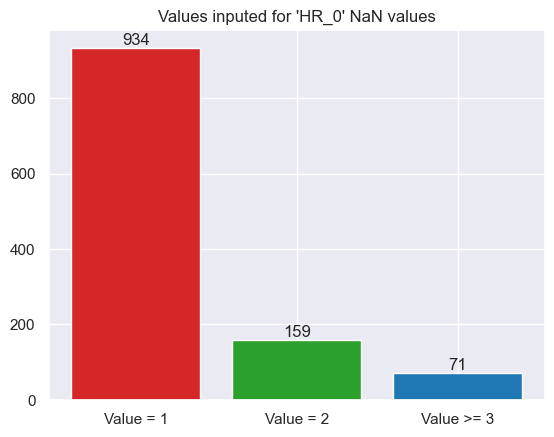

Total values inputed 1164
Number of HR_0 NaN values: 1164


In [124]:
"""Bar plot"""
HR_0_input_values = df_HR_DOW.loc[df_HR_DOW["HR_0"].isna(), "HR_0_corrected"]
values_1_inputed = HR_0_input_values.loc[HR_0_input_values == 1].count()
values_2_inputed = HR_0_input_values.loc[HR_0_input_values == 2].count()
values_3_inputed = HR_0_input_values.loc[HR_0_input_values >= 3].count()

y_values = [values_1_inputed, values_2_inputed, values_3_inputed]

x_values = ["Value = 1", "Value = 2", "Value >= 3"]
fig, ax = plt.subplots()
bar_color = ["tab:red", "tab:green", "tab:blue"]
p = ax.bar(x_values, y_values, color= bar_color)
ax.bar_label(p, labels= [str(element) for element in y_values])
ax.set_title("Values inputed for 'HR_0' NaN values")
plt.show()

HR_0_Nan = df["HR_0"].isnull().sum()
print(f"Total values inputed {values_1_inputed+values_2_inputed+values_3_inputed}")
print(f"Number of HR_0 NaN values: {HR_0_Nan}") 


<div class="alert alert-block alert-warning">
<b style="font-size: 2em">Note:</b> Now we need to check wheter the total number of orders made by all clients is equal using DOW and HR variables after inputting the 'HR_0' NaN values.

</div>



In [125]:
#Insert corrected column
df_nan.insert(34, "HR_0_corrected", df_nan["HR_0"])

# Determine correct values to input NaN HR_0 and replace them in the corrected column
df_nan.fillna({"HR_0_corrected": values_HR_0_corrected}, inplace=True)

In [126]:
columns_HR = [element for element in df_nan.columns if "HR" in str(element)]
columns_HR.remove("HR_0")
columns_DOW = [element for element in df_nan.columns if "DOW" in str(element)]

HR_total_orders_dataset = int(df_nan[columns_HR].sum().sum())
DOW_total_orders_dataset = int(df_nan[columns_DOW].sum().sum())

print(f"{columns_HR} \n")
print(f"Total number of orders of all clients using HR (used HR_0 instead of HR) is: {HR_total_orders_dataset:,}")
print(f"Total number of orders of all clients using DOW is: {DOW_total_orders_dataset:,}")


['HR_1', 'HR_0_corrected', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23'] 

Total number of orders of all clients using HR (used HR_0 instead of HR) is: 139,054
Total number of orders of all clients using DOW is: 139,054


In [127]:
"""Drop HR_0 column (doing it on purpose on isolated cell)"""
df_nan.drop(columns="HR_0", inplace=True)

In [128]:
"""Rename HR_0_corrected column to HR_0"""
df_nan.rename(columns={"HR_0_corrected": "HR_0"}, inplace= True)

In [129]:
df_nan.columns

Index(['customer_region', 'city', 'customer_age', 'vendor_count',
       'product_count', 'is_chain', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American', 'CUI_Asian', 'CUI_Beverages',
       'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts',
       'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese',
       'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks',
       'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5',
       'DOW_6', 'HR_1', 'HR_0', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7',
       'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15',
       'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23',
       'payment_method_combined'],
      dtype='object')

---

### **`first_order`**

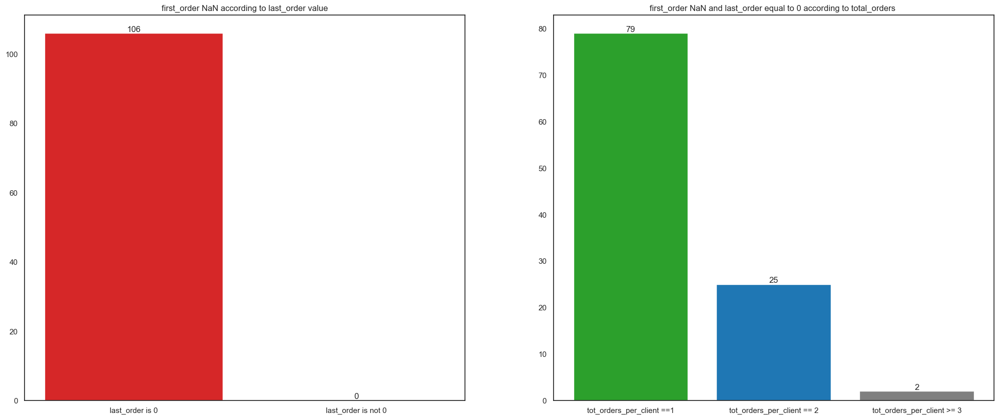

In [130]:
"""Bar plot"""
sns.set_style("white")
fig, ax = plt.subplots(1,2, figsize=(25, 10))

y_values = [df_nan.loc[(df_nan["first_order"].isnull()) & (df_nan["last_order"] == 0)].shape[0], df_nan.loc[(df_nan["first_order"].isnull()) & (df_nan["last_order"] != 0)].shape[0], ]
x_values = ['last_order is 0', 'last_order is not 0']
bar_color = ["tab:red", "tab:grey"]
p2 = ax[0].bar(x_values, y_values, color= bar_color)
ax[0].bar_label(p2, labels= [str(element) for element in y_values])
ax[0].set_title("first_order NaN according to last_order value")



y_values = [df_nan.loc[ (df_nan["first_order"].isnull()) & (df_nan["last_order"] == 0) & (df_nan["product_count"] == 1)].shape[0], 
            df_nan.loc[ (df_nan["first_order"].isnull()) & (df_nan["last_order"] == 0) & (df_nan["product_count"] == 2)].shape[0],
            df_nan.loc[ (df_nan["first_order"].isnull()) & (df_nan["last_order"] == 0) & (df_nan["product_count"] >= 3)].shape[0],
            ]
x_values = ["tot_orders_per_client ==1", "tot_orders_per_client == 2", "tot_orders_per_client >= 3"]
bar_color = ["tab:green", "tab:blue", "tab:grey"]
p1 = ax[1].bar(x_values, y_values, color= bar_color)
ax[1].bar_label(p1, labels= [str(element) for element in y_values])
ax[1].set_title("first_order NaN and last_order equal to 0 according to total_orders ")

plt.show()



<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`HR_0`**
1. All the NaN values present in HR_0 can be determined 
2. For each client, the 'HR_0' NaN value corresponds to the difference between the client's total number of orders using 'DOW' and total number of orders using 'HR'
3. After creating the column 'HR_0_corrected' where all the NaN values where substitued by their correct values, we can see that the total number of orders in the dataset using the HR variables or the DOW variables is the same

### Key notes **`first_order`**
1. The first_order missing values correpond to clients where:
    - the last order was made in the first day of the first month.
    - their total orders was bigger than 0
2. Considering a total period of 3 months, from the total clients with first_order missing values (106):
    - 79 clients made a single order
    - 25 clients made 2 orders
    - 2 clients made more than 3 orders

3. If all the missing values correspond to clients with 'last_order' equal to 0 and total_orders bigger than 0, then it's safe to assume that during the 3 months clients made all their order/s 
in the first day of the first month. Then we should input these NaN values with the value 0


### **`General notes`**
1. Replaced HR_0 with HR_0_corrected (dropped HR_0 and renamed HR_0_corrected to HR_0)


In [131]:
df_nan.columns

Index(['customer_region', 'city', 'customer_age', 'vendor_count',
       'product_count', 'is_chain', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American', 'CUI_Asian', 'CUI_Beverages',
       'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts',
       'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese',
       'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks',
       'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5',
       'DOW_6', 'HR_1', 'HR_0', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7',
       'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15',
       'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23',
       'payment_method_combined'],
      dtype='object')

---

<div class="alert alert-block alert-info" style="font-size:16px" id = "analyzing_outlier_values">

## 4. Analyzing outlier values

### 1. Types of outliers going to be analyzed

1. Univariate outliers
2. Bivariate outliers

### Different ways to deal with Outliers

1. Numerical features
- Remove based on visual threshold 
- Change value to approximate outliers to the other less extreme values
- Keep all of them them 

2. Categorical features
- Drop them
- aggregate them into class called 'Other'

### Maximum number of outliers to remove
1. As a rule of thumb, try not to remove more than 5% of your rows. 
2. However, it might be necessary to remove more.

In [132]:
df_outliers = df.copy()

## **Univariate outliers**

### **`customer_age, vendor_count, product_count, is_chain, first_order and last_order`**

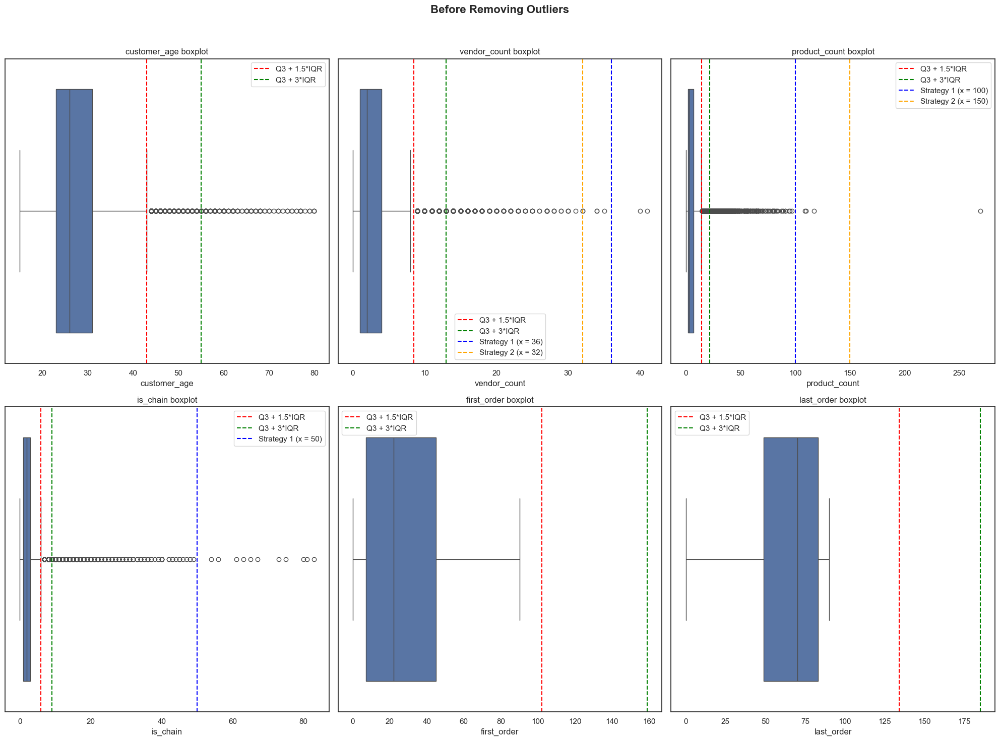

In [133]:
sns.set_style("white")

columns = ['customer_age', 'vendor_count', 'product_count', 'is_chain', 'first_order', 'last_order']

fig, axes = plt.subplots(2, 3, figsize=(20, 15))

# Loop through each feature and plot boxplots with vertical lines for Q3 + 1.5*IQR and Q3 + 3*IQR
for i, feature in enumerate(columns):
    ax = axes[i // 3, i % 3]
    
    # Calculate Q1, Q3, and IQR
    q1 = df_outliers[feature].quantile(0.25)
    q3 = df_outliers[feature].quantile(0.75)
    iqr = q3 - q1
    
    # Plot the boxplot
    sns.boxplot(x=df_outliers[feature], ax=ax)
    
    # Draw vertical lines for Q3 + 1.5*IQR and Q3 + 3*IQR
    ax.axvline(x=q3 + 1.5 * iqr, color='red', linestyle='--', label='Q3 + 1.5*IQR')
    ax.axvline(x=q3 + 3 * iqr, color='green', linestyle='--', label='Q3 + 3*IQR')
    if feature == 'vendor_count':
        ax.axvline(x=36, color='blue', linestyle='--', label='Strategy 1 (x = 36)')
        ax.axvline(x=32, color='orange', linestyle='--', label='Strategy 2 (x = 32)')


    if feature == 'product_count':
        ax.axvline(x=100, color='blue', linestyle='--', label='Strategy 1 (x = 100)')
        ax.axvline(x=150, color='orange', linestyle='--', label='Strategy 2 (x = 150)')


    if feature == 'is_chain':
        ax.axvline(x=50, color='blue', linestyle='--', label='Strategy 1 (x = 50)')
    
    # Set titles
    ax.set_title(f"{feature} boxplot")
    ax.legend()

# Adding overall title
plt.suptitle("Before Removing Outliers", fontsize=16, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [134]:
"""How many outliers we can remove following the 5% thumb rule"""
int(df_outliers.shape[0]*0.05)


1591

In [135]:
num_outliers = 0
for variable in columns:
    outlier_detection(df_outliers, variable)


customer_age: 
Number of extreme outliers: 159 (12%) 
Number of moderate outliers: 1083 (87%) 
Total number of outliers: 1242
Q3 + 1.5*IQR = 35.0 
Q3 + 3*IQR = 47.0
Max: 80.0 
Min: 15.0 

vendor_count: 
Number of extreme outliers: 369 (19%) 
Number of moderate outliers: 1519 (80%) 
Total number of outliers: 1888
Q3 + 1.5*IQR = 5.5 
Q3 + 3*IQR = 10.0
Max: 41 
Min: 0 

product_count: 
Number of extreme outliers: 932 (28%) 
Number of moderate outliers: 2366 (71%) 
Total number of outliers: 3298
Q3 + 1.5*IQR = 9.5 
Q3 + 3*IQR = 17.0
Max: 269 
Min: 0 

is_chain: 
Number of extreme outliers: 1601 (33%) 
Number of moderate outliers: 3148 (66%) 
Total number of outliers: 4749
Q3 + 1.5*IQR = 4.0 
Q3 + 3*IQR = 7.0
Max: 83 
Min: 0 

first_order: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 0 (%) 
Total number of outliers: 0
Q3 + 1.5*IQR = 64.0 
Q3 + 3*IQR = 121
Max: 90 
Min: 0 

last_order: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 0 (%) 
Total number of

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`General`**
1. The number of outliers in the following group of features represent a total of 35% of total rows

### Key notes **`Customer Age`**
1. From total outliers (1242), 159 are 'moderate' outliers and 1083 are 'extreme' outliers 
2. Visually, all outliers seem to be 'connected' with each other. Since we can't leverage an existing 'visual' gap, we could choose one of the following strategies:
    - Remove only extreme outliers. 
        - We would remove observations where the client has an age bigger than 47
        - This option could make sense since we would only drop 159 observations while reducing the skewness in the data by just keeping the moderate outliers

    - Remove all outliers (both moderate and extreme outliers)
        - We would end up removing all clients with age bigger than 35 years old. 
        - It deosn't seem to be statistically responsible to do so. We would end up removing a lot of observations

    - Scale down the more extreme values
        - We could scale down the extreme values to the highest moderate value. 
        - This way we wouldn't lose potential informative data


### Key notes **`Vendor count`**
1. From total outliers (1888), 1519 are 'moderate' outliers and 369 are 'extreme' outliers 
2. We can use one of the following strategies to deal with the outliers
    - Considering the existing 'visual gap', we could remove all the values where the 'vendor_count' is bigger than 36 (blue dotted line)
    - Considering the 5% rule and to avoid reducing number of observations, we could scale down all the values bigger or equal to 32 to being equal to 32


### Key notes **`Product count`**
1. From total outliers (3298), 2366 are 'moderate' outliers and 932 are 'extreme' outliers 
2. We can use the following strategy to deal with the outliers
    - Considering the existing 'visual gap' and trying to respect the 5% rule we could do the following:
        1. Remove the very extreme outliers (product_count > 150)
        2. Scale down all product_count values bigger or equal to 100 to 100 based on visual observation


### Key notes **`Is chain`**
1. From total outliers (4749), 3148 are 'moderate' outliers and 1601 are 'extreme' outliers 
2. From the features evaluated so far, it represents the feature with the highest number of outliers
2. We can use the following strategy to deal with the outliers
    - Scale down all 'is_chain' values bigger or equal to 50 to value equal to 50
    - Selected the value 50 due to visual reasons (extreme outliers after 50 seem to be more sparsed). 
    - By defining this threshold, we will respect the origianl as best as possible the original feature distribution distribution while avoiding removing observations


### Key notes **`First order and Last order`**

1. No presence of outliers











---

### **`Cui variables`**

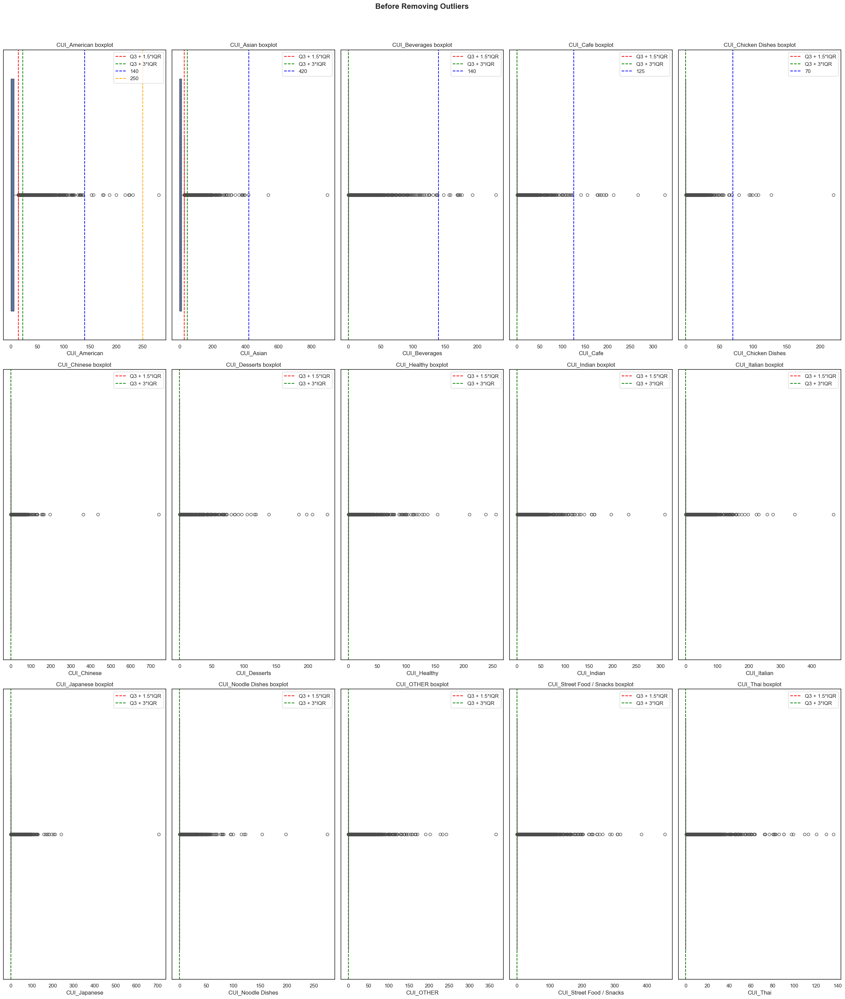

In [136]:
sns.set_style("white")

columns = [element for element in df_outliers.columns if 'CUI' in str(element)]

fig, axes = plt.subplots(3, 5, figsize=(25, 30))

# Loop through each feature and plot boxplots with vertical lines for Q3 + 1.5*IQR and Q3 + 3*IQR
for i, feature in enumerate(columns):
    ax = axes[i // 5, i % 5]
    
    # Calculate Q1, Q3, and IQR
    q1 = df_outliers[feature].quantile(0.25)
    q3 = df_outliers[feature].quantile(0.75)
    iqr = q3 - q1
    
    # Plot the boxplot
    sns.boxplot(x=df_outliers[feature], ax=ax)
    
    # Draw vertical lines for Q3 + 1.5*IQR and Q3 + 3*IQR
    ax.axvline(x=q3 + 1.5 * iqr, color='red', linestyle='--', label='Q3 + 1.5*IQR')
    ax.axvline(x=q3 + 3 * iqr, color='green', linestyle='--', label='Q3 + 3*IQR')

    if 'American' in feature:
        ax.axvline(x=140, color='blue', linestyle='--', label='140')
        ax.axvline(x=250, color='orange', linestyle='--', label='250')

    if 'Asian' in feature:
        ax.axvline(x=420, color='blue', linestyle='--', label='420')

    if 'Beverages' in feature:
        ax.axvline(x=140, color='blue', linestyle='--', label='140')

    if 'Cafe' in feature:
        ax.axvline(x=125, color='blue', linestyle='--', label='125')


    if 'Chicken' in feature:
        ax.axvline(x=70, color='blue', linestyle='--', label='70')
        

    
    # Set titles
    ax.set_title(f"{feature} boxplot")
    ax.legend()

# Adding overall title
plt.suptitle("Before Removing Outliers", fontsize=16, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [137]:
for variable in columns:
    outlier_detection(df_outliers, variable)


CUI_American: 
Number of extreme outliers: 1967 (35%) 
Number of moderate outliers: 3502 (64%) 
Total number of outliers: 5469
Q3 + 1.5*IQR = 8.49 
Q3 + 3*IQR = 16.98
Max: 280.21 
Min: 0.0 

CUI_Asian: 
Number of extreme outliers: 1795 (34%) 
Number of moderate outliers: 3470 (65%) 
Total number of outliers: 5265
Q3 + 1.5*IQR = 17.745 
Q3 + 3*IQR = 35.49
Max: 896.71 
Min: 0.0 

CUI_Beverages: 
Number of extreme outliers: 5423 (50%) 
Number of moderate outliers: 5423 (50%) 
Total number of outliers: 10846
Q3 + 1.5*IQR = 0.0 
Q3 + 3*IQR = 0.0
Max: 229.22 
Min: 0.0 

CUI_Cafe: 
Number of extreme outliers: 1363 (50%) 
Number of moderate outliers: 1363 (50%) 
Total number of outliers: 2726
Q3 + 1.5*IQR = 0.0 
Q3 + 3*IQR = 0.0
Max: 326.1 
Min: 0.0 

CUI_Chicken Dishes: 
Number of extreme outliers: 3246 (50%) 
Number of moderate outliers: 3246 (50%) 
Total number of outliers: 6492
Q3 + 1.5*IQR = 0.0 
Q3 + 3*IQR = 0.0
Max: 219.66 
Min: 0.0 

CUI_Chinese: 
Number of extreme outliers: 3518 (50%)

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`General`**
1. The number of outliers for all CUI features is very high since the most values tend be close or equal to 0
2. With exception of 'CUI_America' and 'CUI_Asia', the extreme (Q3 + 3*IQR) and moderate outliers (Q3 + 1.5*IQR) thresholds are always zero.

### Key notes **`CUI_America`**
1. From total outliers (5469), 3502 are 'moderate' outliers and 1967 are 'extreme' outliers 
2. We can use the following strategy to deal with the outliers
    - Remove outliers with values higher than 250
    - Scale down all 'CUI_America' values bigger or equal to 140 to value equal to 140
    - Selected the value 140 due to visual reasons (extreme outliers after 140 seem to be more sparsed). 
    - By defining this threshold, we will respect the origianl as best as possible the original feature distribution distribution while avoiding removing observations



###  **`DO the same do all the others`**











---

## **Bivariate outliers**

> To determine the multidimension outliers we will use **Mahalanobis distance**.

#### **Mahalanobis distance**

Represents a statistical measure that determines how far away a datapoint is from the mean of a multivariate distribution taking into account correlations between variables. 

<img src="/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/figures/Mahalanobis distance.png" alt="Mahalanobis distance formula"
width="400">

- S: semi-definite covariance matrix
- x_vector: multivariate data point
- mu_vector: multivariate mean

#### **Determining outliers using the Mahalanobis distance**

Since the Mahalanobis distance determines how much a data point deviates from the centre distribution, we can determine outliers following the steps below:
1. Compute the Mahalanobis distance for the features we are interested on evaluating the presence of multivariate outliers
2. Define threshold where all the points that have a Mahalanobis distance above it will be classified as outliers. To do this, we can either rely on statistical tests like the Chi-square or we can also plot the mahalanabois distances before hand and determine the threshold visually in order to minimize total number of outliers identified
3. After flagging the identified outliers we simply have to plot them in order to visually see them


In [138]:
def mahalanobis_distance (data = None):
    #x: dataset we are wroking with
    #data: ndarray of the dataset from which we want to compute the mahalanobis distance
    data = data.astype(float)
    x_minus_mu = data -np.mean(data)
    cov = np.cov(data.values.T)
    inv_covmat = scipy.linalg.inv(cov)
    left_term = np.dot(x_minus_mu, inv_covmat)
    mahal = np.dot(left_term, x_minus_mu.T)
    return np.sqrt(mahal.diagonal())



def flag_outliers(df, mahal, threshold):
    
    # Identify outliers
    outlier = []
    for index, value in enumerate(mahal):
        if value > threshold:
            outlier.append(index)
        else:
            continue

    # Create the flag
    flag = []
    for index in range(df.shape[0]):
        if index in outliers:
            flag.append(1)
        else:
            flag.append(0)
    return flag, outlier



In [139]:
"""Creating new dataframe withotu NaN values since the mahalanobis distance doesn't work with NaN values"""
df_outliers_na = df_outliers.copy()
df_outliers_na.dropna(inplace=True)

[('customer_age', 'vendor_count'), ('customer_age', 'product_count'), ('customer_age', 'is_chain'), ('customer_age', 'first_order'), ('customer_age', 'last_order'), ('vendor_count', 'product_count'), ('vendor_count', 'is_chain'), ('vendor_count', 'first_order'), ('vendor_count', 'last_order'), ('product_count', 'is_chain'), ('product_count', 'first_order'), ('product_count', 'last_order'), ('is_chain', 'first_order'), ('is_chain', 'last_order'), ('first_order', 'last_order')]


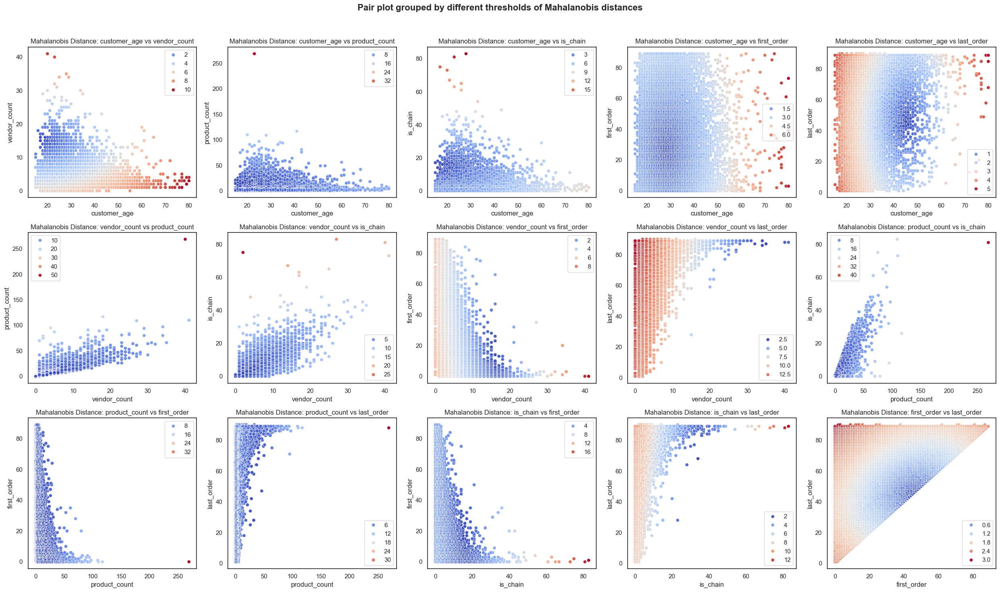

In [140]:
sns.set_style("white")

columns = ['customer_age', 'vendor_count', 'product_count', 'is_chain', 'first_order', 'last_order']
#columns = ['customer_age', 'vendor_count', 'product_count', 'is_chain']
df_g1 = df_outliers_na[columns]

combinations = list(itertools.combinations(columns, 2))
print(combinations)


fig, axes = plt.subplots(3, 5, figsize=(25, 15))

# Loop through each feature and plot boxplots with vertical lines for Q3 + 1.5*IQR and Q3 + 3*IQR
for i, (feat1, feat2) in enumerate(combinations):
    ax = axes[i // 5, i % 5]
    
    # Calculate Mahalanobis distance for each pair of features
    df_g1['mahala'] = mahalanobis_distance(df_g1[[feat1, feat2]])
    
    # Plot Mahalanobis distances
    sns.scatterplot(x=df_g1[feat1], y=df_g1[feat2], hue=df_g1['mahala'], ax=ax, palette="coolwarm")
    
    # Set titles
    ax.set_title(f"Mahalanobis Distance: {feat1} vs {feat2}")
    ax.legend()

# Adding overall title
plt.suptitle("Pair plot grouped by different thresholds of Mahalanobis distances", fontsize=16, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`General`**
1. As we can see above, each pair plot is being grouped by different thresholds of Mahalanobis distances.
2. The higher the threshold (warmer colors), the less outliers will be identified usign the mahalanobis distance 

### Key notes **`Removal criteria`**
1. For each pair plots with the exception of the ones below, we could start by removing the very extreme outliers represented by the red color.
- first_order with last_order
- vendor_count with last_order 
- customer_age with last_order


### Key notes **`Exception pairs criteria`**
1. The pair plots mentioned above were refered as an exception since each pair has a higher amount of red colour outliers identified. 
2. We would need to proceed with caution in order to avoid removing importat observations from our dataset












---

<div class="alert alert-block alert-info" style="font-size:16px" id = "feature_engineering">

## 5. Feature engineering

In [141]:
"""Copying df_nan instead of df in order to have the HR_0 correct values. It would impact the creatiom of night_num_orders"""   
df_fe = df_nan.copy()

In [142]:
df_fe.loc[df_fe["first_order"] == -100]

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined
customer_id,,,,,,,,,,,,,,,,,,,,,


### **`Client_activity_flag`**

#### Defining 3 categories 
1. Inactive users (When the 'last_order' was made in the last month)
2. Active users (When the 'last_order' was made in the first 2 months)
3. One time customers (When the first_order == last_order)


In [143]:
warnings.simplefilter(action='ignore')

"""Tried creating the new feature without removing 'first_order' NaN values. IT DIDN'T WORK (will result in error) """
df_fe = df_fe.fillna({'first_order': -100})
conditions = [
    (df_fe['first_order'] == df_fe["last_order"] ) ,  # NaNs treated as distinct
    (df_fe['last_order'] >= 60),                
    (df_fe['last_order']< 60),       
]

choices = ['one_time_customer', 'active', 'inactive']

df_fe['client_activity_flag'] = np.select(conditions, choices, default='0')
df_fe["client_activity_flag"].loc[df_fe["first_order"] == -100] = np.nan
df_fe["first_order"].loc[df_fe["first_order"] == -100] = np.nan
df_fe['client_activity_flag'].unique()

array(['inactive', 'active', 'one_time_customer', nan], dtype=object)

In [144]:
"""Undestanding the statistical properties"""
print(df_fe["client_activity_flag"].describe(percentiles= np.arange(0.1,1,0.05)))
print("\n")
print(df_fe["client_activity_flag"].info())

count      31722
unique         3
top       active
freq       18160
Name: client_activity_flag, dtype: object


<class 'pandas.core.series.Series'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Series name: client_activity_flag
Non-Null Count  Dtype 
--------------  ----- 
31722 non-null  object
dtypes: object(1)
memory usage: 1.5+ MB
None


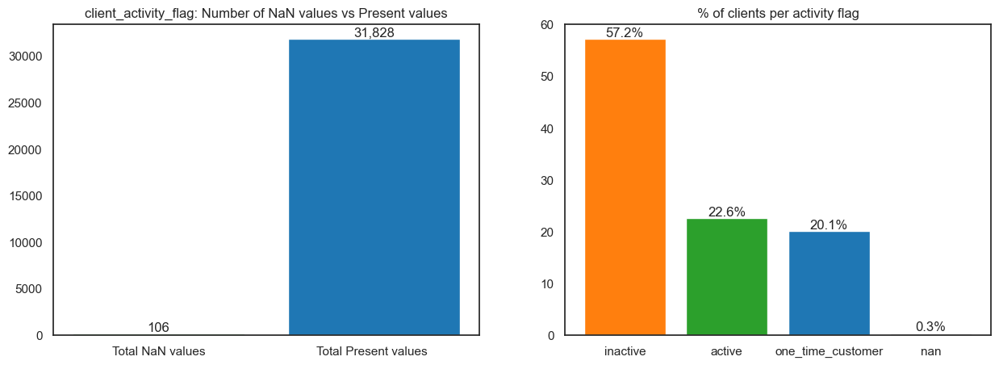

In [145]:
"""Number of NaN values vs Non missing values"""
total_elements = len(df_fe["client_activity_flag"])
caf_perc_na_values = df_fe["client_activity_flag"].isna().sum()
caf_per_present_values = total_elements- fo_perc_na_values

fig, ax = plt.subplots(1,2, figsize = (15,5))
x_values = ["Total NaN values", "Total Present values "]
bar_colours = ["tab:green", "tab:blue"]

y_values = [caf_perc_na_values, caf_per_present_values]
p = ax[0].bar(x_values, y_values, color=bar_colours)
ax[0].bar_label(p, labels= [f"{element:,}" for element in y_values])
ax[0].set_title("client_activity_flag: Number of NaN values vs Present values")


"""Bar plot"""
x_values = ['inactive', 'active', 'one_time_customer', "nan"]
y_values = list(df_fe["client_activity_flag"].value_counts())
y_values.append(df_fe["client_activity_flag"].isnull().sum())

total_elements = df_fe["client_activity_flag"].count()
y_values = [round((element/total_elements)*100,1) for element in y_values]

bar_color = ["tab:orange", "tab:green", "tab:blue", "tab:grey"]
p = ax[1].bar(x_values, y_values, color= bar_color)
ax[1].bar_label(p, labels= [str(element) + "%" for element in y_values])
ax[1].set_title("% of clients per activity flag")


plt.show()


<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`client_activity_flag`**
1. Represents a categorical feature build mostly using first_order and last_order features
2. All clients where 'first_order' is NaN (106) also have 'client_activity_flag'has an NaN value
3. The majority of our clients (57%) are inactive clients


---

### **`Total_orders_per_client`**

#### How did we create the feature?
1. The DOW variables represent how many orders each client made per day of the week throughout the 3 months
2. Since these variables don't have any nan values, to obtain the total orders made per client, we just need to sum these values row wise

In [146]:
columns_to_sum = [f'DOW_{i}' for i in range(7)]
df_fe["tot_orders_per_client"] = df_fe[columns_to_sum].sum(axis=1).astype(int)

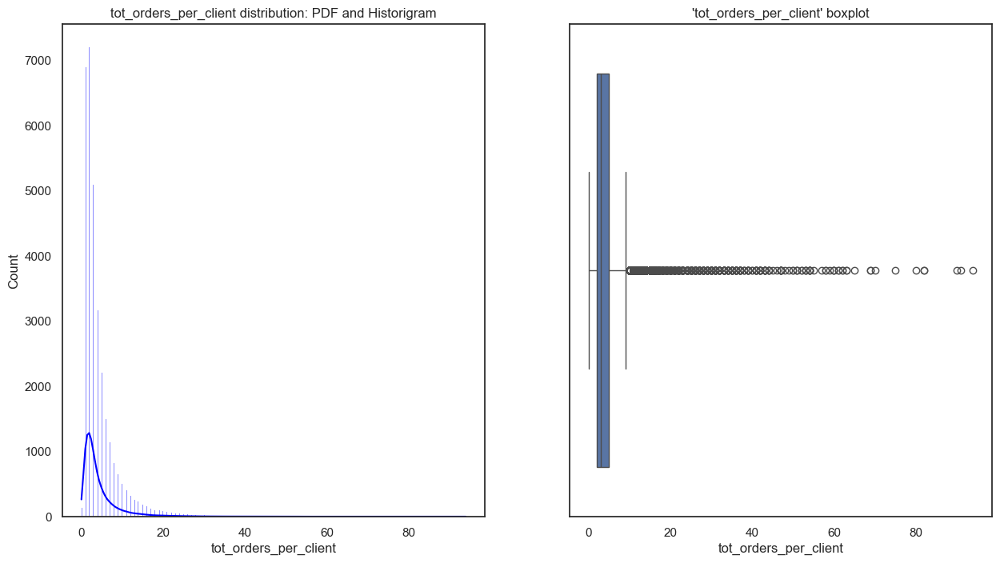

In [147]:
"""Histogram and boxplot using the Freedman - Diaconis rule mentioned above"""
Q1,Q3 = np.nanpercentile(df_fe["tot_orders_per_client"], [25, 75])
IQR = Q3-Q1
fd_bin_width = (2*IQR)/len(df_fe["tot_orders_per_client"])**(1/3)
df_optimal_num_bins = int((max(df_fe["tot_orders_per_client"])-min(df_fe["tot_orders_per_client"]))/fd_bin_width)

fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_fe["tot_orders_per_client"], kde=True, color="blue", bins=df_optimal_num_bins, ax=axes[0])
axes[0].set_title("tot_orders_per_client distribution: PDF and Historigram")

sns.boxplot(x = df_fe["tot_orders_per_client"], ax=axes[1])
axes[1].set_title("'tot_orders_per_client' boxplot")
plt.show()

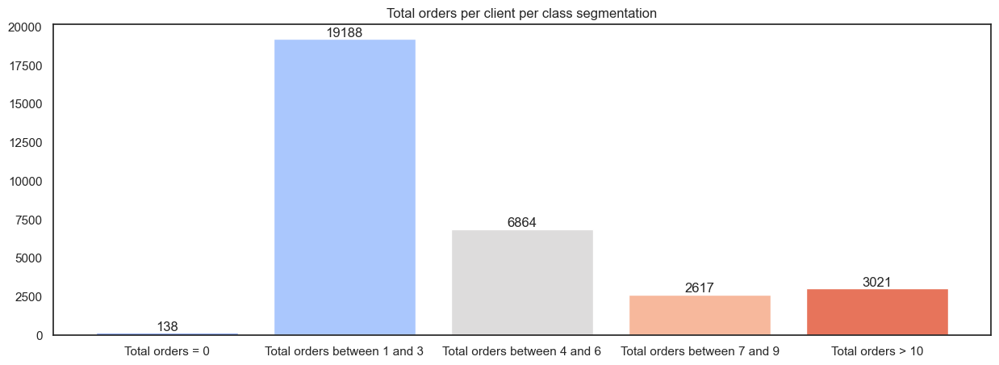

In [148]:
"""Total orders per client class segmentation """

tot_orders_0 = df_fe.loc[df_fe["tot_orders_per_client"] == 0].shape[0]
tot_orders_1_3 = df_fe.loc[(df_fe["tot_orders_per_client"] >= 1) & (df_fe["tot_orders_per_client"] <=3)].shape[0]
tot_orders_4_6 = df_fe.loc[(df_fe["tot_orders_per_client"] >=4) & (df_fe["tot_orders_per_client"] <=6)].shape[0]
tot_orders_7_9 = df_fe.loc[(df_fe["tot_orders_per_client"] >=7) & (df_fe["tot_orders_per_client"] <=9)].shape[0]
tot_orders_10 = df_fe.loc[df_fe["tot_orders_per_client"] >=10].shape[0]

total_elements = df_fe.shape[0]

fig, ax = plt.subplots(1,1, figsize = (15,5))
y_values= [tot_orders_0, tot_orders_1_3, tot_orders_4_6, tot_orders_7_9, tot_orders_10]
x_values = ["Total orders = 0", "Total orders between 1 and 3", "Total orders between 4 and 6", "Total orders between 7 and 9", "Total orders > 10" ]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element}" for element in y_values])
ax.set_title("Total orders per client per class segmentation")
plt.show()

In [149]:
"""Some clients have 0 total orders if we sum the DOW variables"""

HR_columns = [element for element in df_fe.columns if 'HR' in str(element)]
strange_clients_df = df_fe.loc[(df_fe["tot_orders_per_client"]==0) & ( (df_fe["product_count"]!=0) | (df_fe["is_chain"]!=0) | (df_fe["first_order"]!=0)| (df_fe["last_order"]!=0) )]
tot_orders_0= df_fe.loc[(df_fe["tot_orders_per_client"]==0)].shape[0]
strange_clients_df

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,client_activity_flag,tot_orders_per_client
customer_id,,,,,,,,,,,,,,,,,,,,,
4903041977,8670,City 8,22.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,0,0,Online,one_time_customer,0
c94b288475,8670,City 8,26.0,0,0,0,1,1,DELIVERY,CASH,...,0,0,0,0,0,0,0,In Person,one_time_customer,0
f687717dc1,8670,City 8,21.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,0,0,Online,one_time_customer,0
c6cf0b76fb,8670,City 8,38.0,0,0,0,2,2,DELIVERY,CASH,...,0,0,0,0,0,0,0,In Person,one_time_customer,0
1b7c34738e,8670,City 8,24.0,0,0,0,3,3,NO PROMO USED,CASH,...,0,0,0,0,0,0,0,In Person,one_time_customer,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,8670,City 8,30.0,0,0,1,86,86,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,Online,one_time_customer,0
0039059c9c,8670,City 8,22.0,0,0,1,88,88,DISCOUNT,CARD,...,0,0,0,0,0,0,0,In Person,one_time_customer,0
0e60632fe2,8670,City 8,23.0,0,0,0,89,89,DISCOUNT,CARD,...,0,0,0,0,0,0,0,In Person,one_time_customer,0


In [150]:
"""Number of NaN values"""
df_fe["tot_orders_per_client"].isnull().sum()

0

In [151]:
"""Let's try to undertand if we sum all the HR_variables if some of these clients have total orders different from 0"""
df_fe["tot_orders_per_client_HR"] = df_fe[HR_columns].sum(axis=1).astype(int)
strange_clients = df_fe.loc[df_fe["tot_orders_per_client"]==0].index
df_fe.loc[strange_clients, "tot_orders_per_client_HR"].sum()

#The answer is NO. Even when trying to use the sum of HR_variables to determine the total orders, the strange clients still have total orders = 0

0

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`tot_orders_per_client`**
1. Represents a numerical feature with total orders made per clietn
2. To build the feature, we had 2 initial options: sum all the DOW variables or all the HR variables. Since only DOW variables don't have any NaN values, we opted to use it. 
3. Strange values detected. 
    - 138 clients had 0 total orders made despite one or many of the following features being bigger than 0: "product_count", "is_chain", "first_order" and "last_order"
    - Tried to understand if the issue was related to the DOW variables (features used to determine tot_orders_per_client feature). To do so, decided to determine the total number of orders per client using the HR variables despite the existence of NaN values. The results didn't change, meaning that all strange clients stayed strange clients.
    - How to deal with these values? In my opinion, they should be removed.
4. From 31,828 clients, almost 20k have made a total number of orders between 1 and 3
5. From boxplot and histogram
    - A lot of outliers present (both extreme and moderate)
    - heavily left skewed distribution
6. No NaN values



<div class="alert alert-block alert-danger">

> Discuss in a group how to deal with total_orders_per_client strange values

</div>

---

### **`tot_money_spent_per_client`**

#### How did we create the feature?
1. The CUI variables represent the monetary amount spent by each client in each of the different types of cousines throughout the 3 months
2. Since these variables don't have any nan values to obtain the total money spent per client we just need to sum these values row wise

In [152]:
CUI_columns = [element for element in df_fe.columns if 'CUI' in str(element)]
df_fe[CUI_columns].isnull().sum()
df_fe["tot_money_spent_per_client"] = df_fe[CUI_columns].sum(axis=1).astype(float)
df_fe

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,client_activity_flag,tot_orders_per_client,tot_orders_per_client_HR,tot_money_spent_per_client
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,City 2,18.0,2,5,1,0,1,DELIVERY,DIGI,...,0,0,0,0,0,Online,inactive,2,2,28.88
5d272b9dcb,8670,City 8,17.0,2,2,2,0,1,DISCOUNT,DIGI,...,0,0,0,0,0,Online,inactive,2,2,19.21
f6d1b2ba63,4660,City 4,38.0,1,2,2,0,1,DISCOUNT,CASH,...,0,0,0,0,0,In Person,inactive,2,2,9.20
180c632ed8,4660,City 4,NaN,2,3,1,0,2,DELIVERY,DIGI,...,0,0,0,0,0,Online,inactive,2,2,31.56
4eb37a6705,4660,City 4,20.0,2,5,0,0,2,NO PROMO USED,DIGI,...,0,0,0,0,0,Online,inactive,2,2,55.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,8670,City 8,30.0,1,1,1,<NA>,0,FREEBIE,DIGI,...,0,0,0,0,0,Online,NaN,1,1,18.04
f6b6709018,8670,City 8,NaN,1,1,0,<NA>,0,DELIVERY,DIGI,...,0,0,0,0,0,Online,NaN,1,1,18.04
f74ad8ce3f,8670,City 8,24.0,1,1,1,<NA>,0,NO PROMO USED,DIGI,...,0,0,0,0,0,Online,NaN,1,1,17.79


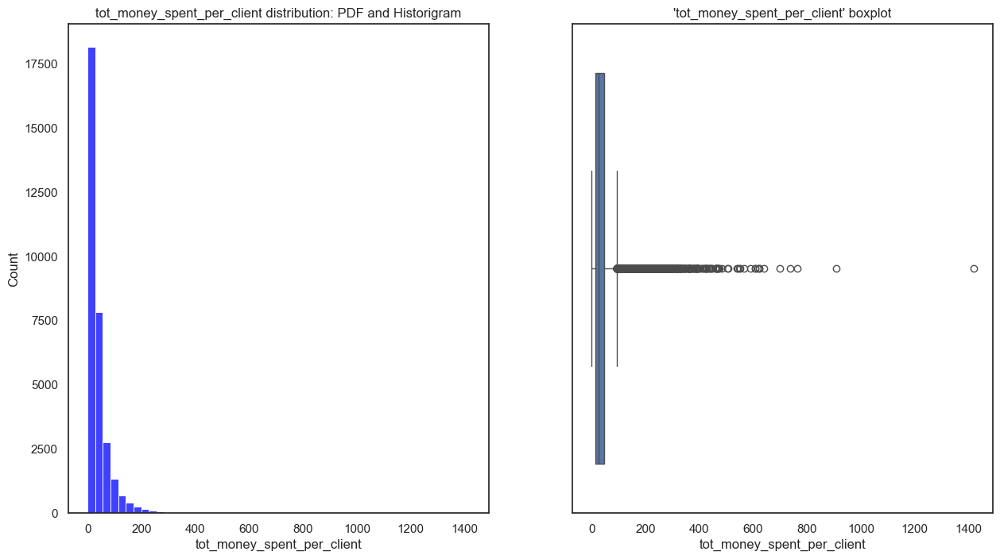

In [153]:
"""Histogram and boxplot using the Freedman - Diaconis rule mentioned above"""
Q1,Q3 = np.nanpercentile(df_fe["tot_money_spent_per_client"], [25, 75])
IQR = Q3-Q1
fd_bin_width = (2*IQR)/len(df_fe["tot_money_spent_per_client"])**(1/3)
df_optimal_num_bins = int((max(df_fe["tot_money_spent_per_client"])-min(df_fe["tot_money_spent_per_client"]))/fd_bin_width)

fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_fe["tot_money_spent_per_client"], kde=False, color="blue", bins=50, ax=axes[0])
axes[0].set_title("tot_money_spent_per_client distribution: PDF and Historigram")

sns.boxplot(x = df_fe["tot_money_spent_per_client"], ax=axes[1])
axes[1].set_title("'tot_money_spent_per_client' boxplot")
plt.show()

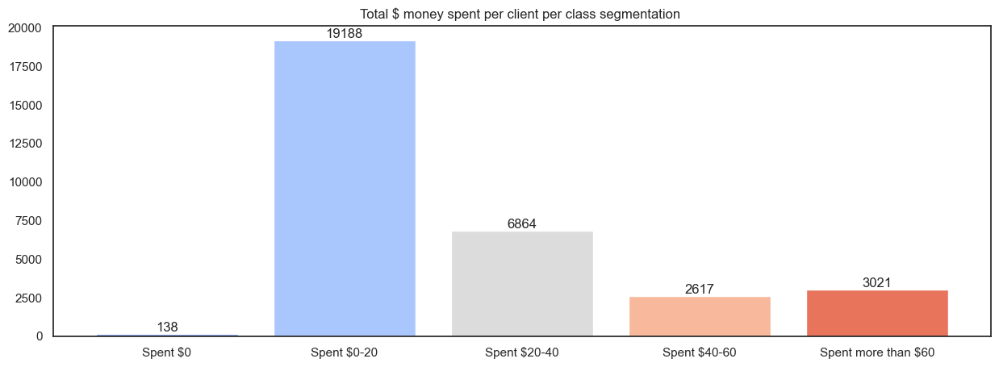

In [154]:
"""Total money spent per client per class segmentation """

spent_0 = df_fe.loc[df_fe["tot_money_spent_per_client"] == 0].shape[0]
spent_0_20 =  df_fe.loc[(df_fe["tot_money_spent_per_client"] > 0) & (df_fe["tot_money_spent_per_client"] <20)].shape[0]
spent_20_40 = df_fe.loc[(df_fe["tot_money_spent_per_client"] >= 20) & (df_fe["tot_money_spent_per_client"] <40)].shape[0]
spent_40_60 = df_fe.loc[(df_fe["tot_money_spent_per_client"] >= 40) & (df_fe["tot_money_spent_per_client"] <60)].shape[0]
spent_more_60 = df_fe.loc[(df_fe["tot_money_spent_per_client"] >= 60) ].shape[0]

total_elements = df_fe.shape[0]

fig, ax = plt.subplots(1,1, figsize = (15,5))
y_values= [tot_orders_0, tot_orders_1_3, tot_orders_4_6, tot_orders_7_9, tot_orders_10]
x_values = ["Spent $0", "Spent $0-20", "Spent $20-40", "Spent $40-60", "Spent more than $60" ]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element}" for element in y_values])
ax.set_title("Total $ money spent per client per class segmentation ")
plt.show()

In [155]:
"""Some clients have $0 total money spent"""

tms_strange_clients_df = df_fe.loc[(df_fe["tot_money_spent_per_client"]==0) & (df_fe["tot_orders_per_client"] == 0)]
tms_strange_clients_df


#All the clients who have have 0 money spent correspond to the same client who have 0 orders made 

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,client_activity_flag,tot_orders_per_client,tot_orders_per_client_HR,tot_money_spent_per_client
customer_id,,,,,,,,,,,,,,,,,,,,,
4903041977,8670,City 8,22.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,Online,one_time_customer,0,0,0.0
c94b288475,8670,City 8,26.0,0,0,0,1,1,DELIVERY,CASH,...,0,0,0,0,0,In Person,one_time_customer,0,0,0.0
f687717dc1,8670,City 8,21.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,Online,one_time_customer,0,0,0.0
c6cf0b76fb,8670,City 8,38.0,0,0,0,2,2,DELIVERY,CASH,...,0,0,0,0,0,In Person,one_time_customer,0,0,0.0
1b7c34738e,8670,City 8,24.0,0,0,0,3,3,NO PROMO USED,CASH,...,0,0,0,0,0,In Person,one_time_customer,0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,8670,City 8,30.0,0,0,1,86,86,NO PROMO USED,DIGI,...,0,0,0,0,0,Online,one_time_customer,0,0,0.0
0039059c9c,8670,City 8,22.0,0,0,1,88,88,DISCOUNT,CARD,...,0,0,0,0,0,In Person,one_time_customer,0,0,0.0
0e60632fe2,8670,City 8,23.0,0,0,0,89,89,DISCOUNT,CARD,...,0,0,0,0,0,In Person,one_time_customer,0,0,0.0


<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`tot_money_spent_per_client`**
1. Represents a numerical feature with total money spent made per client
2. To build the feature, we did the sum of All CUI variables
3. Strange values detected. 
    - 138 clients had 0 total money spent
    - These clients correspond to the clients who also had 0 total orders made during the 3 months
    - How to deal with these values? In my opinion, they should be removed.
4. From 31,828 clients, almost 20k spent between $0-$20
5. From boxplot and histogram
    - A lot of outliers present (both extreme and moderate)
    - heavily left skewed distribution meaning that most clients didn't spend a lot of money during the 3 months
    
6. No NaN values



<div class="alert alert-block alert-danger">

> Discuss in a group how to deal with total_orders_per_client strange values

</div>

---

### **`CUI binary variables`** and **`num_unique_cuisines_tried`**

#### <u>CUI binary variables </u> - How did we create the feature?
1. Since each CUI variable has a lot of non spending clients, we decided to create a new feature ('purchased_cousine_type') that evaluates whether the client spent any money or not for each type ou cousine
2. Values interpretation:
- 0: means that the client didn't spent any money on that cousine
- 1: means that the client spent money

#### <u> num_unique_cuisines_tried </u> - How did we create the feature?
1. If we sum row wise all the CUI binary variables, we will get the total number of unique cuisines tried by each client.
2. It could provide a good insight into customer diversity and engagement

In [156]:
df_fe[CUI_columns]

,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
customer_id,,,,,,,,,,,,,,,
1b8f824d5e,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.0,28.88,0.00,0.0,0.0,0.0,0.0,0.0
5d272b9dcb,12.82,6.39,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
f6d1b2ba63,9.20,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
180c632ed8,0.00,13.70,0.00,0.0,0.0,0.0,0.00,0.0,17.86,0.00,0.0,0.0,0.0,0.0,0.0
4eb37a6705,14.57,40.87,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0.00,0.00,18.04,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
f6b6709018,18.04,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
f74ad8ce3f,0.00,0.00,0.00,0.0,0.0,0.0,17.79,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0


In [157]:
"""Creating the CUI binary variables"""

for element in CUI_columns:
    current_ele = str(element).split("_")[1]
    type_clients = df_fe[element].map(lambda x: 0 if x==0 else 1)
    df_fe["purchased_"+ current_ele] = type_clients

purchased_features = [element for element in df_fe.columns if 'purchased' in str(element)]
df_fe[purchased_features]

,purchased_American,purchased_Asian,purchased_Beverages,purchased_Cafe,purchased_Chicken Dishes,purchased_Chinese,purchased_Desserts,purchased_Healthy,purchased_Indian,purchased_Italian,purchased_Japanese,purchased_Noodle Dishes,purchased_OTHER,purchased_Street Food / Snacks,purchased_Thai
customer_id,,,,,,,,,,,,,,,
1b8f824d5e,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
5d272b9dcb,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
f6d1b2ba63,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
180c632ed8,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0
4eb37a6705,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
f6b6709018,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
f74ad8ce3f,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0


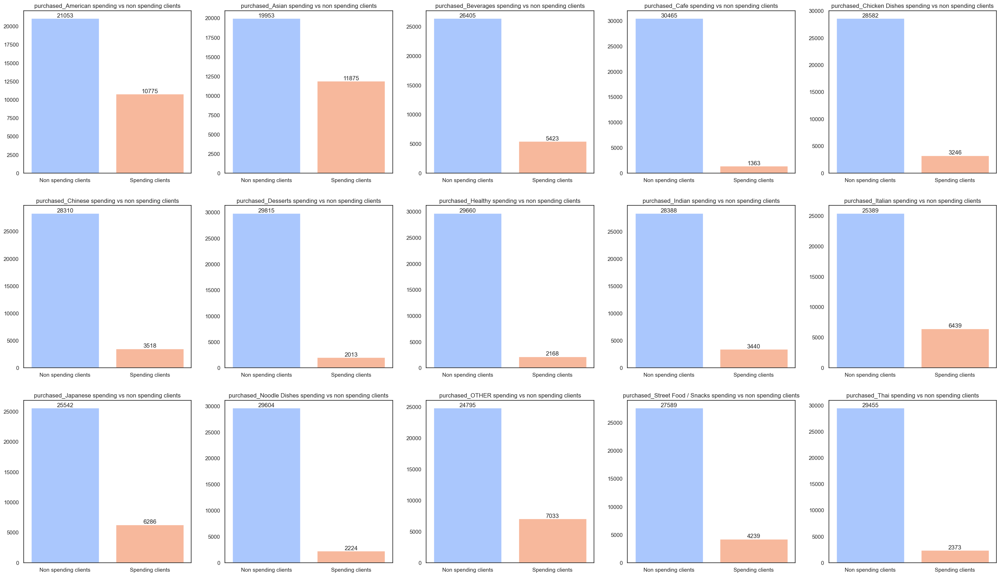

In [158]:
sns.set_style("white")

columns = purchased_features

fig, axes = plt.subplots(3, 5, figsize=(35, 20))

# Loop through each feature and plot boxplots with vertical lines for Q3 + 1.5*IQR and Q3 + 3*IQR
for i, feature in enumerate(columns):
    ax = axes[i // 5, i % 5]
    y_values = [df_fe.loc[df_fe[feature] == 0.].shape[0], df_fe.loc[df_fe[feature] == 1].shape[0]]
    x_values = ["Non spending clients", "Spending clients"]
    bar_colours = sns.color_palette("coolwarm", len(x_values))
    p = ax.bar(x_values, y_values, color=bar_colours)
    ax.bar_label(p, labels= [f"{element}" for element in y_values])
    ax.set_title(f" {feature} spending vs non spending clients ")

plt.show()

In [159]:
"""No nan values"""

df_fe[purchased_features].isnull().sum()

purchased_American                0
purchased_Asian                   0
purchased_Beverages               0
purchased_Cafe                    0
purchased_Chicken Dishes          0
purchased_Chinese                 0
purchased_Desserts                0
purchased_Healthy                 0
purchased_Indian                  0
purchased_Italian                 0
purchased_Japanese                0
purchased_Noodle Dishes           0
purchased_OTHER                   0
purchased_Street Food / Snacks    0
purchased_Thai                    0
dtype: int64

In [160]:
"""Creating the 'num_unique_cuisines_tried' feature"""
df_fe["num_unique_cuisines_tried"] = df_fe[purchased_features].sum(axis = 1)
df_fe

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,purchased_Desserts,purchased_Healthy,purchased_Indian,purchased_Italian,purchased_Japanese,purchased_Noodle Dishes,purchased_OTHER,purchased_Street Food / Snacks,purchased_Thai,num_unique_cuisines_tried
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,City 2,18.0,2,5,1,0,1,DELIVERY,DIGI,...,0,0,1,0,0,0,0,0,0,1
5d272b9dcb,8670,City 8,17.0,2,2,2,0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,2
f6d1b2ba63,4660,City 4,38.0,1,2,2,0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,1
180c632ed8,4660,City 4,NaN,2,3,1,0,2,DELIVERY,DIGI,...,0,0,1,0,0,0,0,0,0,2
4eb37a6705,4660,City 4,20.0,2,5,0,0,2,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,8670,City 8,30.0,1,1,1,<NA>,0,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,0,1
f6b6709018,8670,City 8,NaN,1,1,0,<NA>,0,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,1
f74ad8ce3f,8670,City 8,24.0,1,1,1,<NA>,0,NO PROMO USED,DIGI,...,1,0,0,0,0,0,0,0,0,1


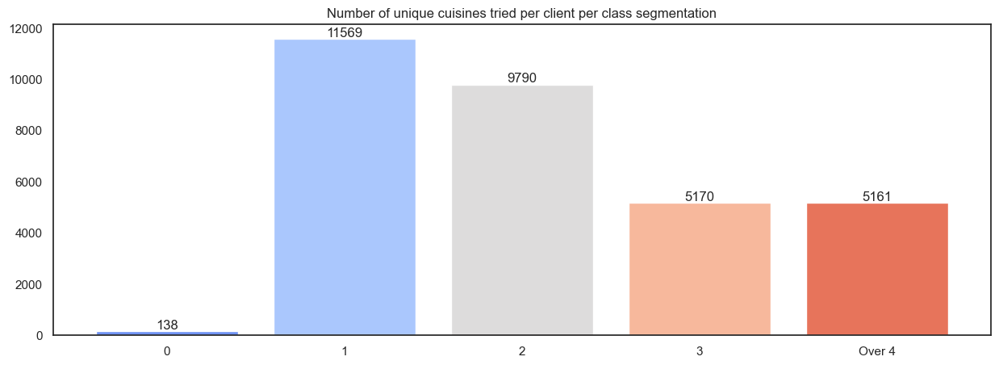

In [161]:
"""Number of unique cuisines tried per client per class segmentation bar plot"""

fig, ax = plt.subplots(1,1, figsize = (15,5))

unique_cui_0 = df_fe.loc[df_fe["num_unique_cuisines_tried"] == 0].shape[0]
unique_cui_1 = df_fe.loc[df_fe["num_unique_cuisines_tried"] == 1].shape[0]
unique_cui_2 = df_fe.loc[df_fe["num_unique_cuisines_tried"] == 2].shape[0]
unique_cui_3 = df_fe.loc[df_fe["num_unique_cuisines_tried"] == 3].shape[0]
unique_cui_over_4 = df_fe.loc[df_fe["num_unique_cuisines_tried"] >= 4].shape[0]

y_values = [unique_cui_0, unique_cui_1, unique_cui_2, unique_cui_3, unique_cui_over_4]
x_values = ["0", "1", "2", "3", "Over 4"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element}" for element in y_values])
ax.set_title("Number of unique cuisines tried per client per class segmentation")
plt.show()

In [162]:
"""Number of nan values"""
df_fe["num_unique_cuisines_tried"].isnull().sum()

0

In [163]:
"""Some clients tried 0 unique cuisines"""

uct_strange_clients_df = df_fe.loc[(df_fe["tot_money_spent_per_client"]==0) & (df_fe["tot_orders_per_client"] == 0) & (df_fe["num_unique_cuisines_tried"] == 0)]
uct_strange_clients_df = df_fe.loc[(df_fe["tot_money_spent_per_client"]==0) & (df_fe["tot_orders_per_client"] == 0)]
uct_strange_clients_df


#All the clients who have tried 0 uniquecuisines are also the clients that have spent 0 money and have made 0 orders 

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,purchased_Desserts,purchased_Healthy,purchased_Indian,purchased_Italian,purchased_Japanese,purchased_Noodle Dishes,purchased_OTHER,purchased_Street Food / Snacks,purchased_Thai,num_unique_cuisines_tried
customer_id,,,,,,,,,,,,,,,,,,,,,
4903041977,8670,City 8,22.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,0
c94b288475,8670,City 8,26.0,0,0,0,1,1,DELIVERY,CASH,...,0,0,0,0,0,0,0,0,0,0
f687717dc1,8670,City 8,21.0,0,0,1,1,1,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,0
c6cf0b76fb,8670,City 8,38.0,0,0,0,2,2,DELIVERY,CASH,...,0,0,0,0,0,0,0,0,0,0
1b7c34738e,8670,City 8,24.0,0,0,0,3,3,NO PROMO USED,CASH,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,8670,City 8,30.0,0,0,1,86,86,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,0,0
0039059c9c,8670,City 8,22.0,0,0,1,88,88,DISCOUNT,CARD,...,0,0,0,0,0,0,0,0,0,0
0e60632fe2,8670,City 8,23.0,0,0,0,89,89,DISCOUNT,CARD,...,0,0,0,0,0,0,0,0,0,0


<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`CUI binary variables`**
1. Represents a binary feature that evaluates whether the client spent any money or not for each type of cousine. The value 0 means that the client didn't spent any money on that cousine and 1 that the client spent money
2. Important to highlight "American" and "Asian" cuisines with the highest numbers of spending clients. From the total ~32k clients in the dataset, ~11k and ~12k spent money on American and Asian cuisines respectively 
3. Important to note cafe as the CUI with the least number of spending clients 
cafe as the cui with the least amount of spending clients (~1.4k)
4. No nan values


### Key notes **`num_unique_cuisines_tried`**
1. Represents a numerical feature with total number of unique cuisines tried per client.
2. To build the feature, we did the row wise sum of all binary CUI variables
3. Strange values detected. 
    - The same 138 clients who haven't made any orders or spent any money during the 3 months, as expected, haven't tried a single cuisine 
    - The recommendation to remove them keeps unchanged

4. From 31,828 clients, ~11.5k tried a single cuisine. This suggests that a significant portion of the customer base may have narrow or specific tastes, preferring familiar options. 
5. No NaN values



---

### **`peak_days_num_orders`**, **`off_peak_days_num_orders`** and **`client_order_behaviour`** 

#### peak_days_num_orders and off_peak_days_num_orders - How did we create the features?
1. To reduce dimensonality, we will create 2 features that evaluate the total numbers of orders made by each client during the peak days and all the remaining days
2.  How was each feature defined?
    - peak_days_num_orders: Considering that Thursday, Friday and Saturday are the days with the most orders they will be considered the peak days
    - off_peak_num_orders: Correspond to all the remaining days
3. We opted for this approach instead of doing week_day_num_orders and weekend_num_orders due the DOW variables distribution


#### client_order_behaviour - How did we create the feature?

1. After creating the 'peak_days_num_orders' and 'off_peak_days_num_orders' we can determine for each client whether their mostly order during the peak or off peak days. This feature will be called client_order_behaviour
2. Classification process:
    - If the peak_days_num_orders is bigger than the off_peak_days_num_orders, client is considered a Peak Order client and classified as a 1
    - If the opposite happens, client is considered Off-Peak order client and classified as a 0


In [164]:
"""Creating 'peak_days_num_orders' and 'off_peak_days_num_orders' features"""
peak_days_columns = ["DOW_4", "DOW_5", "DOW_6"]
off_peak_days_columns = ["DOW_0", "DOW_1", "DOW_2", "DOW_3"]

df_fe["peak_days_num_orders"] = df_fe[peak_days_columns].sum(axis=1).astype(int)
df_fe["off_peak_days_num_orders"] = df_fe[off_peak_days_columns].sum(axis=1).astype(int)

In [165]:
print (f"peak_days_num_orders statistics: \n")
print (df_fe["peak_days_num_orders"].describe())

print (f"\noff_peak_days_num_orders statistics \n")
print (df_fe["off_peak_days_num_orders"].describe())


peak_days_num_orders statistics: 

count    31828.000000
mean         2.035158
std          2.515167
min          0.000000
25%          1.000000
50%          1.000000
75%          3.000000
max         45.000000
Name: peak_days_num_orders, dtype: float64

off_peak_days_num_orders statistics 

count    31828.000000
mean         2.333763
std          3.184887
min          0.000000
25%          1.000000
50%          1.000000
75%          3.000000
max         60.000000
Name: off_peak_days_num_orders, dtype: float64


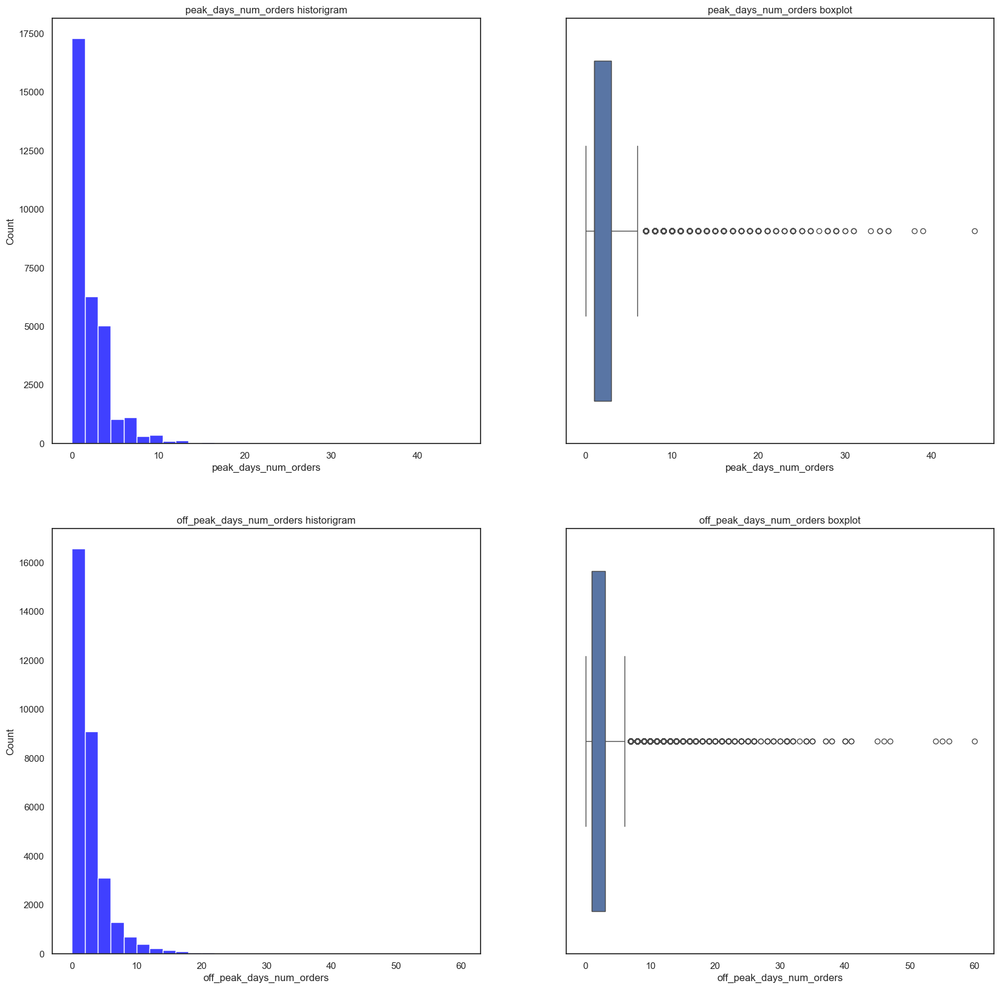

In [166]:
"""Histogram and boxplot for 'peak_days_num_orders' and 'off_peak_days_num_orders'  """

fig, axes = plt.subplots(2, 2, figsize = (20,20))

# Peak number of orders
sns.histplot(df_fe["peak_days_num_orders"], kde=False, color="blue", bins=30, ax=axes[0,0])
axes[0,0].set_title("peak_days_num_orders historigram")

sns.boxplot(x = df_fe["peak_days_num_orders"], ax=axes[0,1])
axes[0,1].set_title("peak_days_num_orders boxplot")

# Off-Peak number of orders
sns.histplot(df_fe["off_peak_days_num_orders"], kde=False, color="blue", bins=30, ax=axes[1,0])
axes[1,0].set_title("off_peak_days_num_orders historigram")

sns.boxplot(x = df_fe["off_peak_days_num_orders"], ax=axes[1,1])
axes[1,1].set_title("off_peak_days_num_orders boxplot")

plt.show()

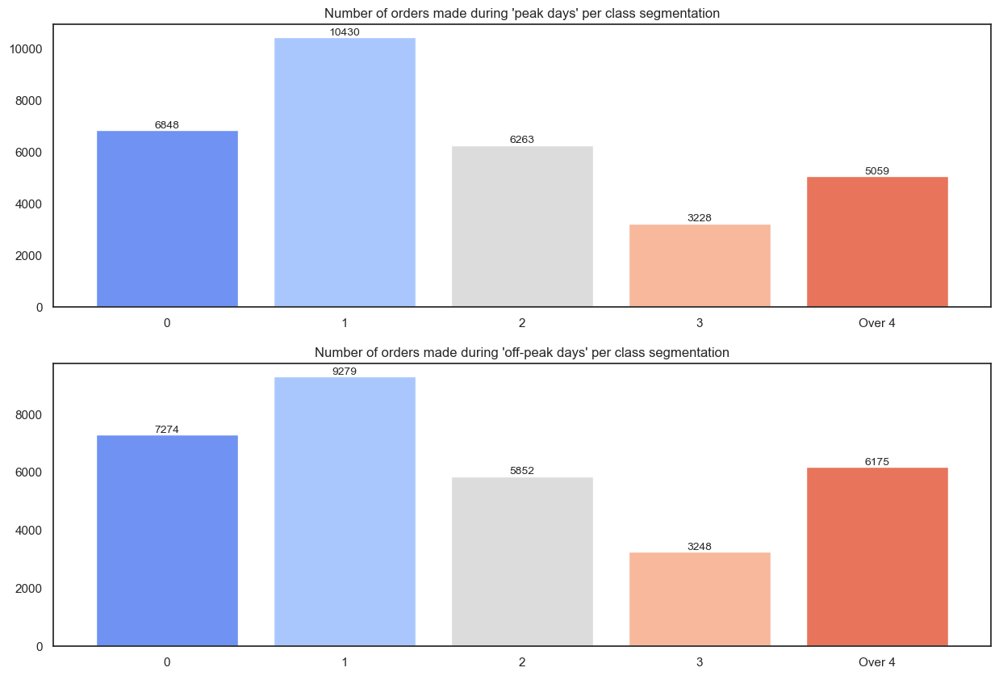

In [167]:
"""Number of orders made during off-peak and peak days per class segmentation bar plot"""

fig, ax = plt.subplots(2,1, figsize = (15,10))

# Peak days
peak_days_0 = df_fe.loc[(df_fe["peak_days_num_orders"] == 0)].shape[0]
peak_days_1 = df_fe.loc[(df_fe["peak_days_num_orders"] == 1)].shape[0]
peak_days_2 = df_fe.loc[(df_fe["peak_days_num_orders"] == 2)].shape[0]
peak_days_3 = df_fe.loc[(df_fe["peak_days_num_orders"] == 3)].shape[0]
peak_days_4more =df_fe.loc[(df_fe["peak_days_num_orders"] >= 4)].shape[0]

y_values = [peak_days_0, peak_days_1, peak_days_2, peak_days_3, peak_days_4more]
x_values = ["0", "1", "2", "3", "Over 4"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0].bar(x_values, y_values, color=bar_colours)
ax[0].bar_label(p, labels= [f"{element}" for element in y_values], fontsize = 10)
ax[0].set_title("Number of orders made during 'peak days' per class segmentation")

# Off-Peak days
off_peak_days_0 = df_fe.loc[(df_fe["off_peak_days_num_orders"] == 0)].shape[0]
off_peak_days_1 = df_fe.loc[(df_fe["off_peak_days_num_orders"] == 1)].shape[0]
off_peak_days_2 = df_fe.loc[(df_fe["off_peak_days_num_orders"] == 2)].shape[0]
off_peak_days_3 = df_fe.loc[(df_fe["off_peak_days_num_orders"] == 3)].shape[0]
off_peak_days_4more =df_fe.loc[(df_fe["off_peak_days_num_orders"] >= 4)].shape[0]

y_values = [off_peak_days_0, off_peak_days_1, off_peak_days_2, off_peak_days_3, off_peak_days_4more]
x_values = ["0", "1", "2", "3", "Over 4"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1].bar(x_values, y_values, color=bar_colours)
ax[1].bar_label(p, labels= [f"{element}" for element in y_values], fontsize = 10)
ax[1].set_title("Number of orders made during 'off-peak days' per class segmentation")

plt.show()

In [168]:
"""Creating feature Client type regarding num_orders made in each category"""
df_fe.loc[df_fe["peak_days_num_orders"] > df_fe["off_peak_days_num_orders"]].shape[0]
df_fe.loc[df_fe["peak_days_num_orders"] < df_fe["off_peak_days_num_orders"]].shape[0]

df_fe["client_order_behaviour"] = df_fe.apply(lambda x: 1 if x["peak_days_num_orders"] > x["off_peak_days_num_orders"] else 0, axis=1 )

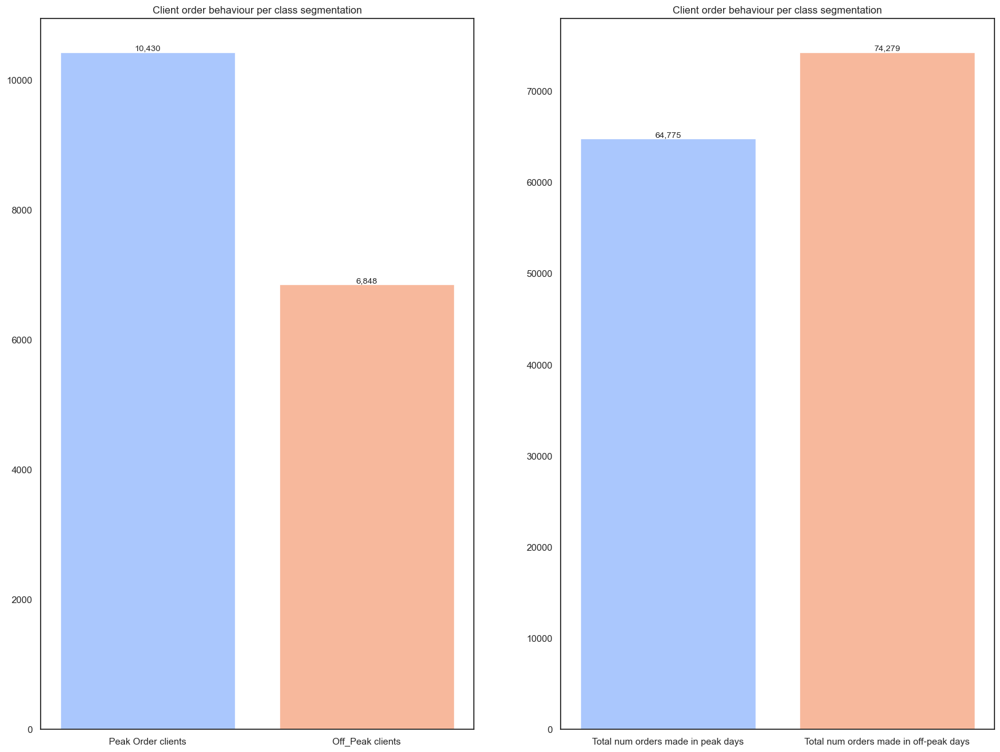

In [169]:
"""Client order behaviour per class segmentation and total orders made during peak and off peak days bar plots"""

sns.set_style("white")
fig, ax = plt.subplots(1,2, figsize = (20,15))

# Client order behaviour per class segmentation
peak_order_num_clients = df_fe.loc[df_fe["peak_days_num_orders"] == 1].shape[0]
off_peak_order_num_clients = df_fe.loc[df_fe["peak_days_num_orders"] == 0].shape[0]

y_values = [peak_order_num_clients, off_peak_order_num_clients]
x_values = ["Peak Order clients","Off_Peak clients"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0].bar(x_values, y_values, color=bar_colours)
ax[0].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[0].set_title("Client order behaviour per class segmentation")

# Total orders made during peak and off peak days bar plots

tot_num_peak_days_orders = df_fe["peak_days_num_orders"].sum()
tot_num_off_peak_days_orders = df_fe["off_peak_days_num_orders"].sum()

y_values = [tot_num_peak_days_orders, tot_num_off_peak_days_orders  ]
x_values = ["Total num orders made in peak days","Total num orders made in off-peak days"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1].bar(x_values, y_values, color=bar_colours)
ax[1].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[1].set_title("Client order behaviour per class segmentation")

plt.show()

In [170]:
"""Number of NaN values"""
df_fe[["off_peak_days_num_orders", "peak_days_num_orders", "client_order_behaviour"]].isnull().sum()

off_peak_days_num_orders    0
peak_days_num_orders        0
client_order_behaviour      0
dtype: int64

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`peak_days_num_orders`** and **`off_peak_days_num_orders`**
1. Respectively, the features represent the total number of orders made during peak days (Thursday, Saturday and Sunday) and off-peak days (remaining days) per client during the 3 months.
2. 75% of clients have made less or equal to 3 orders during peak days and off-peak days.
3. Both have outliers and non nan values


### Key notes **`client_order_behaviour`**
1. Represents a binary feature that evaluates whether the clinet has made more orders during peak or off-peak days. Value 0 means that the client has made more orders during off-peak days and 1 means that the client has made more orders during peak days
2. Important to highlight the fact that despite the total orders made during peak days (~65k) being superior to the total orders made during off-peak days (~74k), the number of peak orders clients (~10k) is superior than the number of off-peak clients (~7k). This means that despite more orders being made during the 4 off peak days, more clients prefer to make their orders during the peak days 
3. No nan values

---

### **`morning_num_orders`**, **`afternoon_num_orders`** , **`evening_num_orders`** and **`night_num_orders`**

#### How did we create the features?
1. To reduce the input space dimensionality associated with the HR features, we decided to create 4 features:
    - morning_num_orders: includes number of orders made per client from 6:00 - 11:59 (HR_6 - HR_11)
    - afternoon_num_orders: includes number of orders made per client from 12:00 - 17:59 (HR_12 - HR_17)
    - evening num_orders: includes number of orders made per client from 18:00 - 21:59 (HR_18 - HR_21)
    - night_num_orders: includes number of orders made per client from 22:00 - 5:59 (HR_22 - HR_5)


2. Opted for uneven time slots so they are meaningful and capture typical customer behavior patterns

In [171]:
"""Creating the features"""
morning_columns = [element for element in HR_columns if int(element.split("_")[1]) in range (6,12)]
afternoon_columns = [element for element in HR_columns if int(element.split("_")[1]) in range (12,18)]
evening_columns = [element for element in HR_columns if int(element.split("_")[1]) in range (18,22)]
night_columns = ['HR_22', 'HR_23', 'HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5']

df_fe["morning_num_orders"] = df_fe[morning_columns].sum(axis=1).astype(int)
df_fe["afternoon_num_orders"] = df_fe[afternoon_columns].sum(axis=1).astype(int)
df_fe["evening_num_orders"] = df_fe[evening_columns].sum(axis=1).astype(int)
df_fe["night_num_orders"] = df_fe[night_columns].sum(axis=1).astype(int)

In [172]:
print (f"morning_num_orders statistics: \n")
print (df_fe["morning_num_orders"].describe())

print (f"\nafternoon_num_orders statistics \n")
print (df_fe["afternoon_num_orders"].describe())

print (f"\nevening_num_orders statistics \n")
print (df_fe["evening_num_orders"].describe())

print (f"\n night_num_orders statistics \n")
print (df_fe["night_num_orders"].describe())

morning_num_orders statistics: 

count    31828.000000
mean         1.220592
std          2.259893
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max         72.000000
Name: morning_num_orders, dtype: float64

afternoon_num_orders statistics 

count    31828.000000
mean         1.790373
std          2.723316
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max         52.000000
Name: afternoon_num_orders, dtype: float64

evening_num_orders statistics 

count    31828.000000
mean         0.797003
std          1.793775
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         50.000000
Name: evening_num_orders, dtype: float64

 night_num_orders statistics 

count    31828.000000
mean         0.560953
std          1.388324
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         35.000000
Name: night_num_orders, dtype: float64

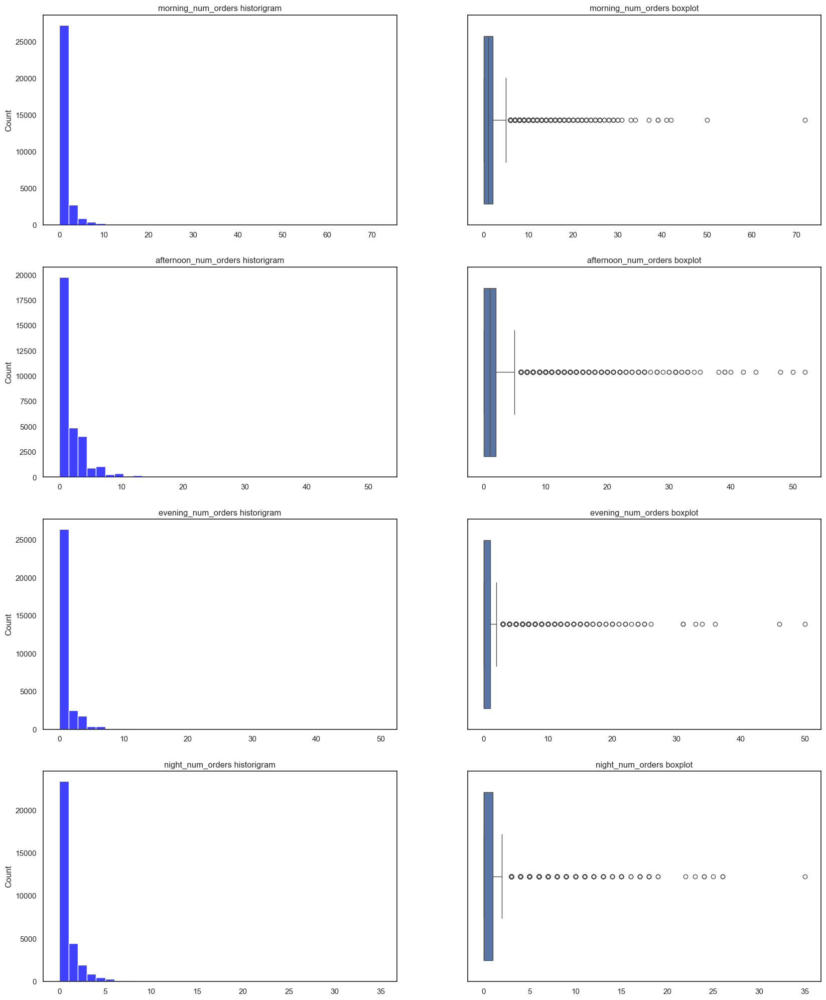

In [173]:
"""Plot histogram and boxplot for each created feature"""

fig, axes = plt.subplots(4, 2, figsize = (20,25))

# Morning number of orders
sns.histplot(df_fe["morning_num_orders"], kde=False, color="blue", bins=35, ax=axes[0,0])
axes[0,0].set_title("morning_num_orders historigram")
axes[0,0].set_xlabel("")

sns.boxplot(x = df_fe["morning_num_orders"], ax=axes[0,1])
axes[0,1].set_title("morning_num_orders boxplot")
axes[0,1].set_xlabel("")

# Afternoon number of orders
sns.histplot(df_fe["afternoon_num_orders"], kde=False, color="blue", bins=35, ax=axes[1,0])
axes[1,0].set_title("afternoon_num_orders historigram")
axes[1,0].set_xlabel("")

sns.boxplot(x = df_fe["afternoon_num_orders"], ax=axes[1,1])
axes[1,1].set_title("afternoon_num_orders boxplot")
axes[1,1].set_xlabel("")

# Afternoon number of orders
sns.histplot(df_fe["evening_num_orders"], kde=False, color="blue", bins=35, ax=axes[2,0])
axes[2,0].set_title("evening_num_orders historigram")
axes[2,0].set_xlabel("")

sns.boxplot(x = df_fe["evening_num_orders"], ax=axes[2,1])
axes[2,1].set_title("evening_num_orders boxplot")
axes[2,1].set_xlabel("")

# Night number of orders
sns.histplot(df_fe["night_num_orders"], kde=False, color="blue", bins=35, ax=axes[3,0])
axes[3,0].set_title("night_num_orders historigram")
axes[3,0].set_xlabel("")

sns.boxplot(x = df_fe["night_num_orders"], ax=axes[3,1])
axes[3,1].set_title("night_num_orders boxplot")
axes[3,1].set_xlabel("")


plt.show()

In [174]:
df_fe.loc[df_fe["morning_num_orders"] == 2]
df_fe.loc[df_fe["morning_num_orders"] >= 3]

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,purchased_Street Food / Snacks,purchased_Thai,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,client_order_behaviour,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
customer_id,,,,,,,,,,,,,,,,,,,,,
1f1fe12bed,8670,City 8,26.0,5,6,1,0,6,DISCOUNT,CASH,...,1,0,4,4,1,1,3,1,0,1
b92ab1eeec,2360,City 2,47.0,5,6,5,0,6,NO PROMO USED,DIGI,...,0,0,5,3,2,1,4,1,0,0
728552f1e2,4140,City 4,26.0,1,3,3,0,12,DELIVERY,CARD,...,0,0,1,3,0,1,3,0,0,0
63cb294ad9,8670,City 8,16.0,5,8,1,0,13,NO PROMO USED,CARD,...,1,0,2,2,4,0,4,0,0,2
66962f296d,2360,City 2,30.0,2,3,3,0,21,NO PROMO USED,CARD,...,1,0,2,3,0,1,3,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
d93459c40c,4660,City 4,NaN,3,7,2,83,85,DELIVERY,DIGI,...,0,0,2,2,1,1,3,0,0,0
692c2285e8,8670,City 8,22.0,3,4,0,85,88,DISCOUNT,CARD,...,0,0,3,0,3,0,3,0,0,0
3490c50d77,2360,City 2,26.0,2,6,3,87,90,DISCOUNT,DIGI,...,0,0,1,1,2,0,3,0,0,0


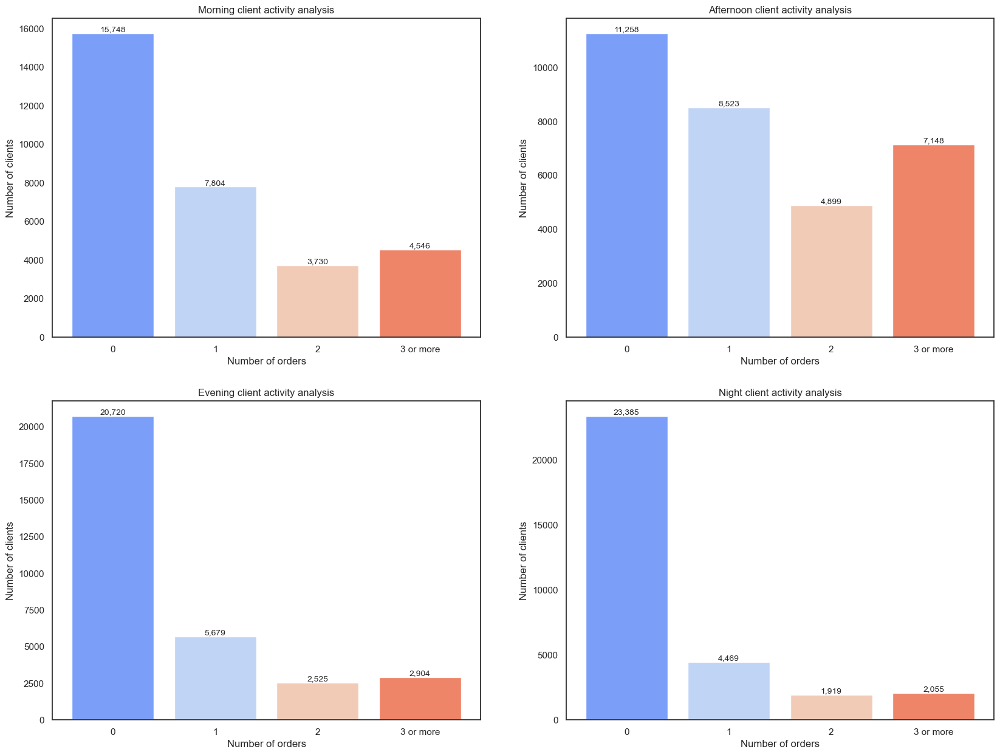

In [175]:
"""Client Order Frequency Analysis for Morning/Afternoon/Evening/Night Time Slots"""

sns.set_style("white")
fig, ax = plt.subplots(2,2, figsize = (20,15))

# Morning
morning_orders_0 = df_fe.loc[df_fe["morning_num_orders"] == 0].shape[0]
morning_orders_1 = df_fe.loc[df_fe["morning_num_orders"] == 1].shape[0]
morning_orders_2 = df_fe.loc[df_fe["morning_num_orders"] == 2].shape[0]
morning_orders_3_more = df_fe.loc[df_fe["morning_num_orders"] >= 3].shape[0]

y_values = [morning_orders_0, morning_orders_1, morning_orders_2, morning_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0, 0].bar(x_values, y_values, color=bar_colours)
ax[0,0].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[0,0].set_title("Morning client activity analysis")
ax[0,0].set_ylabel("Number of clients")
ax[0,0].set_xlabel("Number of orders")


# Afternoon
afternoon_orders_0 = df_fe.loc[df_fe["afternoon_num_orders"] == 0].shape[0]
afternoon_orders_1 = df_fe.loc[df_fe["afternoon_num_orders"] == 1].shape[0]
afternoon_orders_2 = df_fe.loc[df_fe["afternoon_num_orders"] == 2].shape[0]
afternoon_orders_3_more = df_fe.loc[df_fe["afternoon_num_orders"] >= 3].shape[0]

y_values = [afternoon_orders_0, afternoon_orders_1, afternoon_orders_2, afternoon_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0, 1].bar(x_values, y_values, color=bar_colours)
ax[0,1].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[0,1].set_title("Afternoon client activity analysis")
ax[0,1].set_ylabel("Number of clients")
ax[0,1].set_xlabel("Number of orders")


# Evening
evening_orders_0 = df_fe.loc[df_fe["evening_num_orders"] == 0].shape[0]
evening_orders_1 = df_fe.loc[df_fe["evening_num_orders"] == 1].shape[0]
evening_orders_2 = df_fe.loc[df_fe["evening_num_orders"] == 2].shape[0]
evening_orders_3_more = df_fe.loc[df_fe["evening_num_orders"] >= 3].shape[0]

y_values = [evening_orders_0, evening_orders_1, evening_orders_2, evening_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1, 0].bar(x_values, y_values, color=bar_colours)
ax[1,0].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[1,0].set_title("Evening client activity analysis")
ax[1,0].set_ylabel("Number of clients")
ax[1,0].set_xlabel("Number of orders")

# Night
night_orders_0 = df_fe.loc[df_fe["night_num_orders"] == 0].shape[0]
night_orders_1 = df_fe.loc[df_fe["night_num_orders"] == 1].shape[0]
night_orders_2 = df_fe.loc[df_fe["night_num_orders"] == 2].shape[0]
night_orders_3_more = df_fe.loc[df_fe["night_num_orders"] >= 3].shape[0]

y_values = [night_orders_0, night_orders_1, night_orders_2, night_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1, 1].bar(x_values, y_values, color=bar_colours)
ax[1,1].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[1,1].set_title("Night client activity analysis")
ax[1,1].set_ylabel("Number of clients")
ax[1,1].set_xlabel("Number of orders")

plt.show()

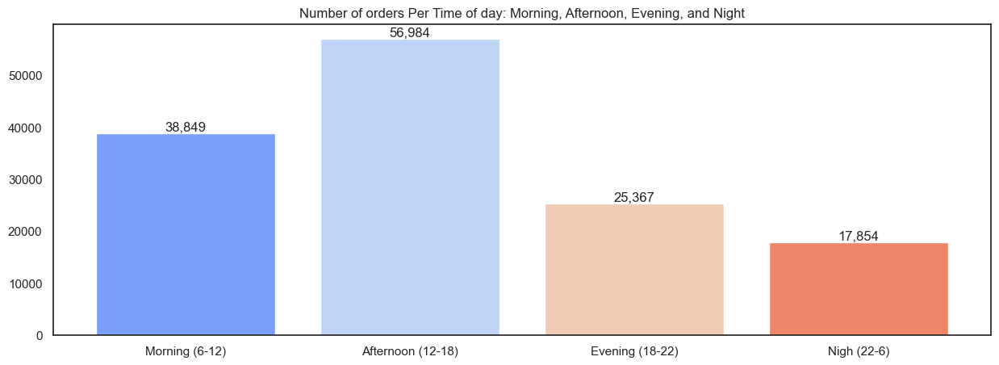

In [176]:
"""Number of orders Per Time of day: Morning, Afternoon, Evening, and Night"""

fig, ax = plt.subplots(1,1, figsize = (15,5))

morning_tot_orders = df_fe["morning_num_orders"].sum()
afternoon_tot_orders = df_fe["afternoon_num_orders"].sum()
evening_tot_orders = df_fe["evening_num_orders"].sum()
night_tot_orders = df_fe["night_num_orders"].sum()

y_values = [morning_tot_orders, afternoon_tot_orders, evening_tot_orders, night_tot_orders]
x_values = ["Morning (6-12)", "Afternoon (12-18)", "Evening (18-22)", "Nigh (22-6)"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element:,}" for element in y_values])
ax.set_title("Number of orders Per Time of day: Morning, Afternoon, Evening, and Night")
plt.show()


In [177]:
"""Analyzing nan values"""
df_fe[["morning_num_orders", "afternoon_num_orders","evening_num_orders", "night_num_orders"]].isnull().sum()

#No nan values 


morning_num_orders      0
afternoon_num_orders    0
evening_num_orders      0
night_num_orders        0
dtype: int64

In [178]:
"""Total amount of orders made"""

tot_num_orders = df_fe["morning_num_orders"].sum() + df_fe["afternoon_num_orders"].sum() + df_fe["evening_num_orders"].sum() + df_fe["night_num_orders"].sum()

In [179]:
tot_order_per_client_sum = df_fe["tot_orders_per_client"].sum()
tot_order_per_client_sum

139054

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`morning_num_orders`**, **`afternoon_num_orders`** , **`evening_num_orders`** and **`night_num_orders`**
1. The time of day with the most amount of orders made is the afternoon with close to 57k orders. It is then followed by the morning period
2.  COMPLETE it better


---

### **`Overview of all new features`**


<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`client_activity_flag`**
1. Represents a categorical feature build mostly using first_order and last_order features
2. All clients where 'first_order' is NaN (106) also have 'client_activity_flag'has an NaN value
3. The majority of our clients (57%) are inactive clients




### Key notes **`tot_orders_per_client`**
1. Represents a numerical feature with total orders made per clietn
2. To build the feature, we had 2 initial options: sum all the DOW variables or all the HR variables. Since only DOW variables don't have any NaN values, we opted to use it. 
3. Strange values detected. 
    - 138 clients had 0 total orders made despite one or many of the following features being bigger than 0: "product_count", "is_chain", "first_order" and "last_order"
    - Tried to understand if the issue was related to the DOW variables (features used to determine tot_orders_per_client feature). To do so, decided to determine the total number of orders per client using the HR variables despite the existence of NaN values. The results didn't change, meaning that all strange clients stayed strange clients.
    - How to deal with these values? In my opinion, they should be removed.
4. From 31,828 clients, almost 20k have made a total number of orders between 1 and 3
5. From boxplot and histogram
    - A lot of outliers present (both extreme and moderate)
    - heavily left skewed distribution
6. No NaN values




### Key notes **`tot_money_spent_per_client`**
1. Represents a numerical feature with total money spent made per client
2. To build the feature, we did the sum of All CUI variables
3. Strange values detected. 
    - 138 clients had 0 total money spent
    - These clients correspond to the clients who also had 0 total orders made during the 3 months
    - How to deal with these values? In my opinion, they should be removed.
4. From 31,828 clients, almost 20k spent between $0-$20
5. From boxplot and histogram
    - A lot of outliers present (both extreme and moderate)
    - heavily left skewed distribution meaning that most clients didn't spend a lot of money during the 3 months
6. No NaN values




### Key notes **`CUI binary variables`**
1. Represents a binary feature that evaluates whether the client spent any money or not for each type of cousine. The value 0 means that the client didn't spent any money on that cousine and 1 that the client spent money
2. Important to highlight "American" and "Asian" cuisines with the highest numbers of spending clients. From the total ~32k clients in the dataset, ~11k and ~12k spent money on American and Asian cuisines respectively 
3. Important to note cafe as the CUI with the least number of spending clients 
cafe as the cui with the least amount of spending clients (~1.4k)
4. No nan values



### Key notes **`num_unique_cuisines_tried`**
1. Represents a numerical feature with total number of unique cuisines tried per client.
2. To build the feature, we did the row wise sum of all binary CUI variables
3. Strange values detected. 
    - The same 138 clients who haven't made any orders or spent any money during the 3 months, as expected, haven't tried a single cuisine 
    - The recommendation to remove them keeps unchanged

4. From 31,828 clients, ~11.5k tried a single cuisine. This suggests that a significant portion of the customer base may have narrow or specific tastes, preferring familiar options. 
5. No NaN values


### Key notes **`peak_days_num_orders`** and **`off_peak_days_num_orders`**
1. Respectively, the features represent the total number of orders made during peak days (Thursday, Saturday and Sunday) and off-peak days (remaining days) per client during the 3 months.
2. 75% of clients have made less or equal to 3 orders during peak days and off-peak days.
3. Both have outliers and non nan values


### Key notes **`client_order_behaviour`**
1. Represents a binary feature that evaluates whether the clinet has made more orders during peak or off-peak days. Value 0 means that the client has made more orders during off-peak days and 1 means that the client has made more orders during peak days
2. Important to highlight the fact that despite the total orders made during peak days (~65k) being superior to the total orders made during off-peak days (~74k), the number of peak orders clients (~10k) is superior than the number of off-peak clients (~7k). This means that despite more orders being made during the 4 off peak days, more clients prefer to make their orders during the peak days 
3. No nan values



### Key notes **`morning_num_orders`**, **`afternoon_num_orders`** , **`evening_num_orders`** and **`night_num_orders`**
1. The time of day with the most amount of orders made is the afternoon with close to 57k orders. It is then followed by the morning period
2.  COMPLETE it better



---

<div class="alert alert-block alert-info" style="font-size:16px" id = "multivariate_analyzis">

## 6. Multivariate analyzis
### 6.1 Analyzing original df columns

In [180]:
df.columns

Index(['customer_region', 'city', 'customer_age', 'vendor_count',
       'product_count', 'is_chain', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American', 'CUI_Asian', 'CUI_Beverages',
       'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts',
       'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese',
       'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks',
       'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5',
       'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7',
       'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15',
       'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23',
       'payment_method_combined'],
      dtype='object')

In [181]:
"""Spliting features into categorical and non categorical data"""
cat_features = ["customer_region", "last_promo", "payment_method", "payment_method_combined", "city"]
num_features = [element for element in df.columns if element not in cat_features]
cat_features_df = df[["customer_region", "last_promo", "payment_method", "payment_method_combined", "city"]]
num_features_df = df.drop(columns=cat_features)
num_features_df


,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,18.0,2,5,1,0,1,0.00,0.00,0.00,0.0,...,0,0,0,0,2,0,0,0,0,0
5d272b9dcb,17.0,2,2,2,0,1,12.82,6.39,0.00,0.0,...,0,0,0,0,0,0,0,0,0,0
f6d1b2ba63,38.0,1,2,2,0,1,9.20,0.00,0.00,0.0,...,0,0,0,0,0,0,0,0,0,0
180c632ed8,NaN,2,3,1,0,2,0.00,13.70,0.00,0.0,...,1,0,0,0,0,0,0,0,0,0
4eb37a6705,20.0,2,5,0,0,2,14.57,40.87,0.00,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,30.0,1,1,1,<NA>,0,0.00,0.00,18.04,0.0,...,0,0,0,0,0,0,0,0,0,0
f6b6709018,NaN,1,1,0,<NA>,0,18.04,0.00,0.00,0.0,...,0,0,1,0,0,0,0,0,0,0
f74ad8ce3f,24.0,1,1,1,<NA>,0,0.00,0.00,0.00,0.0,...,0,0,0,0,0,0,0,0,0,0


In [182]:
num_features_df.columns

Index(['customer_age', 'vendor_count', 'product_count', 'is_chain',
       'first_order', 'last_order', 'CUI_American', 'CUI_Asian',
       'CUI_Beverages', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese',
       'CUI_Desserts', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian',
       'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER',
       'CUI_Street Food / Snacks', 'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2',
       'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3',
       'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11',
       'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19',
       'HR_20', 'HR_21', 'HR_22', 'HR_23'],
      dtype='object')

In [183]:
num_features_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31828 entries, 1b8f824d5e to fd40d3b0e0
Data columns (total 52 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   customer_age              31101 non-null  float64
 1   vendor_count              31828 non-null  int64  
 2   product_count             31828 non-null  int64  
 3   is_chain                  31828 non-null  int64  
 4   first_order               31722 non-null  Int64  
 5   last_order                31828 non-null  Int64  
 6   CUI_American              31828 non-null  float64
 7   CUI_Asian                 31828 non-null  float64
 8   CUI_Beverages             31828 non-null  float64
 9   CUI_Cafe                  31828 non-null  float64
 10  CUI_Chicken Dishes        31828 non-null  float64
 11  CUI_Chinese               31828 non-null  float64
 12  CUI_Desserts              31828 non-null  float64
 13  CUI_Healthy               31828 non-null  float64
 1

<div class="alert alert-block alert-info" style="font-size:16px">

### a) Analyzing Numerical features

### **`Spearman Correlation matrix`**

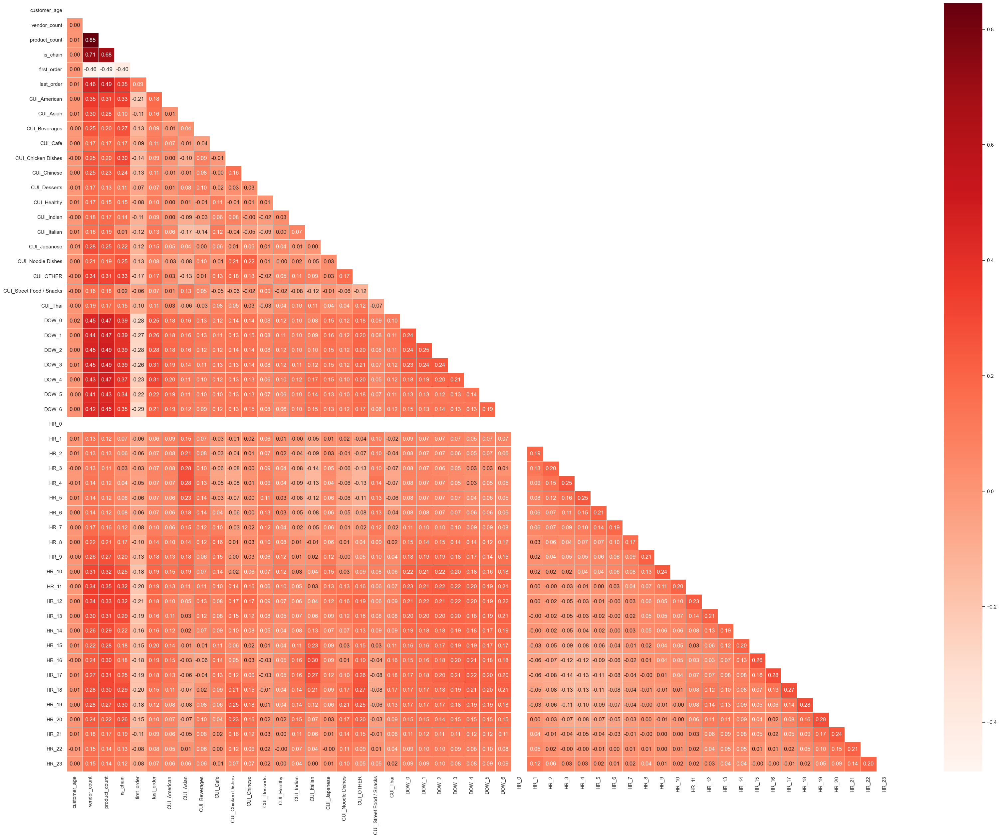

In [184]:
"""Numerical features: Analyzing feature redundancy (Spearman Correlation matrix)"""

cor_spearman = num_features_df.corr(method ='spearman')
cor_heatmap(cor_spearman)

### Key Notes on Spearman Correlation Matrix
- Since 'HR_0' values are always 0 or NaN, we can't compute it's correlation metric with the remaining features
- 'product_count' and 'vendor_count' are highly postively correlated (0.8).
- 'is_chain' highly positively correlated with 'product_count' and 'vendor_count' (0.7).
- All 'DOW' features are moderately correlated with 'vendor_count', 'product_count' and 'is_chain' (between 0.3 and 0.5)
-  'last_order' with 'vendor_count' and 'product_count' (0.5)
- All other correlation values are quite negligible 

---

### **`All numerical features pair plots`** Uncomment if you want to wait 10 min :)

In [185]:
"""Identifying 2-dimensional outliers (All scatter plots)"""

"""
sns.set()

sns.pairplot(num_features_df, diag_kind="hist")

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'Project', 'figures')):
    os.makedirs(os.path.join('..', 'Project', 'figures'))
    
plt.savefig(os.path.join('..', 'Project', 'figures', 'all numer features scatter plots.png'), dpi=200)

"""


'\nsns.set()\n\nsns.pairplot(num_features_df, diag_kind="hist")\n\nplt.subplots_adjust(top=0.95)\nplt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)\n\n# if the eda directory is not present then create it first\nif not os.path.exists(os.path.join(\'..\', \'Project\', \'figures\')):\n    os.makedirs(os.path.join(\'..\', \'Project\', \'figures\'))\n    \nplt.savefig(os.path.join(\'..\', \'Project\', \'figures\', \'all numer features scatter plots.png\'), dpi=200)\n\n'

### Key Notes

### - Each of us analyzes the rows corresponding to the features we got attributed?

<div class="alert alert-block alert-info" style="font-size:16px">

### b) Analyzing categorical features

### **`Cramer's V correlation`**

### Analyzing feature redundancy

> To calculate the correlation between two categorical variables, we will use the **Cramer's V correlation**.

#### **Cramer's V Correlation** <sup>[4]</sup>

A possible effect size for the very first test we did (the omnibus test known as Pearson Chi-square test) is Cramér's V (Cramér, 1946). This measure is actually designed for the chi-square test for independence but can be adjusted for the goodness-of-fit test (Kelley & Preacher, 2012, p. 145; Mangiafico, 2016, p. 474) <sup>[5]</sup><sup>[6]</sup>. It gives an estimate of how well the data then fits the expected values, where 0 would indicate that they are exactly equal. If you use the equal distributed expected values (as we did in the example) the maximum value would be 1, otherwise it could actually also exceed 1.

|Cohen w| Interpretation|
|-------|---------------|
|0 < .10| Negligible|
|0.10 < 0.30 |Small|
|0.30 < 0.50| Medium|
|0.50 or more| Large|

<br>


In [186]:
# Calculate the Cramer's V correlation matrix
# Source: https://stackoverflow.com/questions/46498455/categorical-features-correlation/46498792#46498792

def cramers_v_bias_correction(var1,var2):

    """
    Calculate Cramers V statistic for categorial-categorial association.
    uses correction from Bergsma and Wicher, Journal of the Korean Statistical Society 42 (2013): 323-328
    """
    contingency_table = pd.crosstab(var1,var2).values
    chi2 = ss.chi2_contingency(contingency_table)[0]
    n = contingency_table.sum()
    phi2 = chi2 / n
    r, k = contingency_table.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    r_corrected = r - ((r-1)**2)/(n-1)
    k_corrected = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((k_corrected-1), (r_corrected-1)))

# Building of the matrix
cramers_rows= []

for feature_1 in cat_features_df.columns:
  cramers_col = []
  for feature_2 in cat_features_df.columns:
    cramers = cramers_v_bias_correction(cat_features_df[feature_1], cat_features_df[feature_2]) # Cramer's V test
    cramers_col.append(round(cramers,2)) # Keeping of the rounded value of the Cramer's V
  cramers_rows.append(cramers_col)

cramers_matrix = np.array(cramers_rows)
cramers_matrix_df = pd.DataFrame(cramers_matrix, columns = cat_features_df.columns, index = cat_features_df.columns)
cramers_matrix_df

,customer_region,last_promo,payment_method,payment_method_combined,city
customer_region,1.00,0.05,0.05,0.05,1.00
last_promo,0.05,1.00,0.09,0.05,0.07
payment_method,0.05,0.09,1.00,1.00,0.05
payment_method_combined,0.05,0.05,1.00,1.00,0.05
city,1.00,0.07,0.05,0.05,1.00


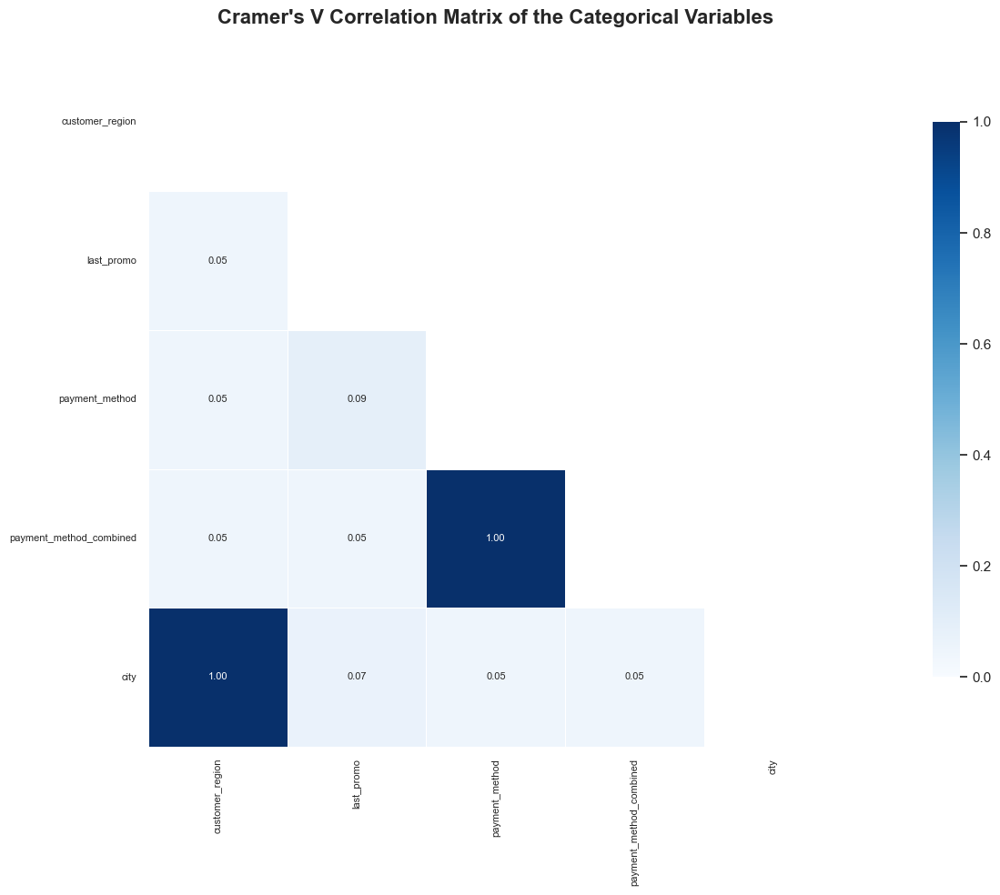

In [187]:
# Heatmap of the Cramer's V correlation matrix

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(cramers_matrix_df, dtype=bool))

# Plot the correlation matrix as a Heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(cramers_matrix_df,
            cmap='Blues',
            annot=True,    # Annotate all cells
            fmt='.2f',     # Display annotations as float numbers rounded to 2 decimal places
            annot_kws={'fontsize':8},
            cbar_kws={'shrink':0.8},
            vmin=0, vmax=1, center=0.5,
            linewidths=0.5, square=True,
            mask=mask)    # Apply the mask
plt.title("Cramer's V Correlation Matrix of the Categorical Variables\n", fontsize=16, fontweight='bold')
plt.xlabel('')
plt.ylabel('')
plt.xticks(ticks=np.arange(len(cramers_matrix_df.columns)) + 0.5, # Center the ticks
           labels=cramers_matrix_df.columns,
           fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()




### Key notes

#### - Al the categorical features have very low low Crammers V values.
#### - This means that the association between them is very low

---

### **`Categorical variables pairs`**

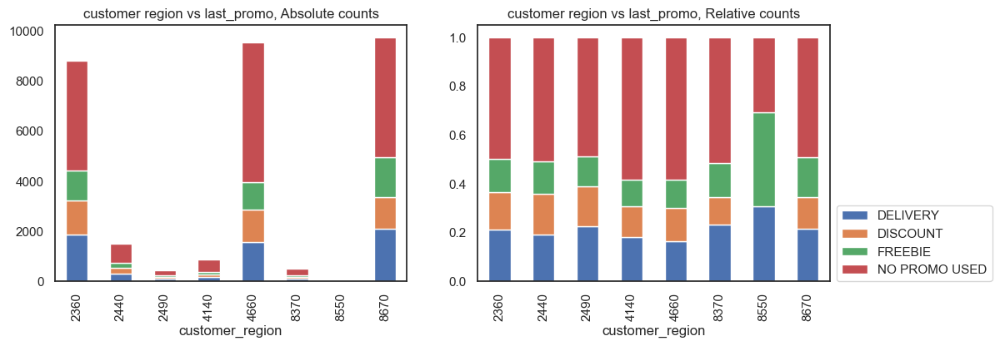

In [188]:
"""Categorical features: Analyzing pairs of categorical features with stacked bar plots"""

""" 1.0 'Customer_region' and 'last_promo' """

cat1 = 'customer_region'
cat2 = 'last_promo'

fig, axes = plt.subplots(1,2, figsize=(12,4))

catpc_df = df.groupby([cat1, cat2])[cat2].size().unstack()
catpc_df.plot.bar(stacked=True, ax=axes[0])
axes[0].set_title('customer region vs last_promo, Absolute counts')
axes[0].legend([], frameon=False) # hide legend on right subplot

catpc_df2 = df.groupby([cat1, cat2])[cat2].size() / df.groupby([cat1])[cat2].size() 
catpc_df2.unstack().plot.bar(stacked=True, ax=axes[1])
axes[1].set_title('customer region vs last_promo, Relative counts')
axes[1].legend(loc=(1.02,0)) # reposition legend on right subplot

plt.show()


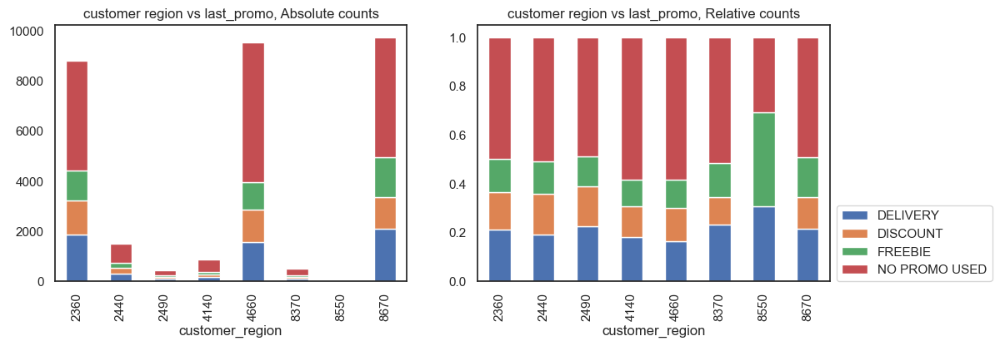

In [189]:
""" 1.1 'customer_region' and 'last_promo' after preprocessing 'customer_region' (removed value '-')  """
cat_features_df = cat_features_df.loc[cat_features_df["customer_region"] != '-']

cat1 = 'customer_region'
cat2 = 'last_promo'

fig, axes = plt.subplots(1,2, figsize=(12,4))

catpc_df = cat_features_df.groupby([cat1, cat2])[cat2].size().unstack()
catpc_df.plot.bar(stacked=True, ax=axes[0])
axes[0].set_title('customer region vs last_promo, Absolute counts')
axes[0].legend([], frameon=False) # hide legend on right subplot

catpc_df2 = cat_features_df.groupby([cat1, cat2])[cat2].size() / cat_features_df.groupby([cat1])[cat2].size() 
catpc_df2.unstack().plot.bar(stacked=True, ax=axes[1])
axes[1].set_title('customer region vs last_promo, Relative counts')
axes[1].legend(loc=(1.02,0)) # reposition legend on right subplot

plt.show()

### Key Notes
- 'No promo used' is the dominant category in all regions with the exception of a single region ('8550').
- In relative terms, Region 8550 has 2 important aspects to note:
    - First, promo code 'DISCOUNT' was never used
    - Second, it has the highest percentage of discounts used (highest % of 'FREEBIE' and highest % 'DELIVERY')

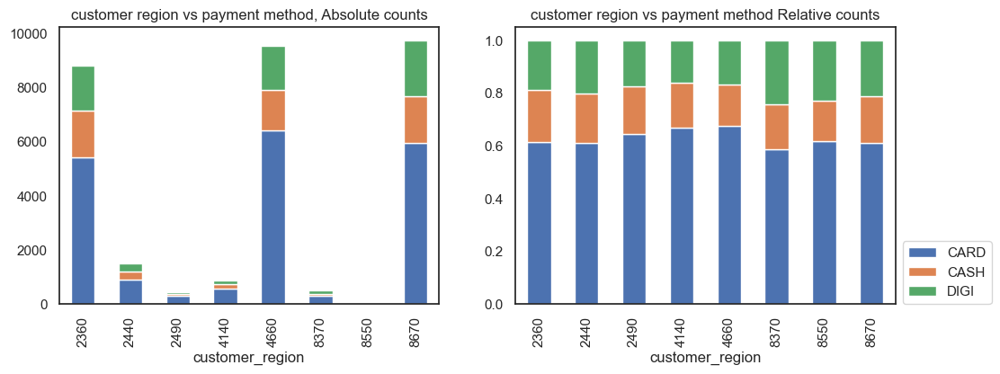

In [190]:
""" 2. 'customer_region' and 'payment_method' after preprocessing 'customer_region' (removed value '-')  """

cat1 = 'customer_region'
cat2 = 'payment_method'

fig, axes = plt.subplots(1,2, figsize=(12,4))

catpc_df = cat_features_df.groupby([cat1, cat2])[cat2].size().unstack()
catpc_df.plot.bar(stacked=True, ax=axes[0])
axes[0].set_title('customer region vs payment method, Absolute counts')
axes[0].legend([], frameon=False) # hide legend on right subplot

catpc_df2 = cat_features_df.groupby([cat1, cat2])[cat2].size() / cat_features_df.groupby([cat1])[cat2].size() 
catpc_df2.unstack().plot.bar(stacked=True, ax=axes[1])
axes[1].set_title('customer region vs payment method Relative counts')
axes[1].legend(loc=(1.02,0)) # reposition legend on right subplot

plt.show()

### Key Notes
- No matter if the region belongs to the most or least populated areas of the cities, the relative counts for each payment method category remain unchanged from region to region
- payment method doesn't not a good feature to distinguish customer regions

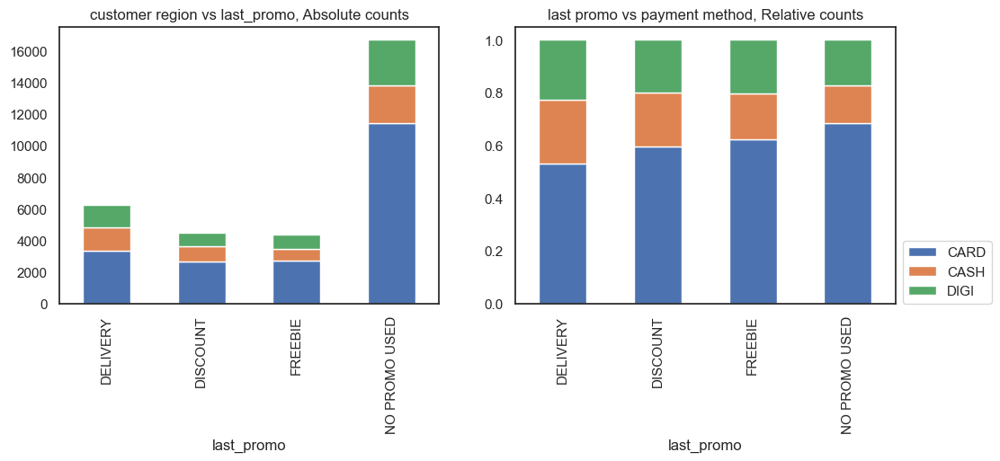

In [191]:
""" 3. 'last_promo' and 'payment_method' after preprocessing 'customer_region' (removed value '-')  """

cat1 = 'last_promo'
cat2 = 'payment_method'

fig, axes = plt.subplots(1,2, figsize=(12,4))

catpc_df = cat_features_df.groupby([cat1, cat2])[cat2].size().unstack()
catpc_df.plot.bar(stacked=True, ax=axes[0])
axes[0].set_title('customer region vs last_promo, Absolute counts')
axes[0].legend([], frameon=False) # hide legend on right subplot

catpc_df2 = cat_features_df.groupby([cat1, cat2])[cat2].size() / cat_features_df.groupby([cat1])[cat2].size() 
catpc_df2.unstack().plot.bar(stacked=True, ax=axes[1])
axes[1].set_title('last promo vs payment method, Relative counts')
axes[1].legend(loc=(1.02,0)) # reposition legend on right subplot

plt.show()

<div class="alert alert-block alert-info" style="font-size:16px">

### c) Analyzing categorical vs numerical features

In [192]:
df

,customer_region,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,City 2,18.0,2,5,1,0,1,DELIVERY,DIGI,...,0,0,0,2,0,0,0,0,0,Online
5d272b9dcb,8670,City 8,17.0,2,2,2,0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,Online
f6d1b2ba63,4660,City 4,38.0,1,2,2,0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,In Person
180c632ed8,4660,City 4,NaN,2,3,1,0,2,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,Online
4eb37a6705,4660,City 4,20.0,2,5,0,0,2,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,0,Online
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,8670,City 8,30.0,1,1,1,<NA>,0,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,0,Online
f6b6709018,8670,City 8,NaN,1,1,0,<NA>,0,DELIVERY,DIGI,...,0,1,0,0,0,0,0,0,0,Online
f74ad8ce3f,8670,City 8,24.0,1,1,1,<NA>,0,NO PROMO USED,DIGI,...,0,0,0,0,0,0,0,0,0,Online


### **`Pair Plot of Numerical Features with Grouping by categorical feature`** Uncomment if you want to wait 20 min :)

In [193]:
"""Pair plots with x and y numerical with hue= 'customer_region'  """

"""
sns.set()
num_features_cols = list(num_features_df.columns)

# Setting pairplot
sns.pairplot(df[num_features_cols + ['city']], diag_kind="hist", hue='city')

# Layout
plt.suptitle("Pairwise Relationships Between Numerical Features, Colored by Customer Region", fontsize=20)

plt.show()

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'Project', 'figures')):
    os.makedirs(os.path.join('..', 'Project', 'figures'))
    
plt.savefig(os.path.join('..', 'Project', 'figures', 'Pairwise Relationships Between num features, Colored by Customer Region.png'), dpi=200)
"""

'\nsns.set()\nnum_features_cols = list(num_features_df.columns)\n\n# Setting pairplot\nsns.pairplot(df[num_features_cols + [\'city\']], diag_kind="hist", hue=\'city\')\n\n# Layout\nplt.suptitle("Pairwise Relationships Between Numerical Features, Colored by Customer Region", fontsize=20)\n\nplt.show()\n\n# if the eda directory is not present then create it first\nif not os.path.exists(os.path.join(\'..\', \'Project\', \'figures\')):\n    os.makedirs(os.path.join(\'..\', \'Project\', \'figures\'))\n    \nplt.savefig(os.path.join(\'..\', \'Project\', \'figures\', \'Pairwise Relationships Between num features, Colored by Customer Region.png\'), dpi=200)\n'

In [194]:
"""Pair plots with x and y numerical with hue= 'last_promo'  """
"""
sns.set()
num_features_cols = list(num_features_df.columns)

# Setting pairplot
sns.pairplot(df[num_features_cols + ['customer_region']], diag_kind="hist", hue='customer_region')

# Layout
plt.suptitle("Pairwise Relationships Between Numerical Features, Colored by Customer Region", fontsize=20)

plt.show()

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'Project', 'figures')):
    os.makedirs(os.path.join('..', 'Project', 'figures'))
    
plt.savefig(os.path.join('..', 'Project', 'figures', 'Pairwise Relationships Between num features, Colored by Last Promo.png'), dpi=200)
"""

'\nsns.set()\nnum_features_cols = list(num_features_df.columns)\n\n# Setting pairplot\nsns.pairplot(df[num_features_cols + [\'customer_region\']], diag_kind="hist", hue=\'customer_region\')\n\n# Layout\nplt.suptitle("Pairwise Relationships Between Numerical Features, Colored by Customer Region", fontsize=20)\n\nplt.show()\n\n# if the eda directory is not present then create it first\nif not os.path.exists(os.path.join(\'..\', \'Project\', \'figures\')):\n    os.makedirs(os.path.join(\'..\', \'Project\', \'figures\'))\n    \nplt.savefig(os.path.join(\'..\', \'Project\', \'figures\', \'Pairwise Relationships Between num features, Colored by Last Promo.png\'), dpi=200)\n'

In [195]:
"""Pair plots with x and y numerical with hue= 'payment method'  """
"""
sns.set()
num_features_cols = list(num_features_df.columns)

# Setting pairplot
sns.pairplot(df[num_features_cols + ['customer_region']], diag_kind="hist", hue='customer_region')

# Layout
plt.suptitle("Pairwise Relationships Between Numerical Features, Colored by Last Promo", fontsize=20)

plt.show()

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'Project', 'figures')):
    os.makedirs(os.path.join('..', 'Project', 'figures'))
    
plt.savefig(os.path.join('..', 'Project', 'figures', 'Pairwise Relationships Between num features, Colored by Payment Method.png'), dpi=200)
"""

'\nsns.set()\nnum_features_cols = list(num_features_df.columns)\n\n# Setting pairplot\nsns.pairplot(df[num_features_cols + [\'customer_region\']], diag_kind="hist", hue=\'customer_region\')\n\n# Layout\nplt.suptitle("Pairwise Relationships Between Numerical Features, Colored by Last Promo", fontsize=20)\n\nplt.show()\n\n# if the eda directory is not present then create it first\nif not os.path.exists(os.path.join(\'..\', \'Project\', \'figures\')):\n    os.makedirs(os.path.join(\'..\', \'Project\', \'figures\'))\n    \nplt.savefig(os.path.join(\'..\', \'Project\', \'figures\', \'Pairwise Relationships Between num features, Colored by Payment Method.png\'), dpi=200)\n'

<div class="alert alert-block alert-info" style="font-size:16px">

### d) PCA to formulate hypothesis on most important numeric features 

In [196]:
df_pca = df.copy()
df_pca.columns

Index(['customer_region', 'city', 'customer_age', 'vendor_count',
       'product_count', 'is_chain', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American', 'CUI_Asian', 'CUI_Beverages',
       'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts',
       'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese',
       'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks',
       'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5',
       'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7',
       'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15',
       'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23',
       'payment_method_combined'],
      dtype='object')

In [197]:
"Drop irrelevant features"
columns_stay = [element for element in df_pca.columns if element not in ["customer_region", "tot_orders_per_client_HR"]]
df_pca = df_pca[columns_stay]

"""Drop NaN values because PCA doesn't know how to handle them """
df_pca_no_nan = df_pca.dropna()

In [198]:
num_features = [element for element in df_pca_no_nan.columns if element != 'city' and element != 'last_promo' and 'payment_method' not in str(element) and element != 'client_activity_flag' ]
cat_features = [element for element in df_pca_no_nan.columns if element not in num_features]
num_features_df = df_pca_no_nan[num_features]
cat_features_df = df_pca_no_nan[cat_features]

In [199]:
num_features_df.columns

Index(['customer_age', 'vendor_count', 'product_count', 'is_chain',
       'first_order', 'last_order', 'CUI_American', 'CUI_Asian',
       'CUI_Beverages', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese',
       'CUI_Desserts', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian',
       'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER',
       'CUI_Street Food / Snacks', 'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2',
       'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3',
       'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11',
       'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19',
       'HR_20', 'HR_21', 'HR_22', 'HR_23'],
      dtype='object')

### **`Normalize Data`** 

In [200]:
scaler = StandardScaler()
scaler.fit(num_features_df)
num_features_scaled = scaler.transform(num_features_df)
num_features_scaled_df = pd.DataFrame(num_features_scaled, columns = num_features_df.columns).set_index(num_features_df.index)
num_features_scaled_df

,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,-1.324993,-0.386091,-0.078925,-0.454749,-1.188546,-2.721841,-0.413809,-0.418438,-0.266998,-0.126293,...,-0.358521,-0.377307,-0.413877,-0.420345,1.829239,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005
5d272b9dcb,-1.464367,-0.386091,-0.519947,-0.198230,-1.188546,-2.721841,0.712456,-0.125250,-0.266998,-0.126293,...,-0.358521,-0.377307,-0.413877,-0.420345,-0.381714,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005
f6d1b2ba63,1.462489,-0.757834,-0.519947,-0.198230,-1.188546,-2.721841,0.394431,-0.418438,-0.266998,-0.126293,...,-0.358521,-0.377307,-0.413877,-0.420345,-0.381714,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005
4eb37a6705,-1.046245,-0.386091,-0.078925,-0.711268,-1.188546,-2.678411,0.866197,1.456772,-0.266998,-0.126293,...,-0.358521,-0.377307,-0.413877,-0.420345,-0.381714,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005
6aef2b6726,1.741237,-0.386091,-0.519947,-0.711268,-1.188546,-2.678411,-0.413809,0.724949,-0.266998,-0.126293,...,-0.358521,-0.377307,-0.413877,-0.420345,-0.381714,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
e9a301b9b8,1.601863,-0.757834,-0.666954,-0.454749,2.492045,1.099996,-0.104570,-0.418438,-0.266998,-0.126293,...,-0.358521,0.959445,-0.413877,-0.420345,-0.381714,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005
eb13c834e7,6.479958,-0.757834,-0.666954,-0.454749,2.492045,1.099996,-0.413809,-0.418438,-0.266998,-0.126293,...,-0.358521,-0.377307,-0.413877,-0.420345,-0.381714,0.944881,-0.242397,-0.20317,-0.153827,-0.147005
f7be3a1a84,-0.210000,-0.757834,-0.666954,-0.454749,2.492045,1.099996,-0.413809,-0.418438,-0.266998,-0.126293,...,-0.358521,0.959445,-0.413877,-0.420345,-0.381714,-0.311960,-0.242397,-0.20317,-0.153827,-0.147005


In [201]:
len(num_features_scaled_df.columns)

52

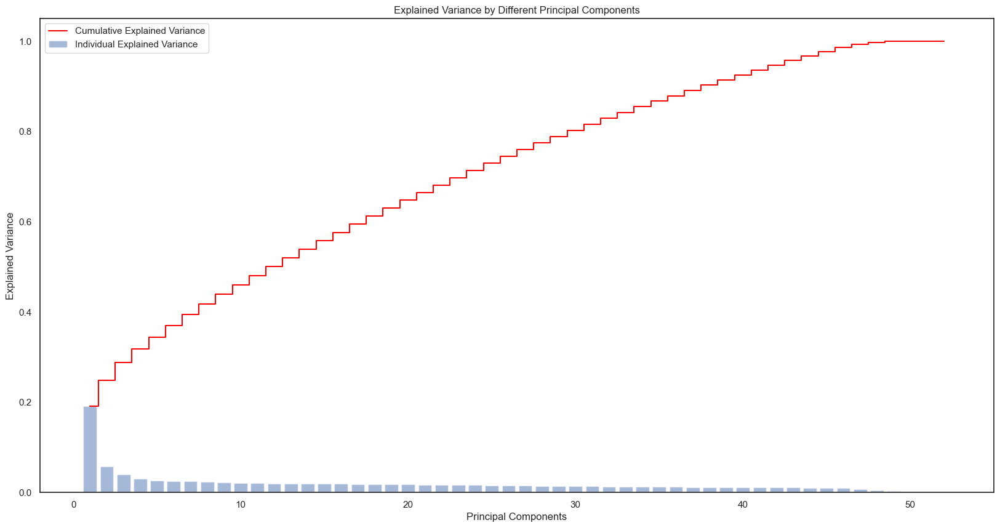

In [202]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

# Apply PCA
pca = PCA()
pca.fit(num_features_scaled)

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Plotting the explained variance
plt.figure(figsize=(20, 10))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Individual Explained Variance')
plt.step(range(1, len(cumulative_variance) + 1), cumulative_variance, where='mid',
         label='Cumulative Explained Variance', color='red')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Different Principal Components')
plt.legend()
plt.show()


In [203]:
pca = PCA(0.70)
num_features_pca = pca.fit_transform(num_features_scaled_df)

num_components = pca.n_components_
print("Number of components selected:", num_components)

Number of components selected: 24


In [204]:
pca.explained_variance_ratio_.cumsum()

array([0.19087269, 0.24806154, 0.28842213, 0.31856879, 0.34425547,
       0.369447  , 0.3936469 , 0.41730459, 0.43887928, 0.45986568,
       0.48010491, 0.50004393, 0.51955954, 0.53859649, 0.55730609,
       0.5759742 , 0.59430565, 0.61250402, 0.6300697 , 0.64741763,
       0.66424935, 0.68098077, 0.69747025, 0.71369109])

In [205]:
loadings = pd.DataFrame(pca.components_.T, columns=[f"Comp{i+1}" for i in range(pca.n_components_)], index=num_features_scaled_df.columns)
display(loadings)

,Comp1,Comp2,Comp3,Comp4,Comp5,Comp6,Comp7,Comp8,Comp9,Comp10,...,Comp15,Comp16,Comp17,Comp18,Comp19,Comp20,Comp21,Comp22,Comp23,Comp24
customer_age,0.001970,-0.000143,-9.422760e-03,-1.063842e-02,-6.756939e-03,-3.858217e-03,-5.171245e-02,-1.861504e-02,3.024231e-02,9.325975e-02,...,-3.418906e-02,-1.442895e-02,9.991219e-02,1.929261e-02,7.601340e-02,3.540931e-03,-1.925589e-02,6.595827e-02,1.824288e-02,-2.176996e-02
vendor_count,0.278194,0.066302,8.385029e-02,-3.402788e-02,-3.665789e-02,-2.920685e-03,-4.340128e-03,8.557094e-03,2.229306e-03,-4.286299e-03,...,8.181402e-03,4.614948e-02,4.732703e-02,5.420244e-03,-2.275419e-02,-2.165158e-02,-1.691695e-02,-9.400807e-03,1.035076e-02,-2.610030e-02
product_count,0.312501,0.033622,6.700281e-03,-2.614336e-02,-1.562984e-02,-1.468569e-03,-7.493357e-03,5.924639e-03,-1.862202e-02,6.114484e-02,...,3.030117e-02,-3.801310e-02,-1.022237e-02,-3.613855e-02,-1.318633e-02,-1.979793e-02,8.918724e-03,-1.350402e-02,1.254290e-03,-2.217969e-02
is_chain,0.282926,-0.031059,1.068924e-01,1.026840e-01,-1.944890e-02,9.292071e-04,5.805981e-03,3.776824e-04,6.779479e-02,-4.570240e-02,...,1.956966e-03,7.104012e-02,1.536109e-03,6.864043e-02,-5.310948e-03,1.777453e-02,-1.099951e-01,-2.224702e-02,4.396897e-02,3.598440e-02
first_order,-0.126865,-0.011682,-3.011148e-02,5.824644e-02,1.334772e-01,1.069701e-01,-6.381152e-01,2.103630e-01,1.168957e-01,2.484197e-02,...,-4.984380e-02,-2.312621e-02,-4.084254e-02,1.778084e-02,-1.804133e-02,-9.035707e-03,-3.998737e-02,-7.166550e-03,-1.019622e-02,-2.468091e-02
last_order,0.122358,0.055004,-6.323498e-02,-7.941182e-02,9.994069e-02,6.913180e-02,-6.349563e-01,2.254061e-01,1.031276e-01,-9.054036e-03,...,1.360501e-02,-4.428501e-03,3.256462e-02,4.555521e-03,-4.240759e-02,3.418711e-02,3.645500e-02,4.901530e-02,5.358651e-02,1.450201e-02
CUI_American,0.111073,0.077616,-1.533908e-01,-2.195380e-01,-1.967790e-02,5.822277e-02,9.667632e-02,-3.620244e-02,2.393357e-01,-7.220585e-03,...,-1.729098e-01,2.160723e-02,-4.722352e-02,7.212809e-02,-1.686520e-02,2.937175e-01,-3.059259e-01,6.140163e-02,2.753605e-01,5.185320e-01
CUI_Asian,0.076846,0.359379,-7.307997e-03,-1.821939e-01,-9.868474e-02,8.528631e-02,-3.073734e-02,-2.829882e-02,-6.075748e-02,4.252877e-02,...,6.572597e-02,-2.223380e-02,-1.629026e-01,-1.886771e-01,1.007133e-01,-1.631427e-01,1.112158e-01,-1.111268e-01,-3.887945e-02,-1.307543e-01
CUI_Beverages,0.068134,0.193096,1.388590e-01,1.611231e-01,5.421213e-02,-2.057604e-01,3.140529e-02,1.348762e-01,9.064749e-02,-1.333732e-01,...,2.125368e-01,-1.281988e-01,-5.070943e-02,1.544967e-01,-3.105001e-02,4.079555e-01,-1.599159e-01,9.028311e-02,-2.071195e-01,-2.172978e-01
CUI_Cafe,0.093515,0.011682,-2.045939e-01,2.522526e-01,2.032808e-01,1.083204e-01,8.648866e-02,-7.892217e-03,3.619048e-02,6.051916e-02,...,-3.636743e-01,3.819802e-02,-3.180286e-01,5.229286e-02,5.695851e-02,-3.149911e-01,6.441229e-03,-2.017448e-02,-2.404018e-02,-1.042554e-01


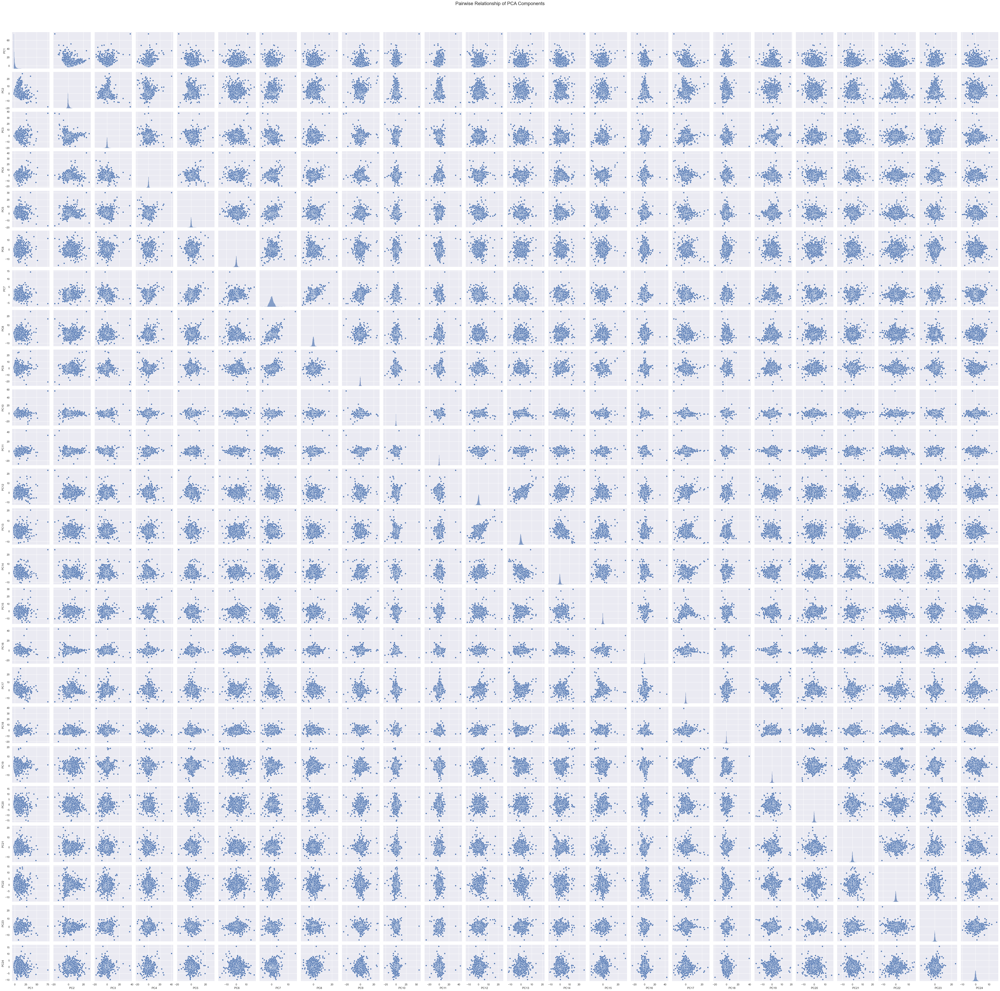

In [206]:
# Assuming num_features_pca is your transformed PCA data and pca is the fitted PCA object
# Convert PCA-transformed data into a DataFrame
columns_pca = [f"PC{i+1}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(num_features_pca, columns=columns_pca)

# Plotting pair plot for PCA components
sns.set()
sns.pairplot(pca_df, diag_kind="hist")

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of PCA Components", fontsize=20)

# Save the plot
if not os.path.exists(os.path.join('..', 'Project', 'figures')):
    os.makedirs(os.path.join('..', 'Project', 'figures'))

plt.savefig(os.path.join('..', 'Project', 'figures', 'pca_components_pairplot.png'), dpi=200)
plt.show()


---

<div class="alert alert-block alert-info" style="font-size:16px">

## 6.2 Analyzing df_fe features

In [207]:
"""
Notes. 
Selecting only a subset of df columns. 
1. Selecting the feature engineered columns and removing the features they aim to replace in order to reduce inout space dimensionality
"""

df_fe_only = df_fe.copy()
columns_to_remove = [element for element in df_fe_only if element == 'customer_region' or element == 'payment_method' or 'CUI' in element or 'DOW' in element or 'HR' in element or element == 'tot_orders_per_client_HR']
columns_to_stay = [element for element in df_fe_only if element not in columns_to_remove]
df_fe_only = df_fe_only[columns_to_stay]
df_fe_only.columns

Index(['city', 'customer_age', 'vendor_count', 'product_count', 'is_chain',
       'first_order', 'last_order', 'last_promo', 'payment_method_combined',
       'client_activity_flag', 'tot_orders_per_client',
       'tot_money_spent_per_client', 'purchased_American', 'purchased_Asian',
       'purchased_Beverages', 'purchased_Cafe', 'purchased_Chicken Dishes',
       'purchased_Chinese', 'purchased_Desserts', 'purchased_Healthy',
       'purchased_Indian', 'purchased_Italian', 'purchased_Japanese',
       'purchased_Noodle Dishes', 'purchased_OTHER',
       'purchased_Street Food / Snacks', 'purchased_Thai',
       'num_unique_cuisines_tried', 'peak_days_num_orders',
       'off_peak_days_num_orders', 'client_order_behaviour',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders'],
      dtype='object')

In [208]:
"""Spliting the features into """

# In categorical features I am not including the categorical/binary features that are already hot encoded
cat_features = ["city", "last_promo", "payment_method_combined", "client_activity_flag"]
num_features = [element for element in df_fe_only.columns if element not in cat_features]
cat_features_df = df_fe_only[cat_features]
num_features_df = df_fe_only.drop(columns=cat_features)
num_features_df

,customer_age,vendor_count,product_count,is_chain,first_order,last_order,tot_orders_per_client,tot_money_spent_per_client,purchased_American,purchased_Asian,...,purchased_Street Food / Snacks,purchased_Thai,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,client_order_behaviour,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,18.0,2,5,1,0,1,2,28.88,0,0,...,0,0,1,1,1,0,0,0,2,0
5d272b9dcb,17.0,2,2,2,0,1,2,19.21,1,1,...,0,0,2,1,1,0,2,0,0,0
f6d1b2ba63,38.0,1,2,2,0,1,2,9.20,1,0,...,0,0,1,1,1,0,2,0,0,0
180c632ed8,NaN,2,3,1,0,2,2,31.56,0,1,...,0,0,2,1,1,0,1,1,0,0
4eb37a6705,20.0,2,5,0,0,2,2,55.44,1,1,...,0,0,2,1,1,0,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,30.0,1,1,1,<NA>,0,1,18.04,0,0,...,0,0,1,1,0,1,0,1,0,0
f6b6709018,NaN,1,1,0,<NA>,0,1,18.04,1,0,...,0,0,1,1,0,1,0,1,0,0
f74ad8ce3f,24.0,1,1,1,<NA>,0,1,17.79,0,0,...,0,0,1,1,0,1,0,0,0,1


<div class="alert alert-block alert-info" style="font-size:16px">

### a) Analyzing Numerical features

### **`Spearman Correlation matrix`**

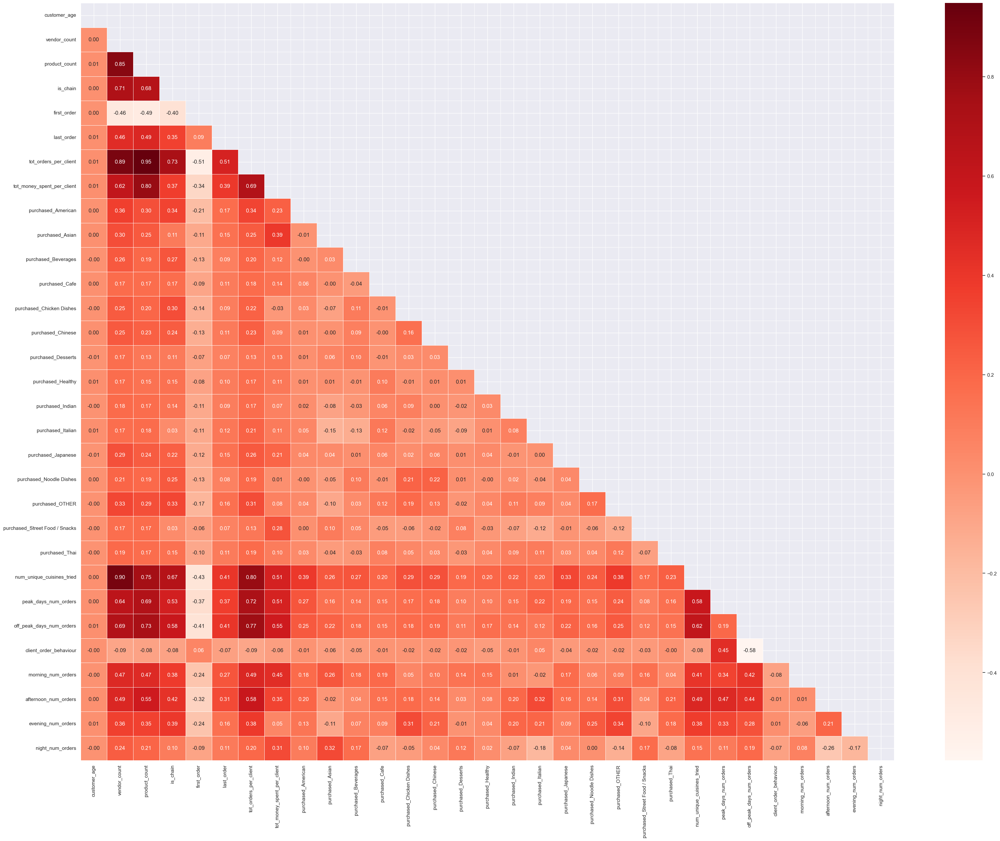

In [209]:
"""Numerical features: Analyzing feature redundancy (Spearman Correlation matrix)"""
cor_spearman = num_features_df.corr(method ='spearman')
cor_heatmap(cor_spearman)

### **`Cramer's V Correlation matrix`**

In [210]:
# Calculate the Cramer's V correlation matrix
# Source: https://stackoverflow.com/questions/46498455/categorical-features-correlation/46498792#46498792

def cramers_v_bias_correction(var1,var2):

    """
    Calculate Cramers V statistic for categorial-categorial association.
    uses correction from Bergsma and Wicher, Journal of the Korean Statistical Society 42 (2013): 323-328
    """
    contingency_table = pd.crosstab(var1,var2).values
    chi2 = ss.chi2_contingency(contingency_table)[0]
    n = contingency_table.sum()
    phi2 = chi2 / n
    r, k = contingency_table.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    r_corrected = r - ((r-1)**2)/(n-1)
    k_corrected = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((k_corrected-1), (r_corrected-1)))

# Building of the matrix
cramers_rows= []

for feature_1 in cat_features_df.columns:
  cramers_col = []
  for feature_2 in cat_features_df.columns:
    cramers = cramers_v_bias_correction(cat_features_df[feature_1], cat_features_df[feature_2]) # Cramer's V test
    cramers_col.append(round(cramers,2)) # Keeping of the rounded value of the Cramer's V
  cramers_rows.append(cramers_col)

cramers_matrix = np.array(cramers_rows)
cramers_matrix_df = pd.DataFrame(cramers_matrix, columns = cat_features_df.columns, index = cat_features_df.columns)
cramers_matrix_df

,city,last_promo,payment_method_combined,client_activity_flag
city,1.00,0.07,0.05,0.06
last_promo,0.07,1.00,0.05,0.18
payment_method_combined,0.05,0.05,1.00,0.11
client_activity_flag,0.06,0.18,0.11,1.00


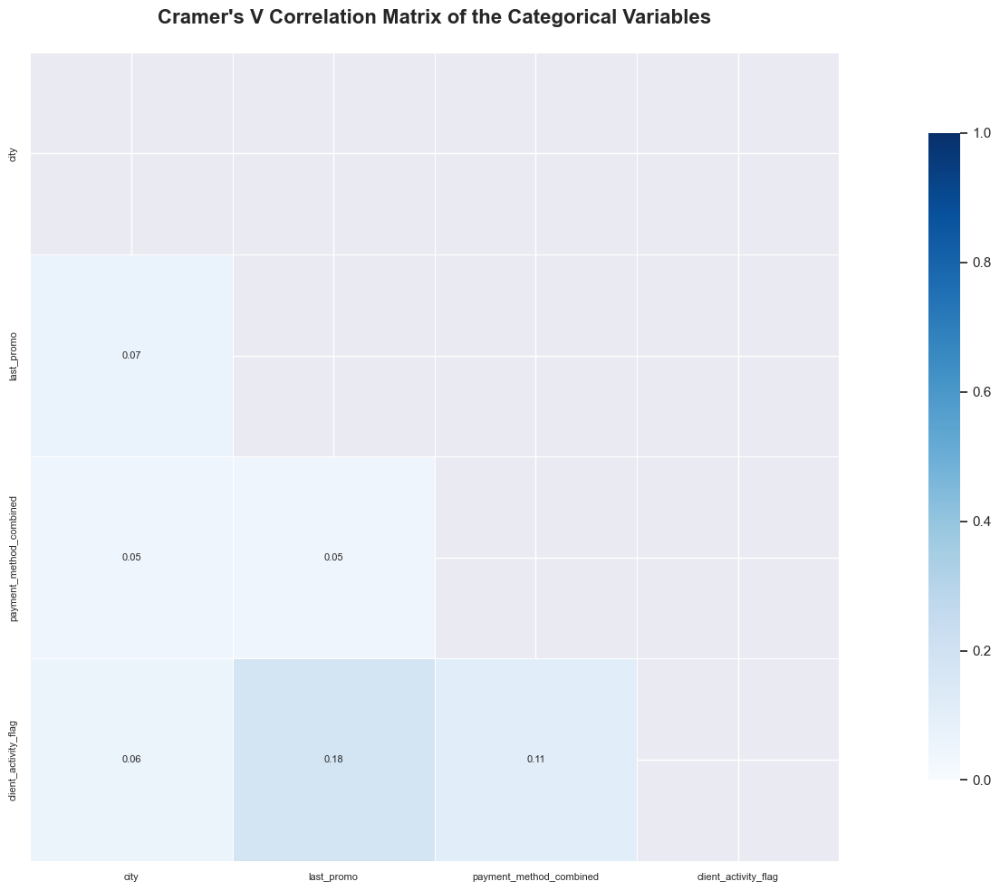

In [211]:
# Heatmap of the Cramer's V correlation matrix

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(cramers_matrix_df, dtype=bool))

# Plot the correlation matrix as a Heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(cramers_matrix_df,
            cmap='Blues',
            annot=True,    # Annotate all cells
            fmt='.2f',     # Display annotations as float numbers rounded to 2 decimal places
            annot_kws={'fontsize':8},
            cbar_kws={'shrink':0.8},
            vmin=0, vmax=1, center=0.5,
            linewidths=0.5, square=True,
            mask=mask)    # Apply the mask
plt.title("Cramer's V Correlation Matrix of the Categorical Variables\n", fontsize=16, fontweight='bold')
plt.xlabel('')
plt.ylabel('')
plt.xticks(ticks=np.arange(len(cramers_matrix_df.columns)) + 0.5, # Center the ticks
           labels=cramers_matrix_df.columns,
           fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()




<div class="alert alert-block alert-info" style="font-size:16px">

### d) PCA to formulate hypothesis on most important numeric features 

### **`PCA to formulate hypothesis on most important features`**

In [212]:
df_fe_only_pca = df_fe_only.copy()
df_fe_only_pca

,city,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method_combined,client_activity_flag,...,purchased_Street Food / Snacks,purchased_Thai,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,client_order_behaviour,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,City 2,18.0,2,5,1,0,1,DELIVERY,Online,inactive,...,0,0,1,1,1,0,0,0,2,0
5d272b9dcb,City 8,17.0,2,2,2,0,1,DISCOUNT,Online,inactive,...,0,0,2,1,1,0,2,0,0,0
f6d1b2ba63,City 4,38.0,1,2,2,0,1,DISCOUNT,In Person,inactive,...,0,0,1,1,1,0,2,0,0,0
180c632ed8,City 4,NaN,2,3,1,0,2,DELIVERY,Online,inactive,...,0,0,2,1,1,0,1,1,0,0
4eb37a6705,City 4,20.0,2,5,0,0,2,NO PROMO USED,Online,inactive,...,0,0,2,1,1,0,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,City 8,30.0,1,1,1,<NA>,0,FREEBIE,Online,NaN,...,0,0,1,1,0,1,0,1,0,0
f6b6709018,City 8,NaN,1,1,0,<NA>,0,DELIVERY,Online,NaN,...,0,0,1,1,0,1,0,1,0,0
f74ad8ce3f,City 8,24.0,1,1,1,<NA>,0,NO PROMO USED,Online,NaN,...,0,0,1,1,0,1,0,0,0,1


In [213]:
"""Drop NaN values because PCA doesn't know how to handle them """
df_fe_only_pca.dropna(inplace=True)

In [214]:
"""PCA only handles numeric features"""
num_features_pca = df_fe_only_pca[num_features]

### **`Normalize Data`** 

In [215]:
scaler = StandardScaler()
scaler.fit(num_features_pca)
num_features_scaled = scaler.transform(num_features_pca)
num_features_scaled_df = pd.DataFrame(num_features_scaled, columns = num_features_pca.columns).set_index(num_features_pca.index)
num_features_scaled_df

,customer_age,vendor_count,product_count,is_chain,first_order,last_order,tot_orders_per_client,tot_money_spent_per_client,purchased_American,purchased_Asian,...,purchased_Street Food / Snacks,purchased_Thai,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,client_order_behaviour,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,-1.326309,-0.399609,-0.098758,-0.458995,-1.180982,-2.738165,-0.467745,-0.200216,-0.717144,-0.766184,...,-0.388354,-0.285753,-0.861596,-0.413325,-0.420498,-0.806403,-0.53902,-0.659957,0.658903,-0.399021
5d272b9dcb,-1.465762,-0.399609,-0.527927,-0.209050,-1.180982,-2.738165,-0.467745,-0.409008,1.394420,1.305170,...,-0.388354,-0.285753,-0.190912,-0.413325,-0.420498,-0.806403,0.34434,-0.659957,-0.448083,-0.399021
f6d1b2ba63,1.462750,-0.759030,-0.527927,-0.209050,-1.180982,-2.738165,-0.467745,-0.625142,1.394420,-0.766184,...,-0.388354,-0.285753,-0.861596,-0.413325,-0.420498,-0.806403,0.34434,-0.659957,-0.448083,-0.399021
4eb37a6705,-1.047403,-0.399609,-0.098758,-0.708939,-1.180982,-2.694627,-0.467745,0.373260,1.394420,1.305170,...,-0.388354,-0.285753,-0.190912,-0.413325,-0.420498,-0.806403,0.34434,-0.659957,-0.448083,-0.399021
6aef2b6726,1.741656,-0.399609,-0.527927,-0.708939,-1.180982,-2.694627,-0.467745,-0.285720,-0.717144,1.305170,...,-0.388354,-0.285753,-0.861596,-0.413325,-0.420498,-0.806403,-0.53902,-0.659957,-0.448083,1.049897
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
eb13c834e7,6.483056,-0.759030,-0.670983,-0.458995,2.513729,1.093258,-0.663512,-0.786000,-0.717144,-0.766184,...,-0.388354,-0.285753,-0.861596,-0.413325,-0.732575,1.240074,-0.53902,-0.659957,0.105410,-0.399021
f7be3a1a84,-0.210685,-0.759030,-0.670983,-0.458995,2.513729,1.093258,-0.663512,-0.783625,-0.717144,-0.766184,...,-0.388354,-0.285753,-0.861596,-0.413325,-0.732575,1.240074,-0.53902,-0.295052,-0.448083,-0.399021
fc924e1758,-1.047403,-0.759030,-0.527927,-0.708939,2.513729,1.093258,-0.663512,-0.323937,-0.717144,-0.766184,...,-0.388354,-0.285753,-0.861596,-0.413325,-0.732575,1.240074,-0.53902,-0.295052,-0.448083,-0.399021


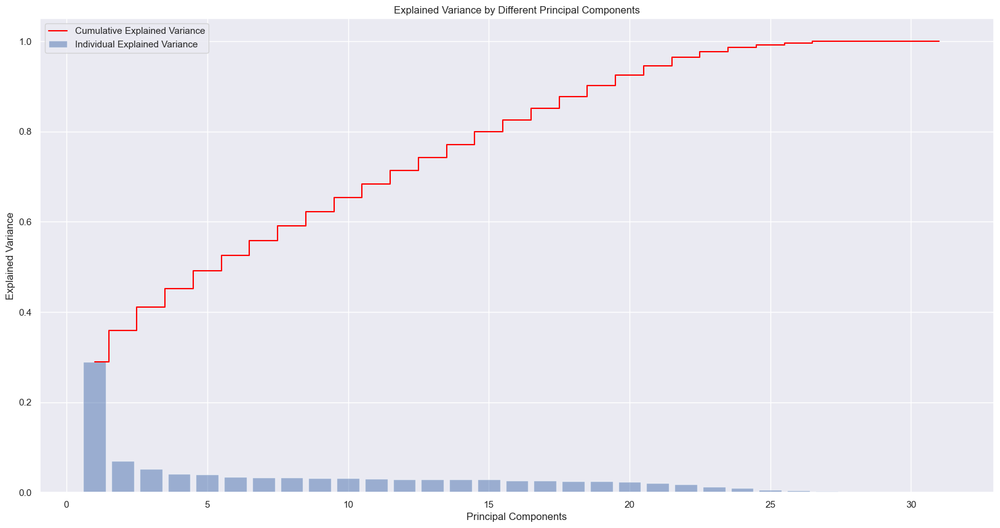

In [216]:
# Apply PCA
pca = PCA()
pca.fit(num_features_scaled_df)

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Plotting the explained variance
plt.figure(figsize=(20, 10))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Individual Explained Variance')
plt.step(range(1, len(cumulative_variance) + 1), cumulative_variance, where='mid',
         label='Cumulative Explained Variance', color='red')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Different Principal Components')
plt.legend()
plt.show()


In [217]:
pca = PCA(0.95)
num_features_pca_transform = pca.fit_transform(num_features_scaled_df)

num_components = pca.n_components_
print("Number of components selected:", num_components)

Number of components selected: 22


In [218]:
pca.explained_variance_ratio_.cumsum()

array([0.2887238 , 0.35850603, 0.41087282, 0.45144499, 0.49072173,
       0.52480662, 0.5576395 , 0.59030098, 0.62252773, 0.65348209,
       0.6839684 , 0.71301682, 0.74183181, 0.77043607, 0.79874174,
       0.8253576 , 0.85155376, 0.87641928, 0.90103451, 0.92435732,
       0.9454549 , 0.96368005])

In [219]:
def _color_red_or_green(val):
    if val < -0.30:
        color = 'background-color: red'
    elif val > 0.30:
        color = 'background-color: green'
    else:
        color = ''
    return color

loadings_df = pd.DataFrame(pca.components_.T, columns=[f"Comp{i+1}" for i in range(pca.n_components_)], index=num_features_scaled_df.columns)
loadings_df.style.applymap(_color_red_or_green)


,Comp1,Comp2,Comp3,Comp4,Comp5,Comp6,Comp7,Comp8,Comp9,Comp10,Comp11,Comp12,Comp13,Comp14,Comp15,Comp16,Comp17,Comp18,Comp19,Comp20,Comp21,Comp22
customer_age,0.001537,0.002341,0.018687,-0.014156,0.048047,0.095592,-0.180765,0.275048,0.922752,-0.084491,-0.120734,-0.053146,0.049438,0.008235,-0.001802,-0.004164,0.018064,-0.000526,-0.017963,0.000905,-0.009694,0.015649
vendor_count,0.307032,0.036603,-0.079341,0.016828,0.020788,0.001985,0.009546,-0.133116,0.033753,-0.049810,-0.035147,0.013705,-0.031112,-0.034116,-0.025550,-0.094175,-0.088358,0.013908,0.021810,0.000938,-0.032173,0.061519
product_count,0.318683,0.056202,0.064206,0.029773,-0.007936,0.029023,-0.005733,0.161738,-0.049851,0.021347,0.029242,-0.024047,0.018037,0.041897,0.039090,0.063533,0.068030,-0.024541,-0.001182,0.055300,0.036703,-0.044127
is_chain,0.293791,-0.075883,-0.075628,-0.008483,-0.001151,-0.020428,0.014999,0.070405,-0.006935,0.070534,0.068728,-0.004087,0.080522,0.034210,-0.006835,0.137191,0.086051,0.011311,-0.015215,-0.011932,0.094523,0.036369
first_order,-0.141862,0.020847,0.089755,-0.161523,0.665626,0.056003,0.046194,0.086888,-0.053335,0.099412,0.069679,-0.003323,0.040766,0.029536,-0.021081,0.088389,0.147276,0.017383,0.003068,0.065432,0.111111,0.054423
last_order,0.136047,0.060703,0.093140,-0.172538,0.659654,0.149368,-0.036540,-0.171802,0.009217,0.023797,0.061143,0.023029,-0.028433,0.004814,-0.016667,-0.081294,-0.089476,0.008195,0.015859,-0.074466,-0.088703,-0.054749
tot_orders_per_client,0.324773,0.022727,0.064447,0.010779,-0.011685,0.021833,-0.006921,0.124387,-0.038172,0.026277,0.044404,-0.018416,0.029375,0.047067,0.051048,0.081112,0.057906,-0.007262,-0.011558,0.033571,0.031022,-0.005862
tot_money_spent_per_client,0.244334,0.302479,0.168411,0.058055,-0.023151,0.036170,-0.012989,0.132305,-0.044903,-0.015410,-0.005676,-0.019740,-0.017642,0.035328,0.021796,-0.010638,0.052029,-0.067956,0.001645,0.100408,-0.062570,-0.119329
purchased_American,0.108118,0.026251,0.083351,0.130171,-0.111904,0.252541,-0.329936,-0.591250,0.161359,0.209619,0.320745,0.122129,-0.085645,-0.172107,-0.086946,0.149790,0.228253,-0.044515,-0.015951,-0.171761,0.071152,0.024011
purchased_Asian,0.074659,0.359547,-0.034269,-0.001248,0.054678,-0.080651,-0.030357,0.035435,-0.038493,-0.402846,0.022599,0.077072,0.201262,-0.430674,0.170252,0.028479,-0.419079,0.111639,-0.002125,-0.345026,0.172096,0.019537


In [220]:
"""
columns_pca = [f"PC{i+1}" for i in range(pca.n_components_)]
scores_df = pd.DataFrame(num_features_pca_transform, columns=columns_pca)

biplot(scores_df, loadings_df)

"""

'\ncolumns_pca = [f"PC{i+1}" for i in range(pca.n_components_)]\nscores_df = pd.DataFrame(num_features_pca_transform, columns=columns_pca)\n\nbiplot(scores_df, loadings_df)\n\n'

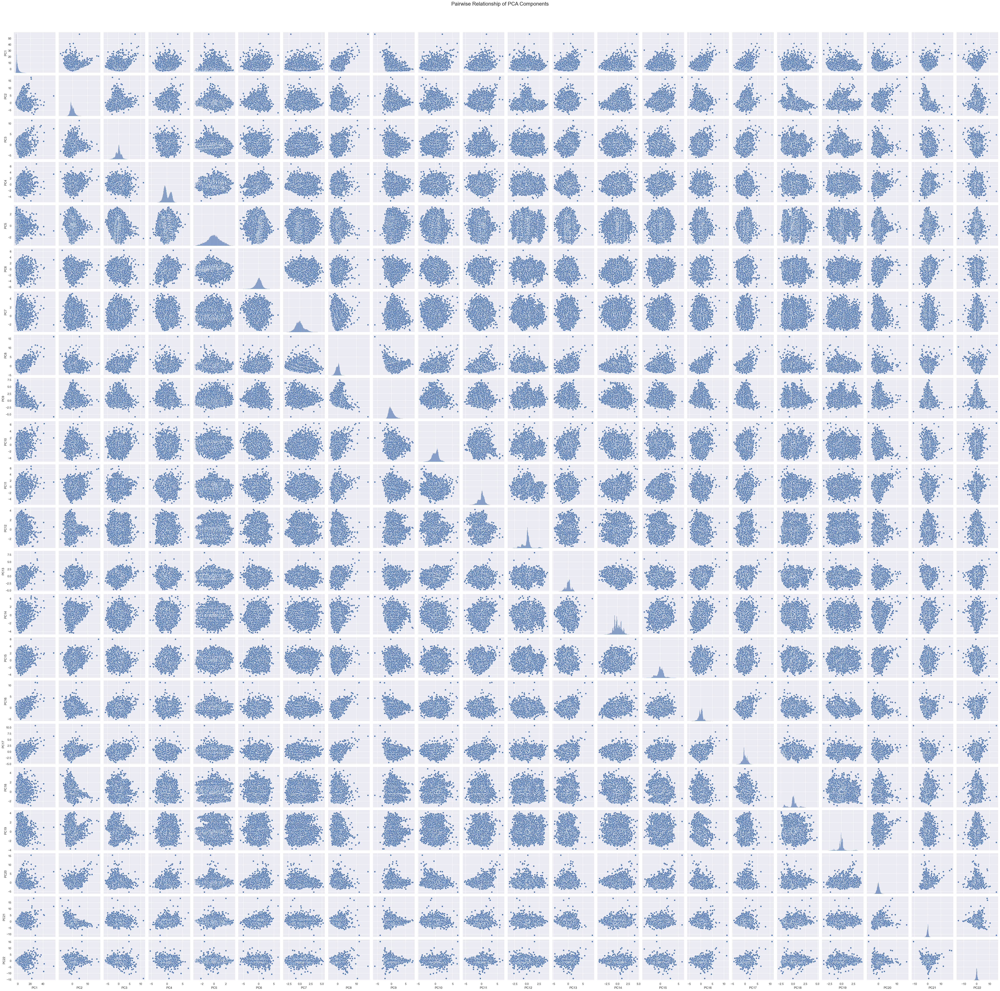

In [221]:
# Assuming num_features_pca is your transformed PCA data and pca is the fitted PCA object
# Convert PCA-transformed data into a DataFrame
columns_pca = [f"PC{i+1}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(num_features_pca_transform, columns=columns_pca)

# Plotting pair plot for PCA components
sns.set()
sns.pairplot(pca_df, diag_kind="hist")

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of PCA Components", fontsize=20)

# Save the plot
if not os.path.exists(os.path.join('..', 'Project', 'figures')):
    os.makedirs(os.path.join('..', 'Project', 'figures'))

plt.savefig(os.path.join('..', 'Project', 'figures', 'pca_components_pairplot.png'), dpi=200)
plt.show()
